# Segmentación de Clientes utilizando distintos modelos de Clustering

El propósito de este proyecto es realizar una segmentación de clientes a partir de distintos datos como el gasto en frutas, el gasto en vinos, número de compras a través de internet, nivel educativo, ingresos, entre otros. A través de distintos modelos de clustering como K-Means, Hierarchical Clustering y DBSCAN se espera lograr una correcta segmentación de los clientes para luego realizar un análisis detallado de cada grupo y de esta manera construir políticas y productos especializados para cada segmento de clientes.

![](customerSegmentation.jpg)

[*Datos*.](https://www.kaggle.com/datasets/imakash3011/customer-personality-analysis)

## Librerías

**Instalación de las librerías necesarias**

In [1]:
#%pip install numpy pandas matplotlib seaborn sklearn scipy threadpoolctl pyjanitor
#%conda update threadpoolctl

**Importar las librerías**

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN
from sklearn.metrics import silhouette_score
from scipy.cluster.hierarchy import dendrogram, linkage
from itertools import product
import janitor

## Establecer una apariencia general para los gráficos

In [3]:
%matplotlib inline
# Cuadrícula blanca; contexto de un notebook
sns.set(style = "whitegrid", context = "notebook")
# Tamaño de los gráficos
plt.rcParams["figure.figsize"] = (12, 10)

## Carga de los datos

In [4]:
df = pd.read_csv("marketing_campaign.csv", sep = "\t")
df.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,...,5,0,0,0,0,0,0,3,11,0


## Validación de los datos

In [5]:
df.shape

(2240, 29)

Tenemos 2240 observaciones para un total dd 209 variables.

In [6]:
print(df.dtypes, df.dtypes.value_counts(), sep = "\n\n")

ID                       int64
Year_Birth               int64
Education               object
Marital_Status          object
Income                 float64
Kidhome                  int64
Teenhome                 int64
Dt_Customer             object
Recency                  int64
MntWines                 int64
MntFruits                int64
MntMeatProducts          int64
MntFishProducts          int64
MntSweetProducts         int64
MntGoldProds             int64
NumDealsPurchases        int64
NumWebPurchases          int64
NumCatalogPurchases      int64
NumStorePurchases        int64
NumWebVisitsMonth        int64
AcceptedCmp3             int64
AcceptedCmp4             int64
AcceptedCmp5             int64
AcceptedCmp1             int64
AcceptedCmp2             int64
Complain                 int64
Z_CostContact            int64
Z_Revenue                int64
Response                 int64
dtype: object

int64      25
object      3
float64     1
dtype: int64


Tenemos 3 variables cualitativas que son el nivel educativo, estado civil y fecha en que el cliente se unió a la empresa; esta última debemos modificarla para ser de otro tipo. Las otras 26 variables son numéricas.

In [7]:
df.isnull().sum()

ID                      0
Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
AcceptedCmp3            0
AcceptedCmp4            0
AcceptedCmp5            0
AcceptedCmp1            0
AcceptedCmp2            0
Complain                0
Z_CostContact           0
Z_Revenue               0
Response                0
dtype: int64

Observamos que para los ingresos anuales tenemos 24 datos faltantes; más adelante trabajaremos con ellos.

In [8]:
df[df.duplicated()]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response


Finalmente, observamos que no hay valores duplicados.

## Manipulación y limpieza de los datos

Visualizamos las observaciones que tienen los valores faltantes

In [9]:
df[df.Income.isnull()]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
10,1994,1983,Graduation,Married,NaN,1,0,15-11-2013,11,5,...,7,0,0,0,0,0,0,3,11,0
27,5255,1986,Graduation,Single,NaN,1,0,20-02-2013,19,5,...,1,0,0,0,0,0,0,3,11,0
43,7281,1959,PhD,Single,NaN,0,0,05-11-2013,80,81,...,2,0,0,0,0,0,0,3,11,0
48,7244,1951,Graduation,Single,NaN,2,1,01-01-2014,96,48,...,6,0,0,0,0,0,0,3,11,0
58,8557,1982,Graduation,Single,NaN,1,0,17-06-2013,57,11,...,6,0,0,0,0,0,0,3,11,0
71,10629,1973,2n Cycle,Married,NaN,1,0,14-09-2012,25,25,...,8,0,0,0,0,0,0,3,11,0
90,8996,1957,PhD,Married,NaN,2,1,19-11-2012,4,230,...,9,0,0,0,0,0,0,3,11,0
91,9235,1957,Graduation,Single,NaN,1,1,27-05-2014,45,7,...,7,0,0,0,0,0,0,3,11,0
92,5798,1973,Master,Together,NaN,0,0,23-11-2013,87,445,...,1,0,0,0,0,0,0,3,11,0
128,8268,1961,PhD,Married,NaN,0,1,11-07-2013,23,352,...,6,0,0,0,0,0,0,3,11,0


Vamos a utilizar una función personalizada basada en Pandas para una mejor visualización de los valores faltantes.

In [10]:
%run pandas-missing-extension.ipynb

Note: you may need to restart the kernel to use updated packages.


d:\anaconda3\envs\customerSegmentation\lib\site-packages\upsetplot\plotting.py:20: MatplotlibDeprecationWarning: The matplotlib.tight_layout module was deprecated in Matplotlib 3.6 and will be removed two minor releases later.
  from matplotlib.tight_layout import get_renderer


Resumen tabular

In [11]:
df.missing.missing_variable_summary()

,variable,n_missing,n_cases,pct_missing
0,ID,0,2240,0.000000
1,Year_Birth,0,2240,0.000000
2,Education,0,2240,0.000000
3,Marital_Status,0,2240,0.000000
4,Income,24,2240,1.071429
5,Kidhome,0,2240,0.000000
6,Teenhome,0,2240,0.000000
7,Dt_Customer,0,2240,0.000000
8,Recency,0,2240,0.000000
9,MntWines,0,2240,0.000000


Visualización de los valores faltantes

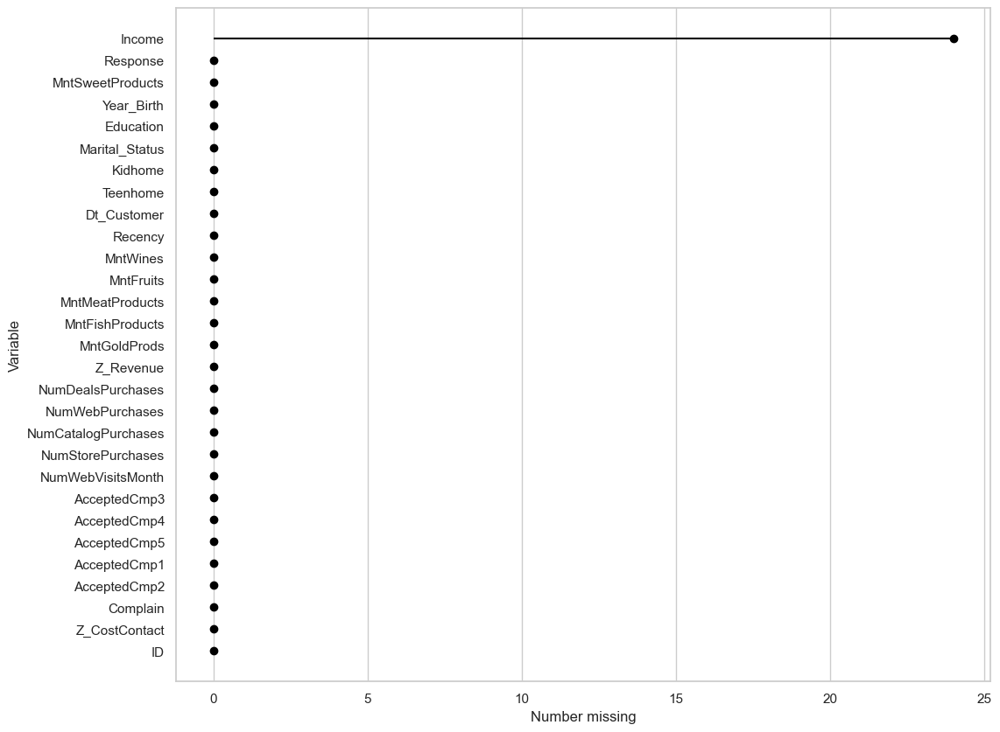

In [12]:
df.missing.missing_variable_plot()

Como habíamos visto, la única variable que contiene valores faltantes es la de los ingresos anuales y son 24 valores lo cual representa el 1.07% del total del conjunto de datos así que para este caso se optará por simplemente eliminar las observaciones con estos valores faltantes.

In [13]:
# Utilizamos la función dropna para "soltar" los valores faltantes del conjunto de datos
df.dropna(
    # Lista de variables donde buscar los valores faltantes
    subset = ["Income"],
    # Eliminar cualquier observación que contenga al menos 1 valor faltante
    how = "any",
    # Eliminar en el mismo dataset
    inplace = True
)

In [14]:
print(df.shape, df.isnull().sum(), sep = "\n\n")

(2216, 29)

ID                     0
Year_Birth             0
Education              0
Marital_Status         0
Income                 0
Kidhome                0
Teenhome               0
Dt_Customer            0
Recency                0
MntWines               0
MntFruits              0
MntMeatProducts        0
MntFishProducts        0
MntSweetProducts       0
MntGoldProds           0
NumDealsPurchases      0
NumWebPurchases        0
NumCatalogPurchases    0
NumStorePurchases      0
NumWebVisitsMonth      0
AcceptedCmp3           0
AcceptedCmp4           0
AcceptedCmp5           0
AcceptedCmp1           0
AcceptedCmp2           0
Complain               0
Z_CostContact          0
Z_Revenue              0
Response               0
dtype: int64


Observamos que efectivamente se eliminaron las 24 observaciones con datos faltantes del conjunto de datos por lo que ya no contamos con valores nulos.

Ahora convertiremos la variable *Dt_Customer* para que sea una fecha como realmente lo es.

In [15]:
df["Dt_Customer"] = pd.to_datetime(df["Dt_Customer"], dayfirst = True, infer_datetime_format = True)
df.dtypes

ID                              int64
Year_Birth                      int64
Education                      object
Marital_Status                 object
Income                        float64
Kidhome                         int64
Teenhome                        int64
Dt_Customer            datetime64[ns]
Recency                         int64
MntWines                        int64
MntFruits                       int64
MntMeatProducts                 int64
MntFishProducts                 int64
MntSweetProducts                int64
MntGoldProds                    int64
NumDealsPurchases               int64
NumWebPurchases                 int64
NumCatalogPurchases             int64
NumStorePurchases               int64
NumWebVisitsMonth               int64
AcceptedCmp3                    int64
AcceptedCmp4                    int64
AcceptedCmp5                    int64
AcceptedCmp1                    int64
AcceptedCmp2                    int64
Complain                        int64
Z_CostContac

Vemos que *Dt_Customer* ya es una variable de tipo fecha.

## Análisis de los datos

### Variables categóricas

Observemos cómo están distribuidas nuestras variables categóricas.

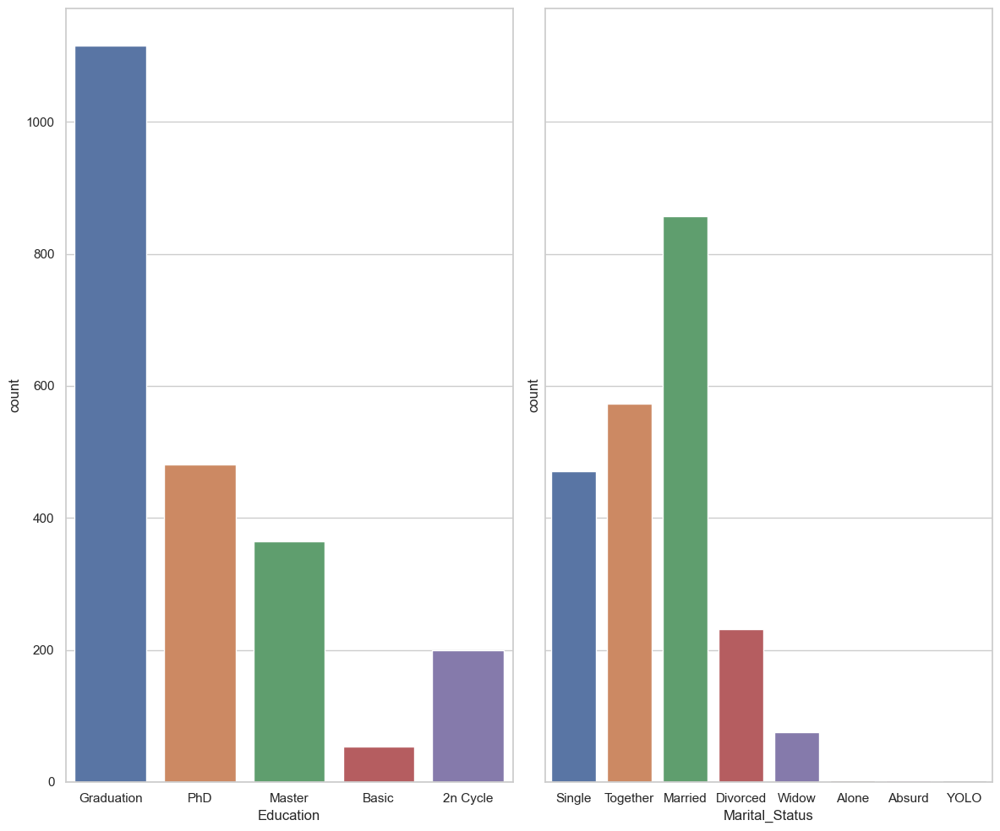

In [16]:
fig, axes = plt.subplots(1, 2, sharey = True)
sns.countplot(
    data = df,
    x = "Education", 
    ax = axes[0]
)
sns.countplot(
    data = df,
    x = "Marital_Status",
    ax = axes[1]
)
fig.tight_layout()


Observamos que para el nivel educativo la mayoría de personas están graduadas y observamos que hay más personas con un PhD que con una maestría. Por otro lado, vemos que en el estado civil es más común estar casado. Ahora visualizaremos mejor estas proporciones.

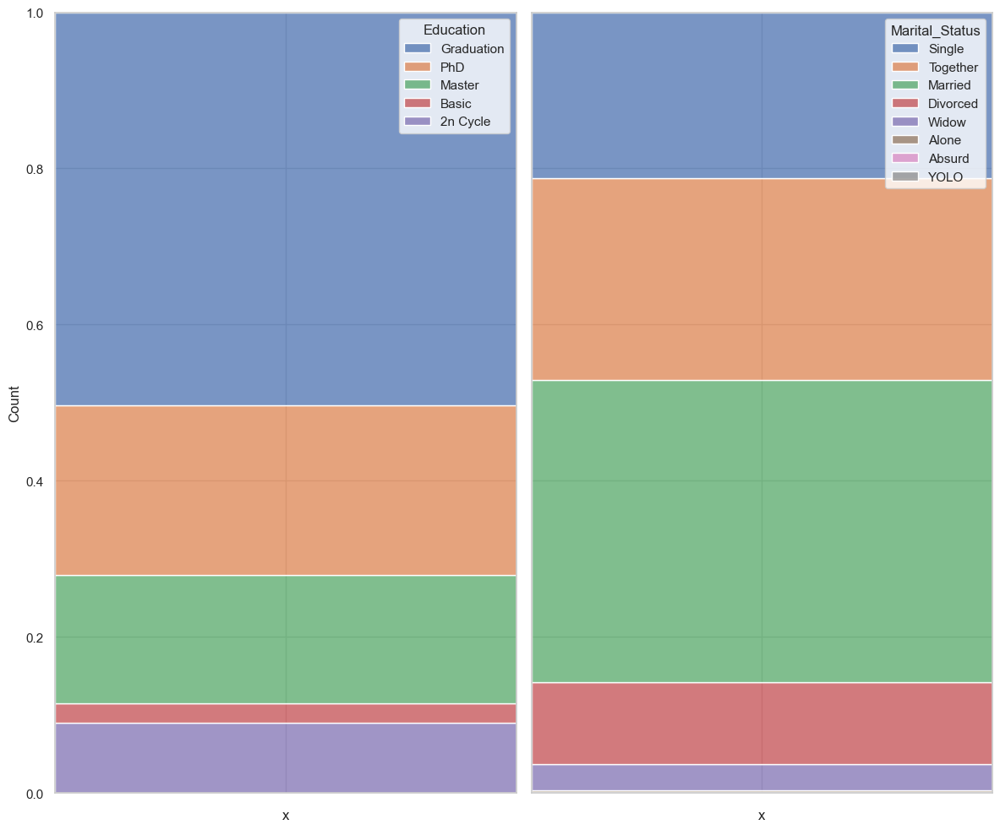

In [17]:
fig, axes = plt.subplots(1, 2, sharey = True)

# Tenemos que añadir una nueva columna vacía X para que Seaborn pueda entendernos
df.add_column("x", "").pipe(lambda df: sns.histplot(
    data = df, # El conjunto de datos
    x = "x", # La columna vacía que creamos
    hue = "Education", # Agrupamos por sexo
    multiple = "fill", # Muestre el gráfico en proporción,
    ax = axes[0]
))

df.add_column("x", "").pipe(lambda df: sns.histplot(
    data = df, # El conjunto de datos
    x = "x", # La columna vacía que creamos
    hue = "Marital_Status", # Agrupamos por sexo
    multiple = "fill", # Muestre el gráfico en proporción,
    ax = axes[1]
))

fig.tight_layout()

Observamos que hay para el estado civil los niveles de *Alone, Absurd* y *YOLO* tienen una proporción muy baja respecto a los otros niveles por lo que vamos a explorarlos un poco más.

In [18]:
df[(df["Marital_Status"] == "Absurd") | (df["Marital_Status"] == "YOLO") | (df["Marital_Status"] == "Alone")]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
131,433,1958,Master,Alone,61331.0,1,1,2013-03-10,42,534,...,8,0,0,0,0,0,0,3,11,0
138,7660,1973,PhD,Alone,35860.0,1,1,2014-05-19,37,15,...,5,1,0,0,0,0,0,3,11,1
153,92,1988,Graduation,Alone,34176.0,1,0,2014-05-12,12,5,...,6,0,0,0,0,0,0,3,11,0
2093,7734,1993,Graduation,Absurd,79244.0,0,0,2012-12-19,58,471,...,1,0,0,1,1,0,0,3,11,1
2134,4369,1957,Master,Absurd,65487.0,0,0,2014-01-10,48,240,...,2,0,0,0,0,0,0,3,11,0
2177,492,1973,PhD,YOLO,48432.0,0,1,2012-10-18,3,322,...,8,0,0,0,0,0,0,3,11,0
2202,11133,1973,PhD,YOLO,48432.0,0,1,2012-10-18,3,322,...,8,0,0,0,0,0,0,3,11,1


Observamos que para *Alone* solo hay 3 registros, para *Absurd* solo 2 y para *YOLO* solo 3; lo que haremos será eliminar los registros que en estado civil tengan *Absurd* o *YOLO* y los que tengan *Alone* los convertiremos a *Single*.

In [19]:
# Convertimos Alone a Single
df["Marital_Status"].replace({
    "Alone" : "Single"
}, inplace = True)

In [20]:
df[df["Marital_Status"] == "Alone"]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response


Como vemos, ya no quedan registros con el estado civil de *Alone*.

In [21]:
# Obtenemos los índices de los registros con estado civil Absurd o YOLO
index = df[(df["Marital_Status"] == "Absurd") | (df["Marital_Status"] == "YOLO")].index
# Eliminamos los registros
df.drop(index, inplace = True)

Ahora visualizamos los niveles de la categoría del estado civil.

In [22]:
np.unique(df.Marital_Status)

array(['Divorced', 'Married', 'Single', 'Together', 'Widow'], dtype=object)

Ahora todo parece correcto.

### Variables numéricas

Ahora exploraremos un poco las variables numéricas enfocándonos en las que hacen referencia a las compras que realizan los clientes de ciertos productos, en dónde realizan dichas compras y en sus ingresos anuales.

In [23]:
# Creamos una lista con las variables numéricas de interés
numVars = ["Income", "MntWines", "MntFruits", "MntMeatProducts", "MntFishProducts", "MntSweetProducts", "MntGoldProds", "NumWebPurchases", "NumCatalogPurchases", "NumStorePurchases"]

In [24]:
# Resumen estadístico de las variables numéricas de interés
df[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases
count,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000
mean,52232.510850,305.030741,26.324593,166.970163,37.516275,27.047468,43.822333,4.083183,2.668174,5.800181
std,25187.455359,337.611255,39.781794,224.344950,54.558673,41.092454,51.623472,2.741930,2.924378,3.253616
min,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,35233.500000,23.750000,1.750000,16.000000,3.000000,1.000000,9.000000,2.000000,0.000000,3.000000
50%,51381.500000,173.500000,8.000000,68.000000,12.000000,8.000000,24.000000,4.000000,2.000000,5.000000
75%,68522.000000,505.500000,33.000000,232.250000,50.000000,33.000000,56.000000,6.000000,4.000000,8.000000
max,666666.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,321.000000,27.000000,28.000000,13.000000


Podemos observar cosas interesantes como que el 50% de los clientes tienen ingresos menores o iguales $51381.5 al año, lo que significa un desembolso mensual de aproximadamente $4281.8 que es caso 4 veces el salario mínimo en EEUU; por otro lado, el producto en el que los clientes gastan más dinero es en vino con un promedio de $305 seguido de productos cárnicos con un promedio de $166.9 y el producto en el que menos gastan son las frutas con un promedio de $26.3; finalmente, vemos que en promedio los clientes realizan más compras en las tiendas que en el sitio web.

Ahora miremos cómo se distribuyen estas variables numéricas.

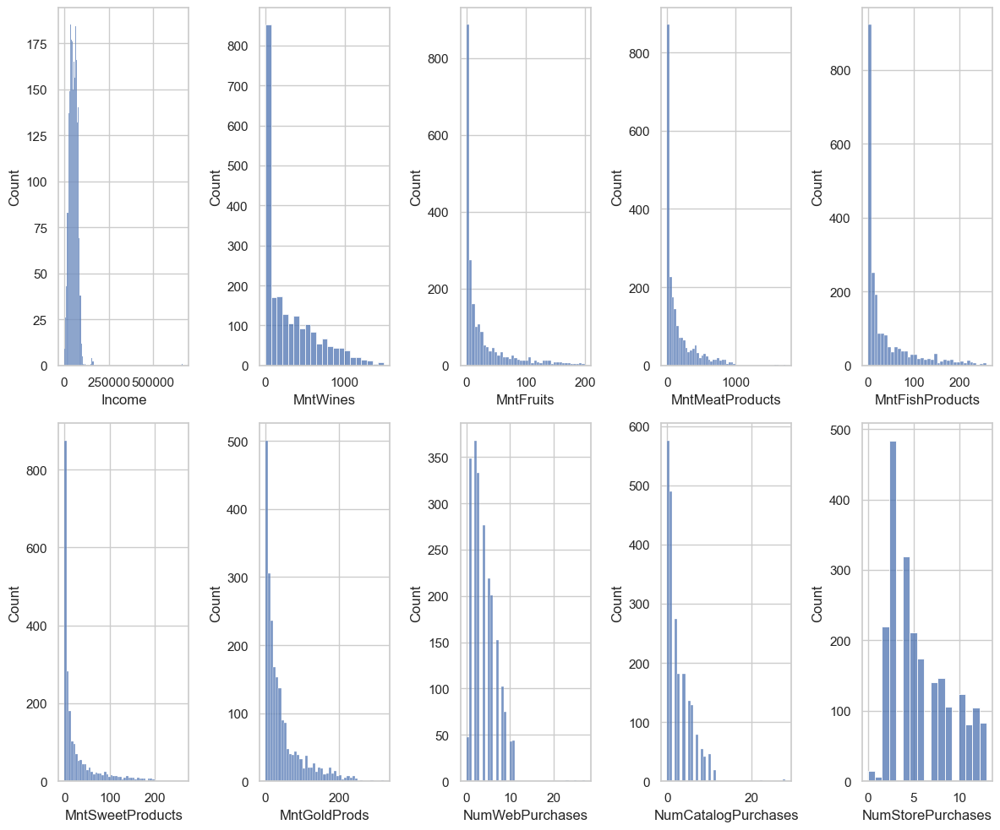

In [25]:
# Para iterar sobre la variable numérica
k = 0
# Figura con 2 filas y 5 columnas
fig, axes = plt.subplots(2, 5)
# Iteramos las filas
for i in range(2):
    # Iteramos las columnas
    for j in range(5):
        # Creamos el histograma de la variable
        sns.histplot(
            data = df,
            x = numVars[k],
            ax = axes[i, j]
        )
        k += 1
fig.tight_layout()

Vemos que la mayoría de las variables siguen una distribución normal con sesgos positivos.

Ahora buscaremos outliers.

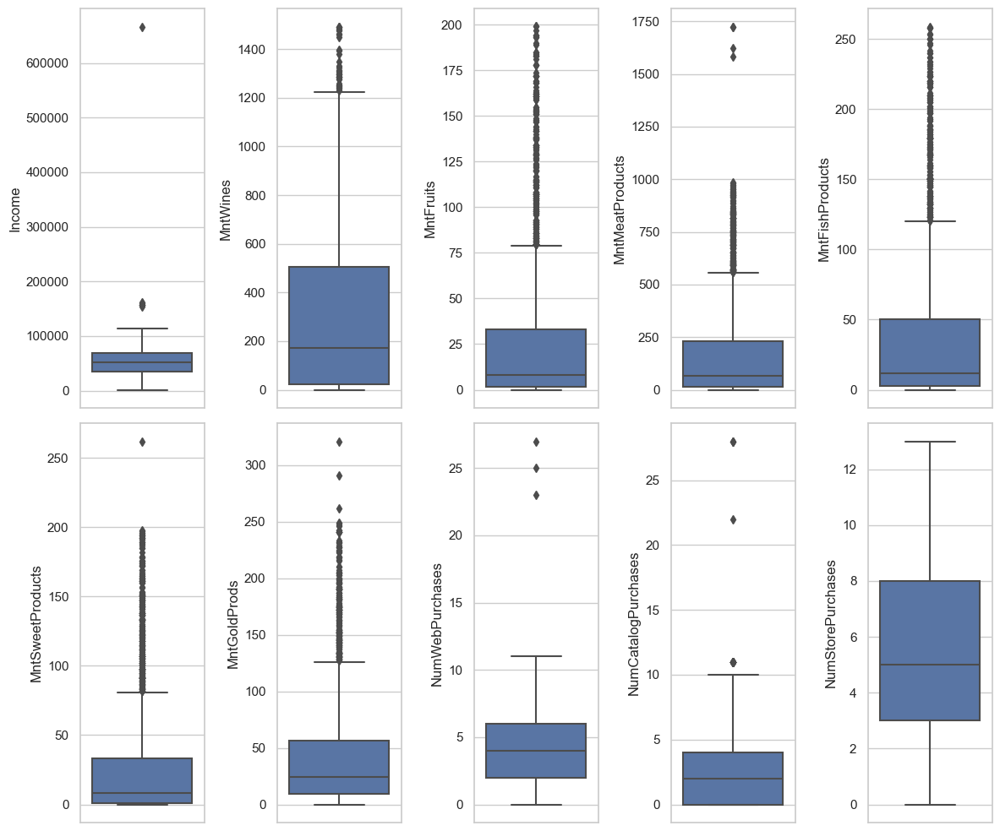

In [26]:
# Para iterar sobre la variable numérica
k = 0
# Figura con 2 filas y 5 columnas
fig, axes = plt.subplots(2, 5)
# Iteramos las filas
for i in range(2):
    # Iteramos las columnas
    for j in range(5):
        # Creamos el boxplot de la variable
        sns.boxplot(
            data = df,
            y = numVars[k],
            ax = axes[i, j]
        )
        k += 1
fig.tight_layout()

Todas las variables que hacen referencia a los productos tienen un gran número de outliers o datos atípicos por lo que será importante realizar una estandarización de los datos.

Proseguiremos analizando las variables numéricas pero segmentándolas por nuestras variables categóricas: nivel educativo y estado civil. 

Comencemos con el nivel educativo.

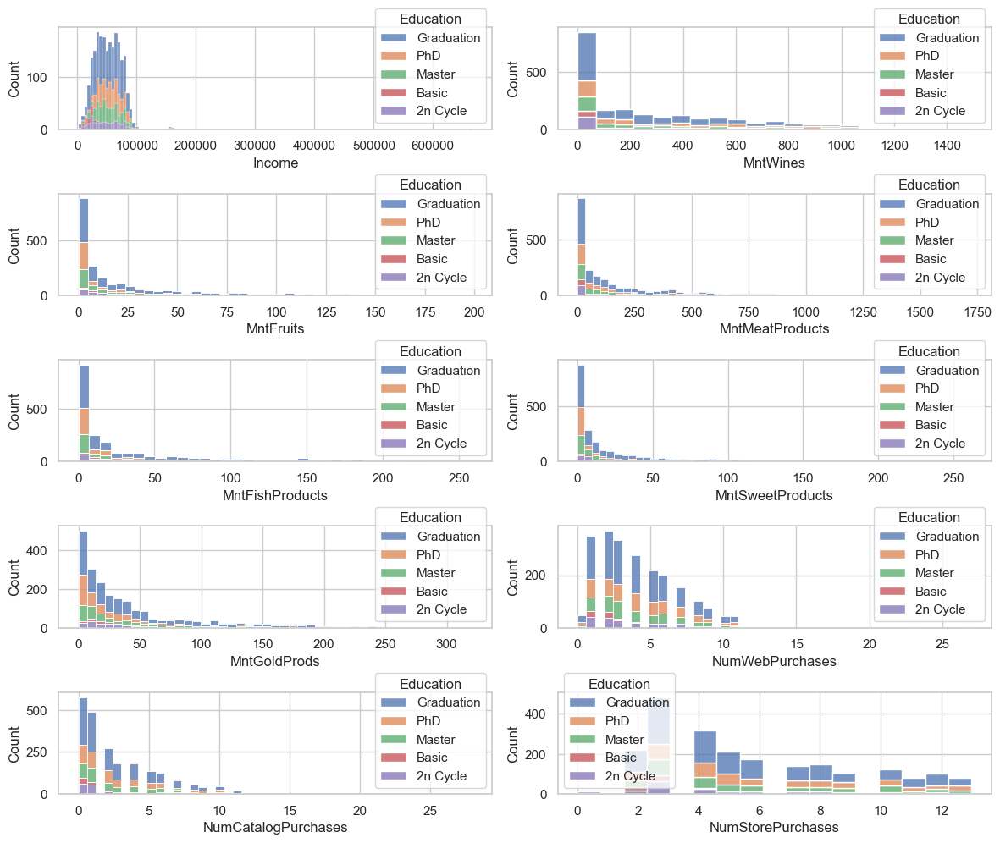

In [27]:
# Para iterar sobre la variable numérica
k = 0
# Figura con 5 filas y 2 columnas
fig, axes = plt.subplots(5, 2)
# Iteramos las filas
for i in range(5):
    # Iteramos las columnas
    for j in range(2):
        # Creamos el histograma de la variable
        sns.histplot(
            data = df,
            x = numVars[k],
            hue = "Education",
            multiple = "stack",
            ax = axes[i, j],
        )
        k += 1
fig.tight_layout()

A simple vista no podemos encontrar muchas diferencias en la distribución de las variables a partir del nivel educativo del cliente.

Ahora miremos con el estado civil.

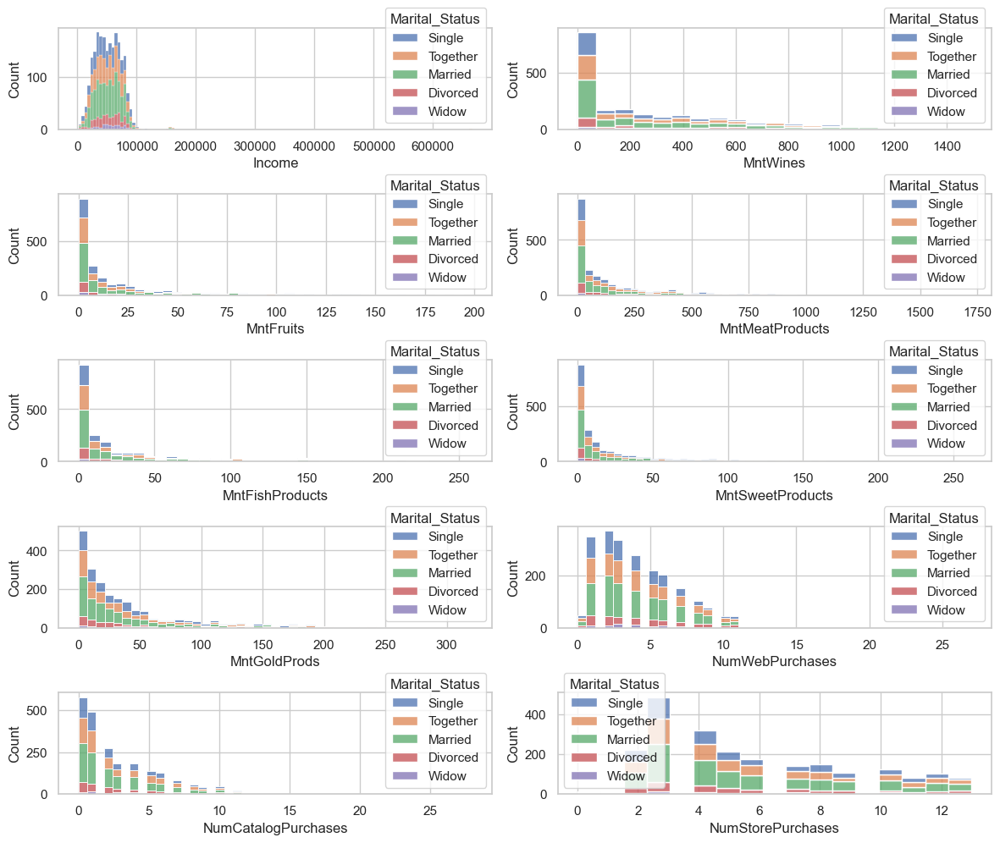

In [28]:
# Para iterar sobre la variable numérica
k = 0
# Figura con 5 filas y 2 columnas
fig, axes = plt.subplots(5, 2)
# Iteramos las filas
for i in range(5):
    # Iteramos las columnas
    for j in range(2):
        # Creamos el histograma de la variable
        sns.histplot(
            data = df,
            x = numVars[k],
            hue = "Marital_Status",
            multiple = "stack",
            ax = axes[i, j]
        )
        k += 1
fig.tight_layout()

De nuevo, a simple vista no parecen haber muchas diferencias en la distribución de las variables a partir del estado civil del cliente.

### Correlaciones

Finalmente, buscaremos la correlación que pueda existir entre nuestras variables numéricas de interés.

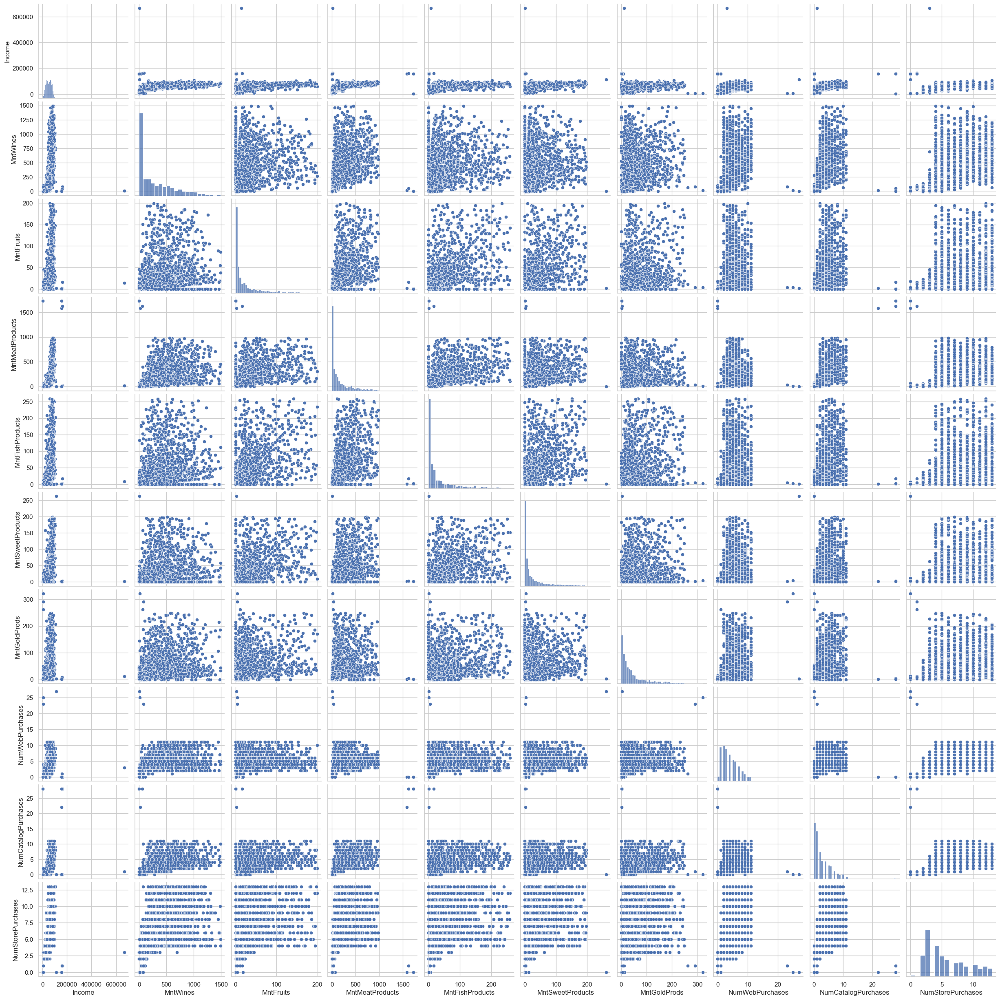

In [29]:
sns.pairplot(
    data = df[numVars]
)
plt.show()

A simple vista no vemos mucha correlación entre las variables excepto entre los ingresos anuales y el gasto en los distintos productos que sí parecen tener una leve correlación positiva.

Segmentemos las variables por nivel educativo para ver si existe alguna diferencia.

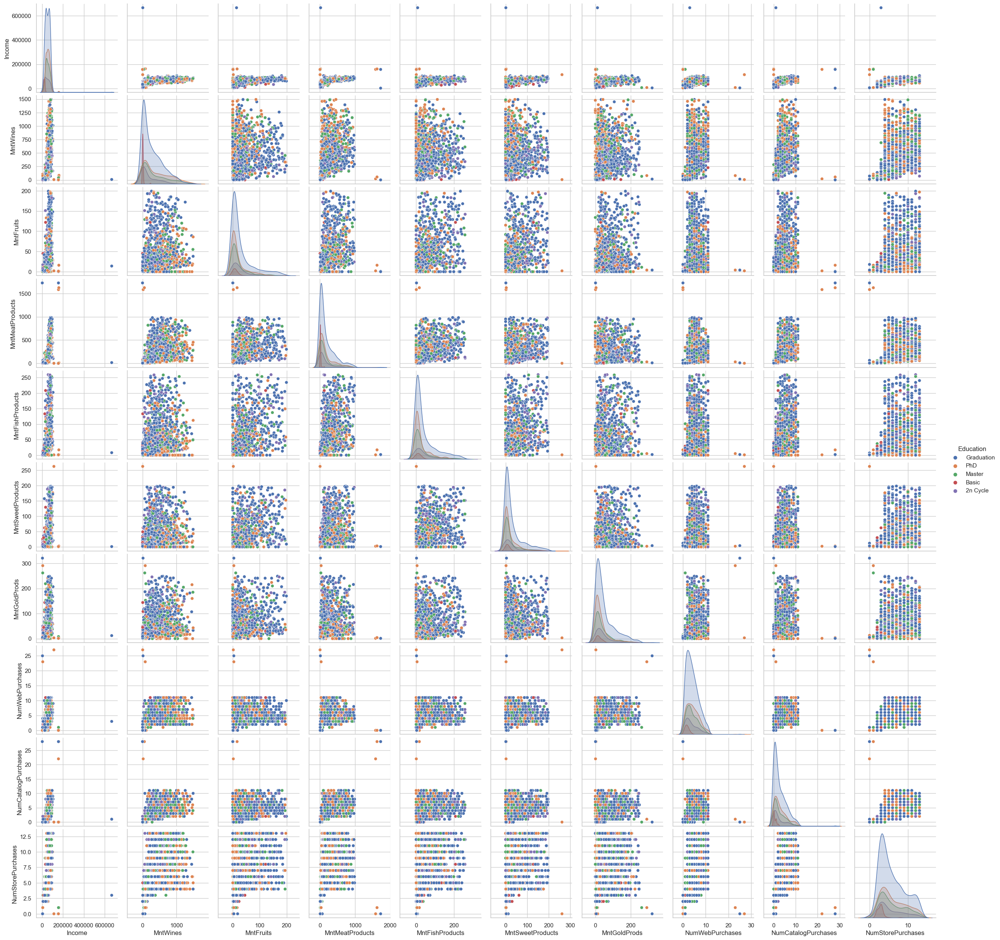

In [30]:
sns.pairplot(
    data = df[numVars + ["Education"]],
    hue = "Education"
)
plt.show()

Nuevamente, no parece haber mucha diferencia entre las distintas categorías a ya observado.

A continuación realizaremos un mapa de calor para ver la correlación entre las variables de interés.

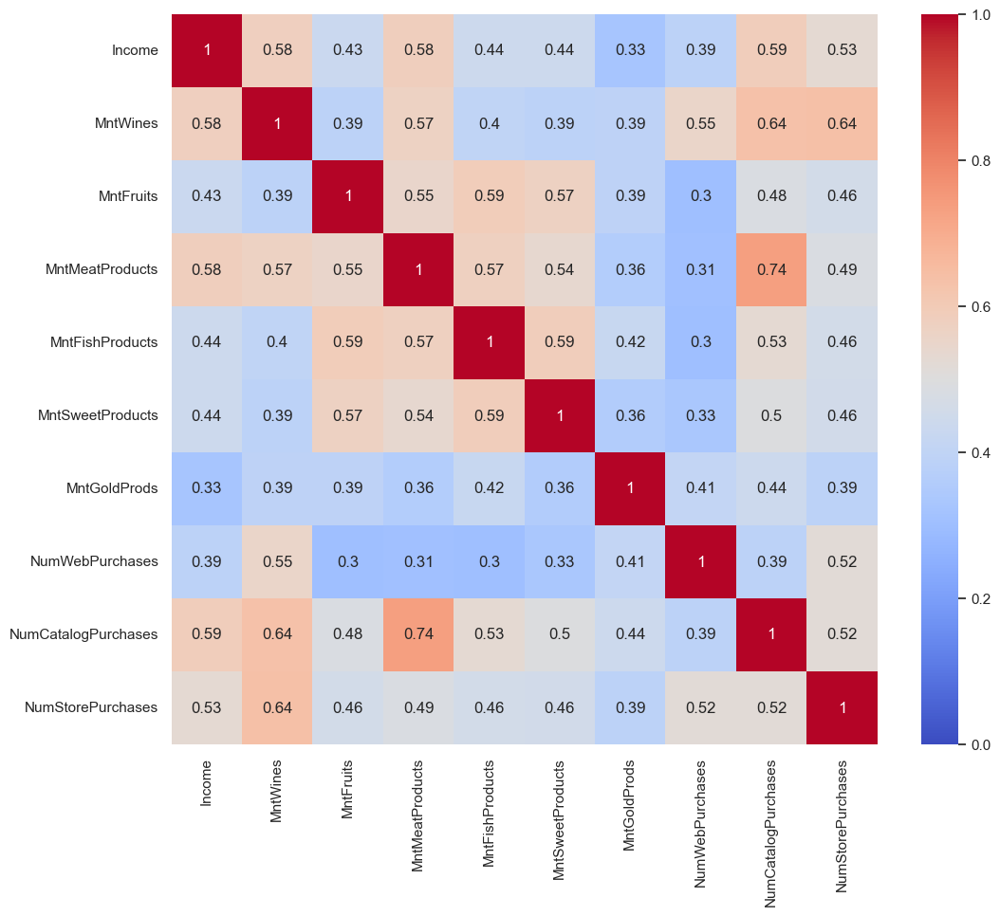

In [31]:
sns.heatmap(
    data = df[numVars].corr(),
    annot = True,
    cmap = "coolwarm",
    vmin = 0,
    vmax = 1
)
plt.show()

Observamos que hay una buena correlación positiva entre el gasto en productos cárnicos y el número de compras a través de catálogos; también hay ligeras correlaciones positivas entre el gasto en vinos y el número de compra por catálogos y en tiendas; entre los ingresos anuales y el gasto en vinos, productos cárnicos, compras a través de catálogos y tiendas también existe una ligera correlación positiva; por último, hay una correlación positiva entre el gasto en productos de pescado y el gasto en frutas.

## Codificación de variables categóricas

Ahora convertiremos las variables categóricas de nivel educativo y estado civil a numéricas utilizando un One Hot Encoder con el propósito de que sea más fácil para el algoritmo trabajar con ellas.

In [32]:
np.unique(df.Education)

array(['2n Cycle', 'Basic', 'Graduation', 'Master', 'PhD'], dtype=object)

Vemos que para la variable del nivel educativo tenemos 5 niveles.

In [33]:
np.unique(df.Marital_Status)

array(['Divorced', 'Married', 'Single', 'Together', 'Widow'], dtype=object)

Y para la variable del estado civil tenemos 5 niveles.

Ahora utilizaremos el One Hot Encoder para convertir estas variables a numéricas.

In [34]:
# Primero creamos una copia del df
dfCopy = df.copy(deep = True)
# Hacemos la codificación
dfCopy = pd.get_dummies(dfCopy)
dfCopy

,ID,Year_Birth,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,...,Education_2n Cycle,Education_Basic,Education_Graduation,Education_Master,Education_PhD,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow
0,5524,1957,58138.0,0,0,2012-09-04,58,635,88,546,...,0,0,1,0,0,0,0,1,0,0
1,2174,1954,46344.0,1,1,2014-03-08,38,11,1,6,...,0,0,1,0,0,0,0,1,0,0
2,4141,1965,71613.0,0,0,2013-08-21,26,426,49,127,...,0,0,1,0,0,0,0,0,1,0
3,6182,1984,26646.0,1,0,2014-02-10,26,11,4,20,...,0,0,1,0,0,0,0,0,1,0
4,5324,1981,58293.0,1,0,2014-01-19,94,173,43,118,...,0,0,0,0,1,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,1967,61223.0,0,1,2013-06-13,46,709,43,182,...,0,0,1,0,0,0,1,0,0,0
2236,4001,1946,64014.0,2,1,2014-06-10,56,406,0,30,...,0,0,0,0,1,0,0,0,1,0
2237,7270,1981,56981.0,0,0,2014-01-25,91,908,48,217,...,0,0,1,0,0,1,0,0,0,0
2238,8235,1956,69245.0,0,1,2014-01-24,8,428,30,214,...,0,0,0,1,0,0,0,0,1,0


Finalmente, creamos una copia del conjunto de datos procesado para comenzar a trabajar con ella.

In [35]:
dfProcessed = dfCopy.copy(deep = True)
dfProcessed

,ID,Year_Birth,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,...,Education_2n Cycle,Education_Basic,Education_Graduation,Education_Master,Education_PhD,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow
0,5524,1957,58138.0,0,0,2012-09-04,58,635,88,546,...,0,0,1,0,0,0,0,1,0,0
1,2174,1954,46344.0,1,1,2014-03-08,38,11,1,6,...,0,0,1,0,0,0,0,1,0,0
2,4141,1965,71613.0,0,0,2013-08-21,26,426,49,127,...,0,0,1,0,0,0,0,0,1,0
3,6182,1984,26646.0,1,0,2014-02-10,26,11,4,20,...,0,0,1,0,0,0,0,0,1,0
4,5324,1981,58293.0,1,0,2014-01-19,94,173,43,118,...,0,0,0,0,1,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,1967,61223.0,0,1,2013-06-13,46,709,43,182,...,0,0,1,0,0,0,1,0,0,0
2236,4001,1946,64014.0,2,1,2014-06-10,56,406,0,30,...,0,0,0,0,1,0,0,0,1,0
2237,7270,1981,56981.0,0,0,2014-01-25,91,908,48,217,...,0,0,1,0,0,1,0,0,0,0
2238,8235,1956,69245.0,0,1,2014-01-24,8,428,30,214,...,0,0,0,1,0,0,0,0,1,0


## Escalar los datos

Procedemos a escalar los datos ya que como vimos para algunas variables hay datos que tienen una gran distancia entre sí lo que podría repercutir en el modelo.

In [36]:
# Creamos el escalador
scaler = MinMaxScaler()
# Las columnas del dataset que escalaremos
cols = dfProcessed.columns.drop(["ID", "Dt_Customer"])
# Escalamos los datos excepto la columna del ID ya que no nos aporta información; el resultado lo convertimos en un df
dfScaled = pd.DataFrame(scaler.fit_transform(dfProcessed.drop(["ID", "Dt_Customer"], axis = 1)), columns = cols)
dfScaled

,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,...,Education_2n Cycle,Education_Basic,Education_Graduation,Education_Master,Education_PhD,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow
0,0.621359,0.084832,0.0,0.0,0.585859,0.425318,0.442211,0.316522,0.664093,0.335878,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0.592233,0.067095,0.5,0.5,0.383838,0.007368,0.005025,0.003478,0.007722,0.003817,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.699029,0.105097,0.0,0.0,0.262626,0.285332,0.246231,0.073623,0.428571,0.080153,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.883495,0.037471,0.5,0.0,0.262626,0.007368,0.020101,0.011594,0.038610,0.011450,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.854369,0.085065,0.5,0.0,0.949495,0.115874,0.216080,0.068406,0.177606,0.103053,...,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2207,0.718447,0.089472,0.0,0.5,0.464646,0.474883,0.216080,0.105507,0.162162,0.450382,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
2208,0.514563,0.093669,1.0,0.5,0.565657,0.271936,0.000000,0.017391,0.000000,0.000000,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
2209,0.854369,0.083092,0.0,0.0,0.919192,0.608171,0.241206,0.125797,0.123552,0.045802,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
2210,0.611650,0.101536,0.0,0.5,0.080808,0.286671,0.150754,0.124058,0.308880,0.114504,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0


## Aplicar PCA

Utilizaremos el análisis de componentes principales para reducir la dimensionalidad del conjunto de datos y de esta manera ayudar a que el clustering funcione mejor.

In [37]:
# Creamos el modelo para PCA
pca = PCA()
# Entrenamos el modelo y transformamos los datos
scaledPCA = pca.fit_transform(dfScaled)

Ahora veremos la varianza capturada por los componentes.

In [38]:
var = pca.explained_variance_ratio_
var

array([1.46284010e-01, 1.38243765e-01, 1.07318914e-01, 9.86368419e-02,
       7.85250543e-02, 5.84342948e-02, 5.35974346e-02, 4.76537397e-02,
       3.67346781e-02, 3.45457515e-02, 3.06998387e-02, 2.29093812e-02,
       1.88210735e-02, 1.77554505e-02, 1.64784471e-02, 1.59648654e-02,
       1.19341672e-02, 1.14803445e-02, 8.03872472e-03, 7.03808220e-03,
       6.26220208e-03, 5.20888651e-03, 4.92696793e-03, 4.81313004e-03,
       4.26249021e-03, 4.17360209e-03, 3.79683908e-03, 2.10625098e-03,
       1.88288928e-03, 1.20553022e-03, 2.66352300e-04, 2.88494340e-32,
       3.25011099e-33, 7.14663716e-34, 7.14663716e-34])

Crearemos una gráfica para una mejor visualización.

[]

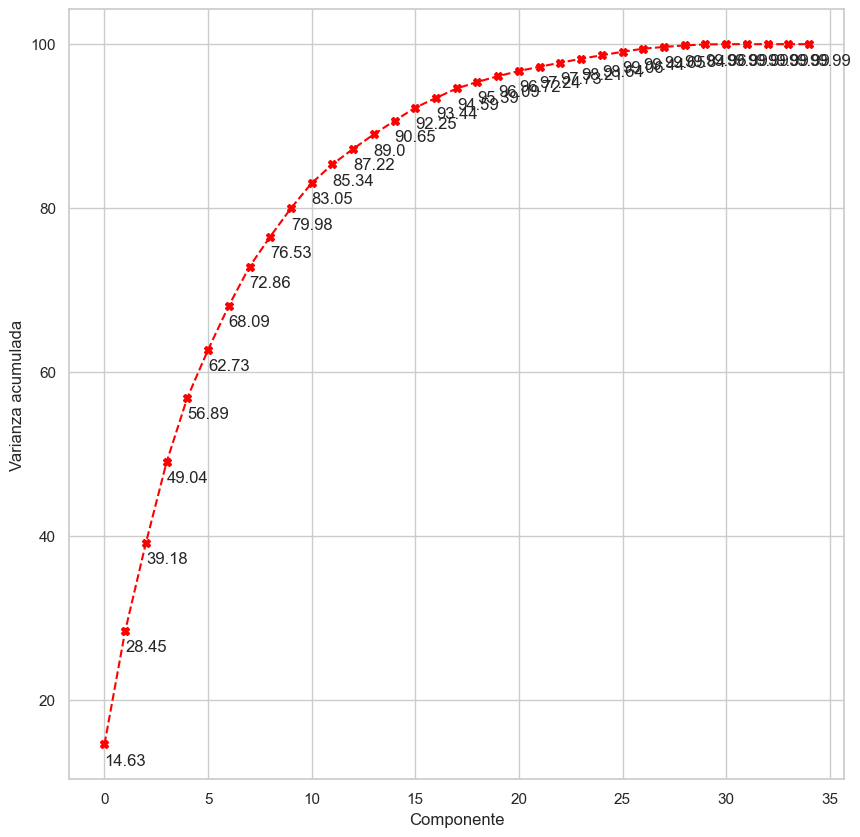

In [39]:
# Varianza acumulada
accVar = np.cumsum(np.round(var, decimals = 4) * 100)
# Lista para guardar el número del componente
components = np.arange(0, 35)

plt.figure(figsize = (10, 10))
# Iteramos a través de los componentes y su respectiva varianza acumulada
for component, aV in zip(components, accVar):
    plt.annotate(round(aV, 2), xy = (component, aV - 2.5))
    
plt.plot(accVar, color = "red", marker = "X", linestyle = "--")
plt.xlabel("Componente")
plt.ylabel("Varianza acumulada")
plt.plot()

Vemos que utilizando 16 componentes capturamos el 92.25% de la varianza así que trabajaremos con ellos.

In [40]:
# Creamos un df con los datos escalados y con el PCA aplicado
dfScaledPCA = pd.DataFrame(scaledPCA)
# Eliminamos los componentes 16 en adelante
dfScaledPCA.drop(np.arange(16, 35), axis = 1, inplace = True)
dfScaledPCA

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,-0.669865,0.391237,1.041156,-0.433274,0.071981,0.163595,-0.219472,0.055761,-0.148615,-0.212806,0.193018,-0.602587,-0.098468,-0.069032,-0.054544,0.088910
1,-0.601318,0.294421,-0.111481,-0.945873,-0.125400,-0.037638,-0.131820,-0.187147,-0.066211,0.234489,-0.024364,0.089242,0.185989,0.085044,-0.040745,-0.056103
2,-0.644382,0.554280,-0.127112,0.655056,-0.031248,-0.161054,-0.175374,0.030373,-0.338636,-0.161888,-0.200798,0.017094,-0.138943,-0.101716,0.010342,0.049160
3,-0.604482,0.532478,-0.669139,0.256182,-0.134855,0.307923,-0.216301,-0.005197,-0.092898,-0.117856,-0.308546,0.068931,-0.004784,-0.076563,0.068625,-0.003087
4,0.785645,-0.634018,-0.100894,-0.001773,-0.545218,-0.183222,-0.172269,0.005177,0.364012,-0.414177,-0.006677,-0.196537,0.081000,-0.196662,0.204539,0.025739
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2207,-0.515658,-0.758015,0.117102,0.258170,-0.014239,-0.270314,0.018243,-0.084756,-0.216262,0.074951,0.201003,-0.037169,0.013417,0.043130,-0.080537,-0.033778
2208,0.710730,0.659246,-0.422623,0.390426,-0.649392,0.237589,-0.181752,-0.211114,0.303476,0.117266,-0.035367,0.178184,1.014063,0.008670,0.343907,0.503758
2209,-0.585154,0.141775,0.447646,0.229851,-0.043281,-0.366434,0.983528,0.023605,0.650023,0.182346,-0.327283,0.102584,-0.573274,-0.491119,0.186301,0.213797
2210,0.456768,0.693518,-0.266528,0.616064,0.801183,-0.220327,0.002008,-0.315591,-0.550046,0.066346,-0.036362,0.061250,0.052125,-0.018157,-0.036678,0.008514


Con esto redujimos el dataset a la mitad de las variables y abarcando el 92.25% de la varianza.

## Creación de los modelos

Es momento de realizar el clustering utilizando los modelos de K-Means, Hierarchical clustering y DBSCAN.

### K-Means

#### Con PCA

Primero utilizaremos el método del codo para encontrar el número de clusters.

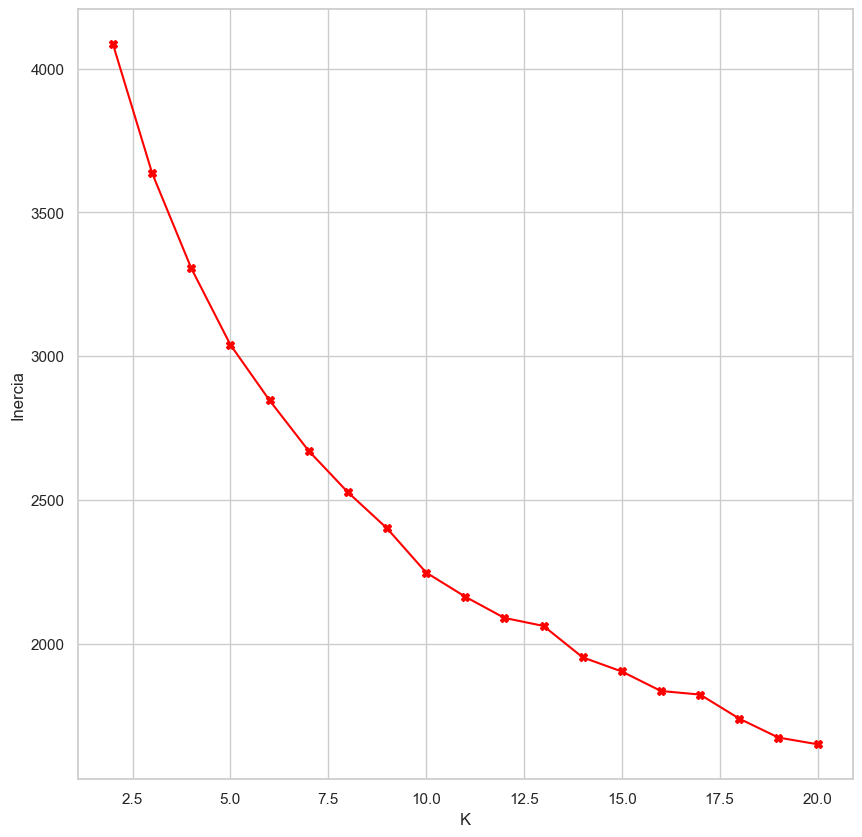

In [41]:
# Suma de los errores cuadráticos
SSE = []
# Coeficientes de silueta
silhouetteScores = []
# Posibles clusters
K = range(2, 21)
# Recorremos el rango de K
for k in K:
    # Creamos el modelo de K clusters
    kmeans = KMeans(n_clusters = k, max_iter = 100000)
    # Hacemos unas predicciones
    predictions = kmeans.fit_predict(dfScaledPCA)
    # Calculamos la inercia o suma de los errores cuadráticos y la agregamos a la lista
    SSE.append(kmeans.inertia_)
    # Calculamos el coeficiente de silueta y lo agregamos a la lista
    silhouetteScores.append(silhouette_score(dfScaledPCA, predictions))
    
# Hacemos el gráfico del método del codo
plt.figure(figsize = (10, 10))
plt.plot(K, SSE, color = "red", marker = "X")
plt.xlabel("K")
plt.ylabel("Inercia")
plt.show()

Ahora visualizamos cómo cambia el coeficiente de silueta.

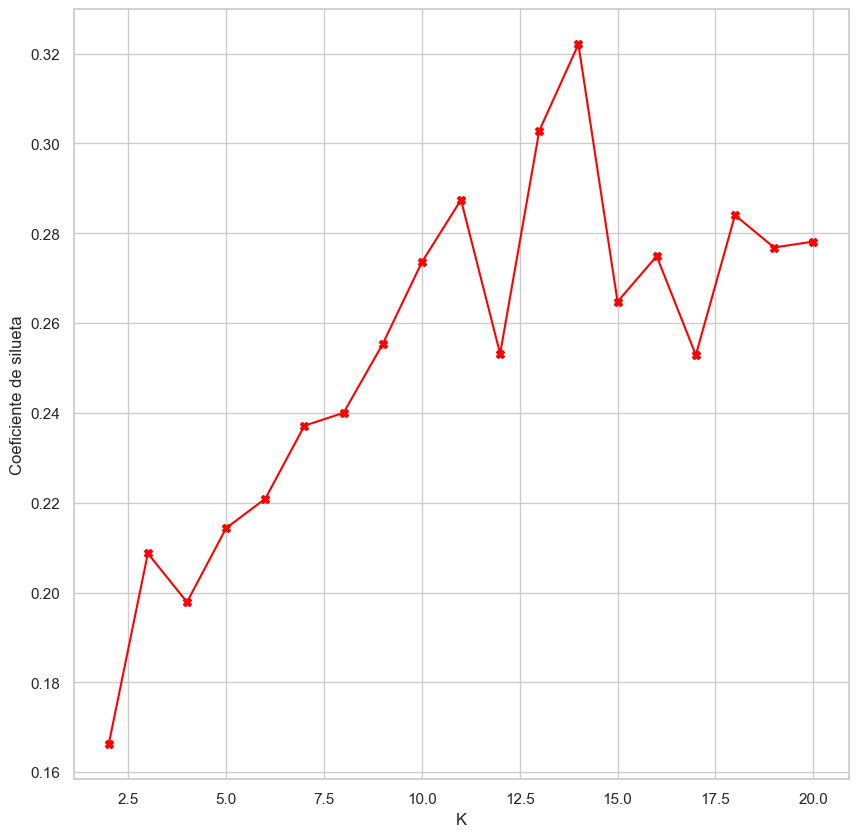

In [42]:
plt.figure(figsize = (10, 10))
plt.plot(K, silhouetteScores, color = "red", marker = "X")
plt.xlabel("K")
plt.ylabel("Coeficiente de silueta")
plt.show()

Vemos que los dos valores de K donde es más alto el coeficiente de silueta son 12 y 15; en este caso seleccionaremos 12 clusters a pesar no tener el coeficiente de silueta más alto ya que parece no queremos tantos grupos.

In [43]:
# Creamos el modelo con 12 clusters
kmeans = KMeans(n_clusters = 12, max_iter = 100000)
# Entrenamos el modelo y hacemos la clusterización y los guardamos en un df
predictions = kmeans.fit_predict(dfScaledPCA)
# Añadimos una columna al conjunto de datos original para especificar a qué cluster pertenece en base a la predicción
df["KMeansPCA"] = predictions
silhouette_score(dfScaledPCA, predictions)

0.2986023548552227

Aplicando K-Means con PCA obtuvimos 12 clusters y un coeficiente de silueta de aproximadamente 0.3

#### Sin PCA

Ahora utilizaremos el mismo método de K-Means pero en el dataset sin aplicar PCA.

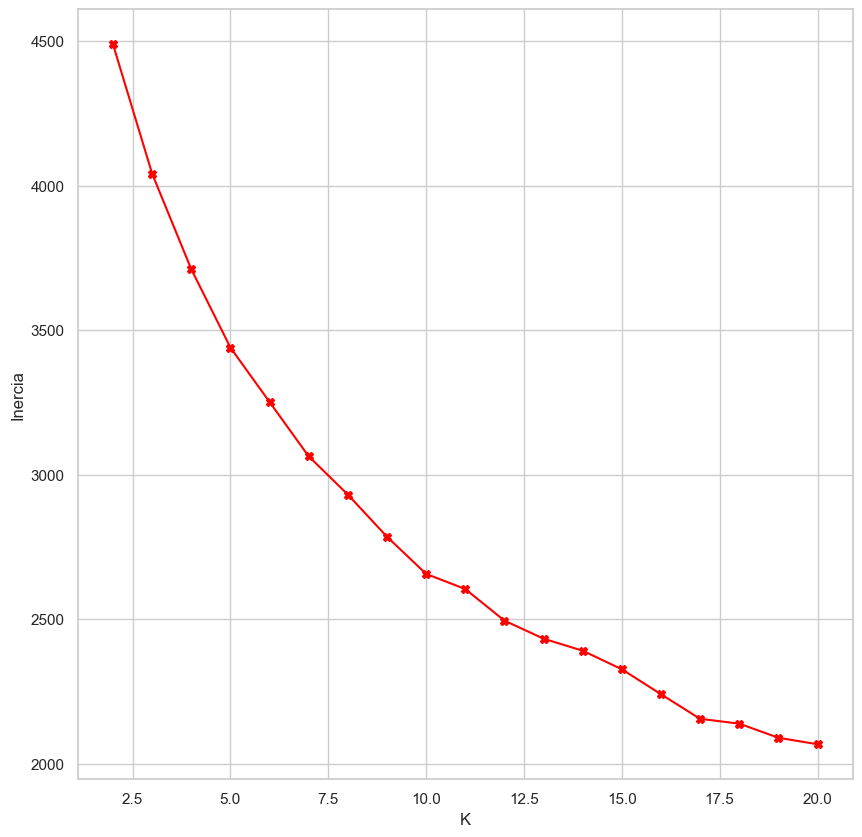

In [44]:
# Suma de los errores cuadráticos
SSE = []
# Coeficientes de silueta
silhouetteScores = []
# Posibles clusters
K = range(2, 21)
# Recorremos el rango de K
for k in K:
    # Creamos el modelo de K clusters
    kmeans = KMeans(n_clusters = k, max_iter = 100000)
    # Hacemos unas predicciones
    predictions = kmeans.fit_predict(dfScaled)
    # Calculamos la inercia o suma de los errores cuadráticos y la agregamos a la lista
    SSE.append(kmeans.inertia_)
    # Calculamos el coeficiente de silueta y lo agregamos a la lista
    silhouetteScores.append(silhouette_score(dfScaled, predictions))
    
# Hacemos el gráfico del método del codo
plt.figure(figsize = (10, 10))
plt.plot(K, SSE, color = "red", marker = "X")
plt.xlabel("K")
plt.ylabel("Inercia")
plt.show()

Ahora visualizamos cómo cambia el coeficiente de silueta.

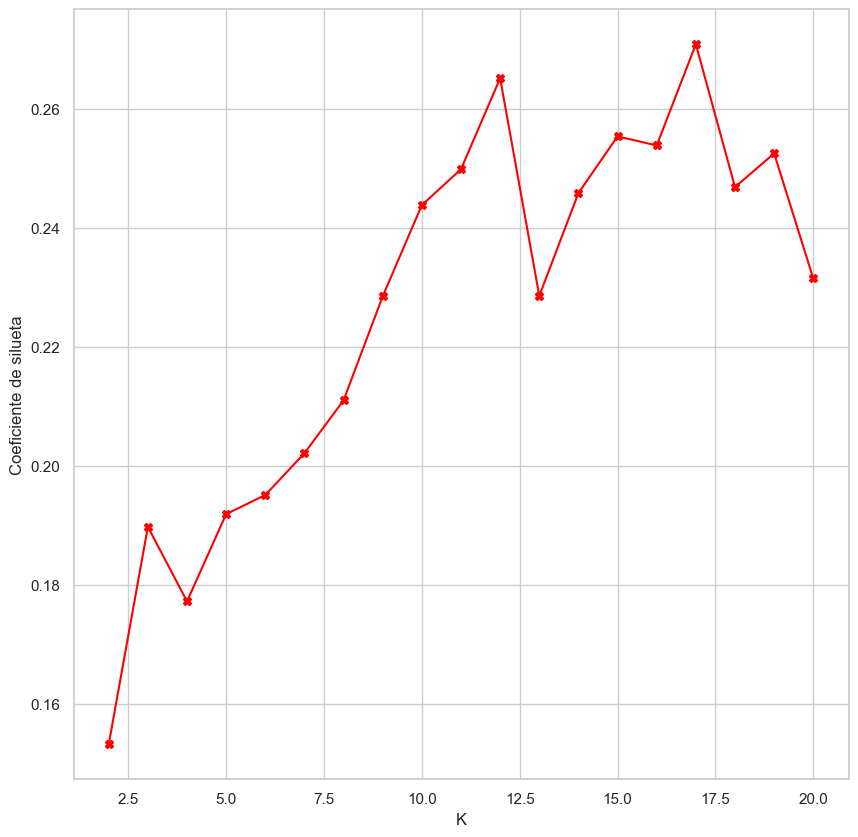

In [45]:
plt.figure(figsize = (10, 10))
plt.plot(K, silhouetteScores, color = "red", marker = "X")
plt.xlabel("K")
plt.ylabel("Coeficiente de silueta")
plt.show()

Nuevamente observamos que el coeficiente de silueta es mayor en K igual a 12 y 16; de nuevo seleccionaremos 12 clusters.

In [46]:
# Creamos el modelo con 12 clusters
kmeans = KMeans(n_clusters = 12, max_iter = 100000)
# Entrenamos el modelo y hacemos la clusterización y los guardamos en un df
predictions = kmeans.fit_predict(dfScaled)
# Añadimos una columna al conjunto de datos original para especificar a qué cluster pertenece en base a la predicción
df["KMeansNoPCA"] = predictions
silhouette_score(dfScaled, predictions)

0.26296935133287375

Con K-Means pero sin utilizar PCA y con 12 clusters obtuvimos un coeficiente de silueta de aproximadamente 0.22

### Agglomerative Hierarchical Clustering

#### Con PCA

Lo primero es crear un dendograma para saber el número de clusters y así construir el modelo.

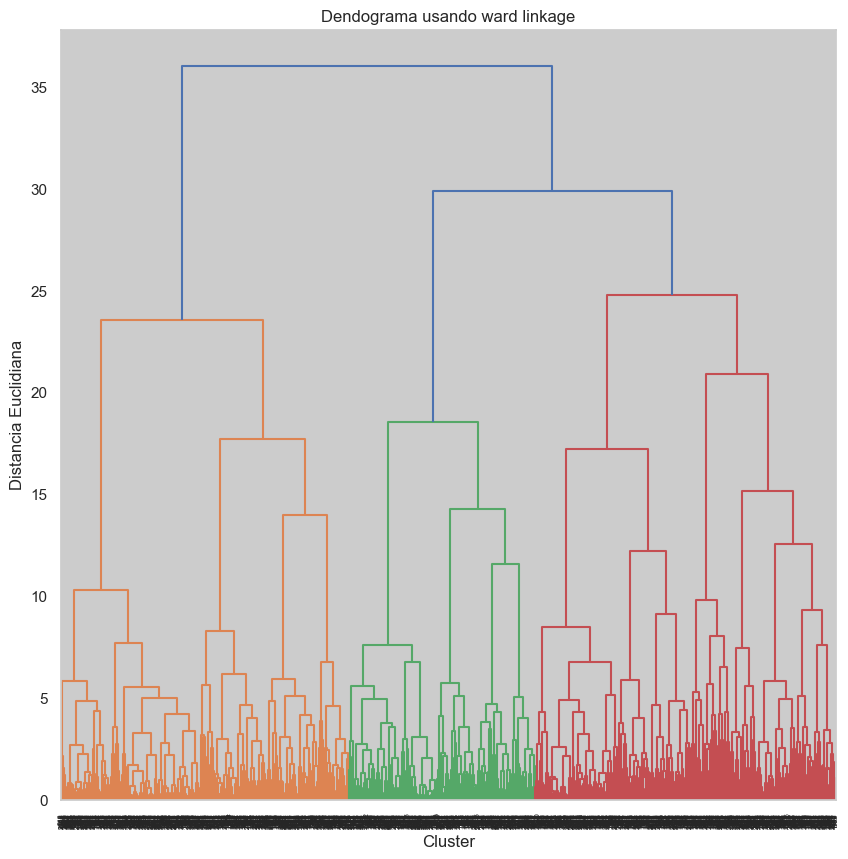

In [47]:
plt.figure(figsize = (10, 10))
# Creamos el dendograma con el método de ward linkage
dendogramPlot = dendrogram(linkage(dfScaledPCA, method = "ward"))
plt.title("Dendograma usando ward linkage")
plt.xlabel("Cluster")
plt.ylabel("Distancia Euclidiana")
plt.show()

Parece que una buena forma de agrupar los datos es a través de 12 clusters; con esta información procedemos a aplicar el algoritmo.

Creamos el modelo, lo entrenamos, hacemos las predicciones y las guardamos al igual que los centroides.

In [48]:
# Creamos el modelo con 12 clusters; distancia euclidiana; ward linkage
hc = AgglomerativeClustering(n_clusters = 12, affinity = "euclidean", linkage = "ward")
# Entrenamos el modelo y hacemos la clusterización y los guardamos en un df
predictions = hc.fit_predict(dfScaledPCA)
# Añadimos una columna al conjunto de datos para especificar a qué cluster pertenece en base a la predicción
df["hcPCA"] = predictions
silhouette_score(dfScaledPCA, predictions)

0.28761561926949825

Con Hierarchical Clustering y PCA obtuvimos 12 clusters y un coeficiente de silueta de aproximadamente 0.29

#### Sin PCA

Ahora haremos el clustering jerárquico pero utilizando el dataset que no tiene aplicado la reducción de dimensionalidad.

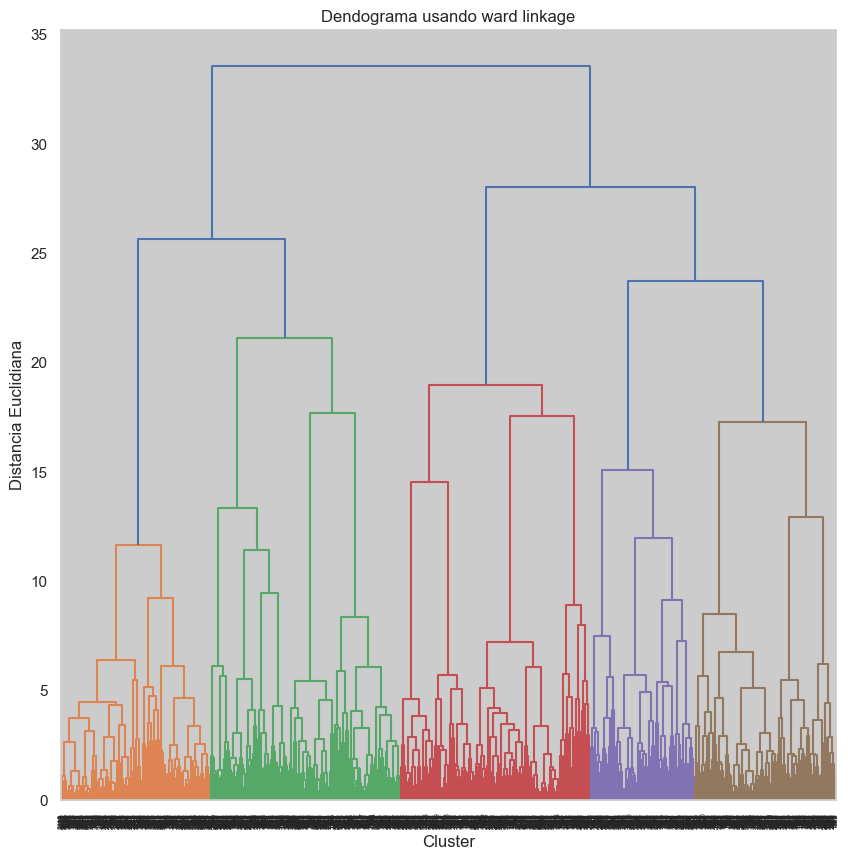

In [49]:
plt.figure(figsize = (10, 10))
# Creamos el dendograma con el método de ward linkage
dendogramPlot = dendrogram(linkage(dfScaled, method = "ward"))
plt.title("Dendograma usando ward linkage")
plt.xlabel("Cluster")
plt.ylabel("Distancia Euclidiana")
plt.show()

Parece que una buena forma de agrupar los datos es a través de 12 clusters; con esta información procedemos a aplicar el algoritmo.

Creamos el modelo, lo entrenamos, hacemos las predicciones y las guardamos al igual que los centroides.

In [50]:
# Creamos el modelo con 12 clusters; distancia euclidiana; ward linkage
hc = AgglomerativeClustering(n_clusters = 12, affinity = "euclidean", linkage = "ward")
# Entrenamos el modelo y hacemos la clusterización y los guardamos en un df
predictions = hc.fit_predict(dfScaled)
# Añadimos una columna al conjunto de datos para especificar a qué cluster pertenece en base a la predicción
df["hcNoPCA"] = predictions
silhouette_score(dfScaled, predictions)

0.24650687075460564

Aplicando Herarchical Clustering sin PCA obtenemos 12 clusters y un coeficiente de silueta de aproximadamente 0.25

### DBSCAN

#### Con PCA

El algoritmo de DBSCAN es muy sensible en sus híper-parámetros así que es fundamental encontrar los más óptimos.

Utilizaremos *NearestNeighbors* para encontrar los vecinos más cercanos a cada punto para medir las distancias.

In [51]:
# n_neighbors es el número de vecinos y normalmente se toman las dimensiones o features y se las multiplica por 2
neighbors = NearestNeighbors(n_neighbors = 4)
# Entrenamos el algoritmo
neighborsFit = neighbors.fit(dfScaledPCA)
# Obtenemos las distancias 
distances, index = neighborsFit.kneighbors(dfScaledPCA)

Ya tenemos las distancias de los 4 vecinos más cercanos a cada punto, ahora graficaremos.

In [52]:
# Ordenamos las distancias por filas
distances = np.sort(distances, axis = 0)
# Nos quedamos con los más cercanos
distances = distances[:, 1]

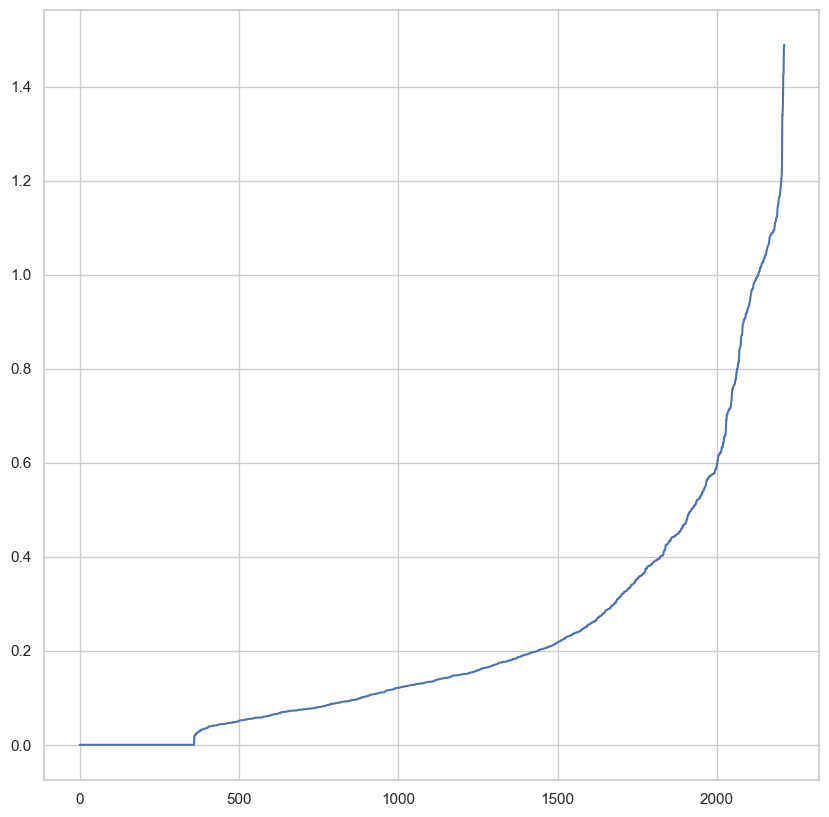

In [53]:
plt.figure(figsize = (10, 10))
plt.plot(distances)
plt.show()

Lo que buscamos es algo similiar a la metodología del codo, pero en este caso es de la rodilla ya que buscamos ese intervalo donde comienza a crecer como vemos en este caso desde 0.2 hasta 1; con esto pasamos a iterar con diferentes valores de épsilon y el número de minpoints.

In [54]:
# Lista de epsilons
epsilons = np.arange(0.2, 1, 0.05)
# Lista de minpoints
minPoints = np.arange(2, 14)

Nos apoyamos de la libería *itertools* y la clase product para crear una lista de todas las combinaciones entre epsilons y minpoints para luego iterar sobre ellos.

In [55]:
# Parámetros para el DBSCAN
paramns = list(product(epsilons, minPoints))
# Para guardar los coeficientes de silueta
silhouetteScores = []
# Para guardar el número de clusters
kClusters = []

# Iteramos
for paramn in paramns:
    # Creamos el modelo, lo entrenamos y hacemos las predicciones
    predictions = DBSCAN(eps = paramn[0], min_samples = paramn[1]).fit_predict(dfScaledPCA)
    try:
        # Agregamos a la lista el coeficiente de silueta
        silhouetteScores.append(silhouette_score(dfScaledPCA, predictions))
    except:
        silhouetteScores.append(0)
    kClusters.append(len(np.unique(predictions)))
    

Vamos a graficar los coeficientes de silueta.

In [56]:
# Creamos un df a partir de los parámetros
dfParamns = pd.DataFrame.from_records(paramns, columns = ["Epsilon", "MinPoints"])
# Agregamos el coeficiente de silueta
dfParamns["silScore"] = silhouetteScores
# Agregamos el número de clusters
dfParamns["KClusters"] = kClusters
# Ahora necesiamos convertir esto a una estructura matricial para un mapa de calor y para ello utilizamos pivot
# Pivoteamos el df de los parámetros; los valores serán el coeficiente de silueta; el índice MinPoints y la columna Epsilon
pivotParamns = pd.pivot_table(dfParamns, values = "silScore", index = "MinPoints", columns = "Epsilon")

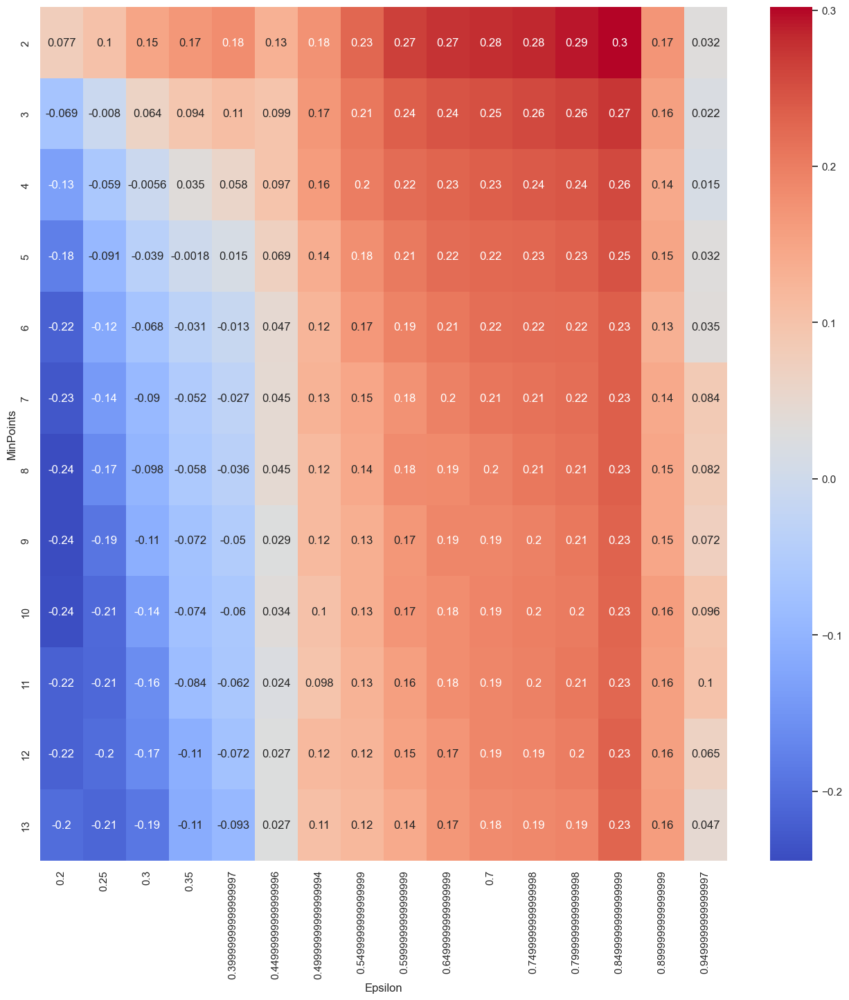

In [57]:
plt.figure(figsize = (16, 16))
sns.heatmap(
    pivotParamns,
    annot = True,
    cmap = "coolwarm"
)
plt.show()

Ahora haremos la misma gráfica pero los valores serán el número de clusters.

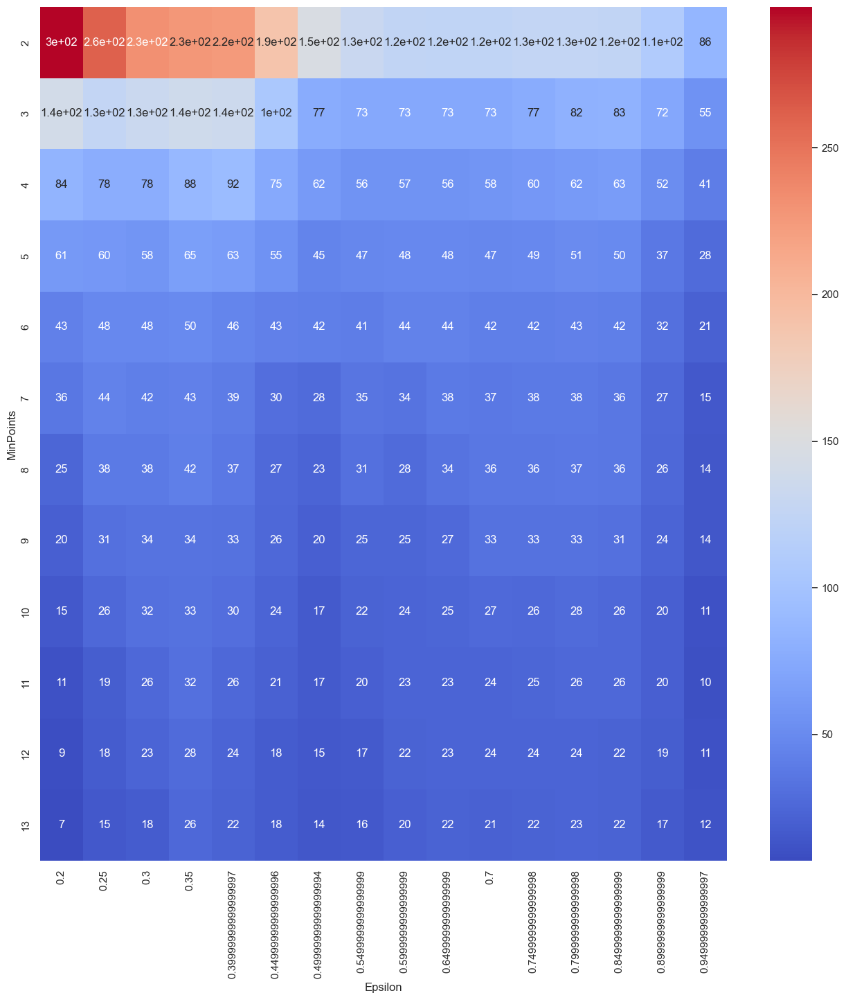

In [58]:
# Pivoteamos el df de los parámetros; los valores serán el coeficiente de silueta; el índice MinPoints y la columna Epsilon
pivotKClusters = pd.pivot_table(dfParamns, values = "KClusters", index = "MinPoints", columns = "Epsilon")

plt.figure(figsize = (16, 16))
sns.heatmap(
    pivotKClusters,
    annot = True,
    cmap = "coolwarm"
)
plt.show()

Vemos que utilizando un épsilon de 0.85 y 13 minpoints obtendríamos un coeficiente de silueta de 0.23 y 22 clusters; vamos a construir el modelo utilizando estos parámetros.

In [59]:
# Creamos el modelo con epsilon 0.85 y 13 minpoints
dbscan = DBSCAN(eps = 0.85, min_samples = 13)
# Entrenamos el modelo y hacemos unas predicciones
predictions = dbscan.fit_predict(dfScaledPCA)
# Creamos una variable en el df para el cluster predicho
df["dbscanPCA"] = predictions
silhouette_score(dfScaledPCA, predictions)

0.2293174964543287

De esta manera, con DBSCAN y PCA obtuvimos un coeficiente de silueta de aproximadamente 0.23 y 22 clusters.

#### Sin PCA

Haremos el mismo procedimiento pero sobre el conjunto de datos que no tiene aplicada la reducción de dimensionalidad.

In [60]:
# n_neighbors es el número de vecinos y normalmente se toman las dimensiones o features y se las multiplica por 2
neighbors = NearestNeighbors(n_neighbors = 4)
# Entrenamos el algoritmo
neighborsFit = neighbors.fit(dfScaled)
# Obtenemos las distancias 
distances, index = neighborsFit.kneighbors(dfScaled)

Ya tenemos las distancias de los 4 vecinos más cercanos a cada punto, ahora graficaremos.

In [61]:
# Ordenamos las distancias por filas
distances = np.sort(distances, axis = 0)
# Nos quedamos con los más cercanos
distances = distances[:, 1]

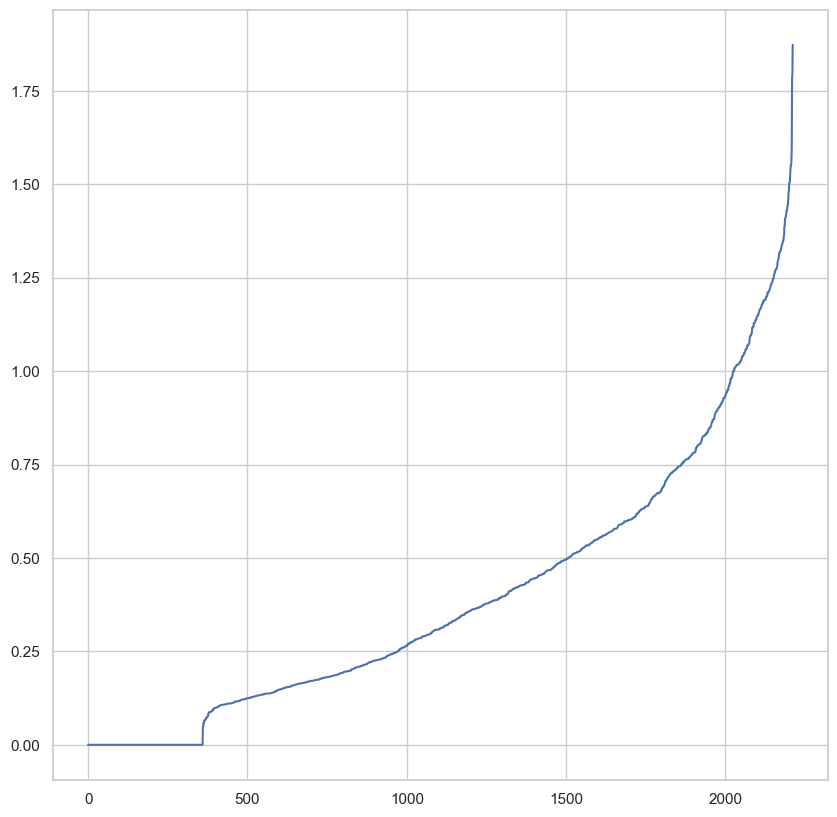

In [62]:
plt.figure(figsize = (10, 10))
plt.plot(distances)
plt.show()

Lo que buscamos es algo similiar a la metodología del codo, pero en este caso es de la rodilla ya que buscamos ese intervalo donde comienza a crecer como vemos en este caso desde 0.25 hasta 1.5; con esto pasamos a iterar con diferentes valores de épsilon y el número de minpoints.

In [63]:
# Lista de epsilons
epsilons = np.arange(0.25, 1.5, 0.05)
# Lista de minpoints
minPoints = np.arange(2, 19)

Nos apoyamos de la libería *itertools* y la clase product para crear una lista de todas las combinaciones entre epsilons y minpoints para luego iterar sobre ellos.

In [64]:
# Parámetros para el DBSCAN
paramns = list(product(epsilons, minPoints))
# Para guardar los coeficientes de silueta
silhouetteScores = []
# Para guardar el número de clusters
kClusters = []

# Iteramos
for paramn in paramns:
    # Creamos el modelo, lo entrenamos y hacemos las predicciones
    predictions = DBSCAN(eps = paramn[0], min_samples = paramn[1]).fit_predict(dfScaled)
    try:
        # Agregamos a la lista el coeficiente de silueta
        silhouetteScores.append(silhouette_score(dfScaled, predictions))
    except:
        silhouetteScores.append(0)
    kClusters.append(len(np.unique(predictions)))
    

Vamos a graficar los coeficientes de silueta.

In [65]:
# Creamos un df a partir de los parámetros
dfParamns = pd.DataFrame.from_records(paramns, columns = ["Epsilon", "MinPoints"])
# Agregamos el coeficiente de silueta
dfParamns["silScore"] = silhouetteScores
# Agregamos el número de clusters
dfParamns["KClusters"] = kClusters
# Ahora necesiamos convertir esto a una estructura matricial para un mapa de calor y para ello utilizamos pivot
# Pivoteamos el df de los parámetros; los valores serán el coeficiente de silueta; el índice MinPoints y la columna Epsilon
pivotParamns = pd.pivot_table(dfParamns, values = "silScore", index = "MinPoints", columns = "Epsilon")

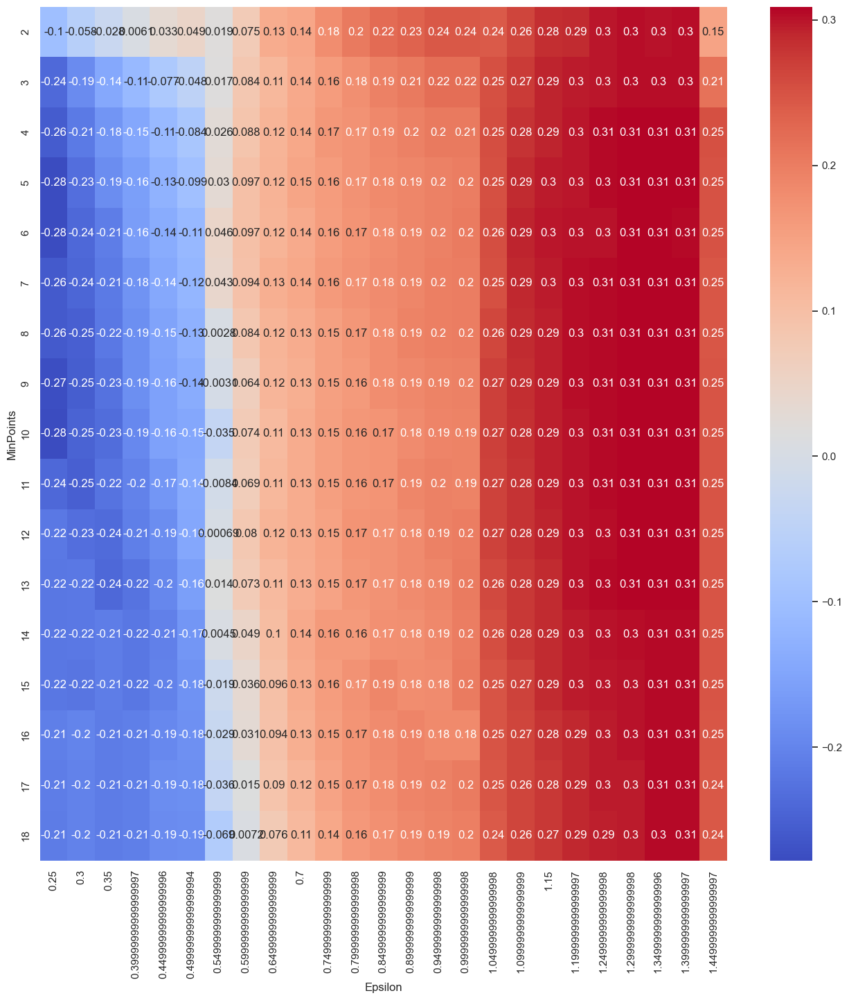

In [66]:
plt.figure(figsize = (16, 16))
sns.heatmap(
    pivotParamns,
    annot = True,
    cmap = "coolwarm"
)
plt.show()

Ahora haremos la misma gráfica pero los valores serán el número de clusters.

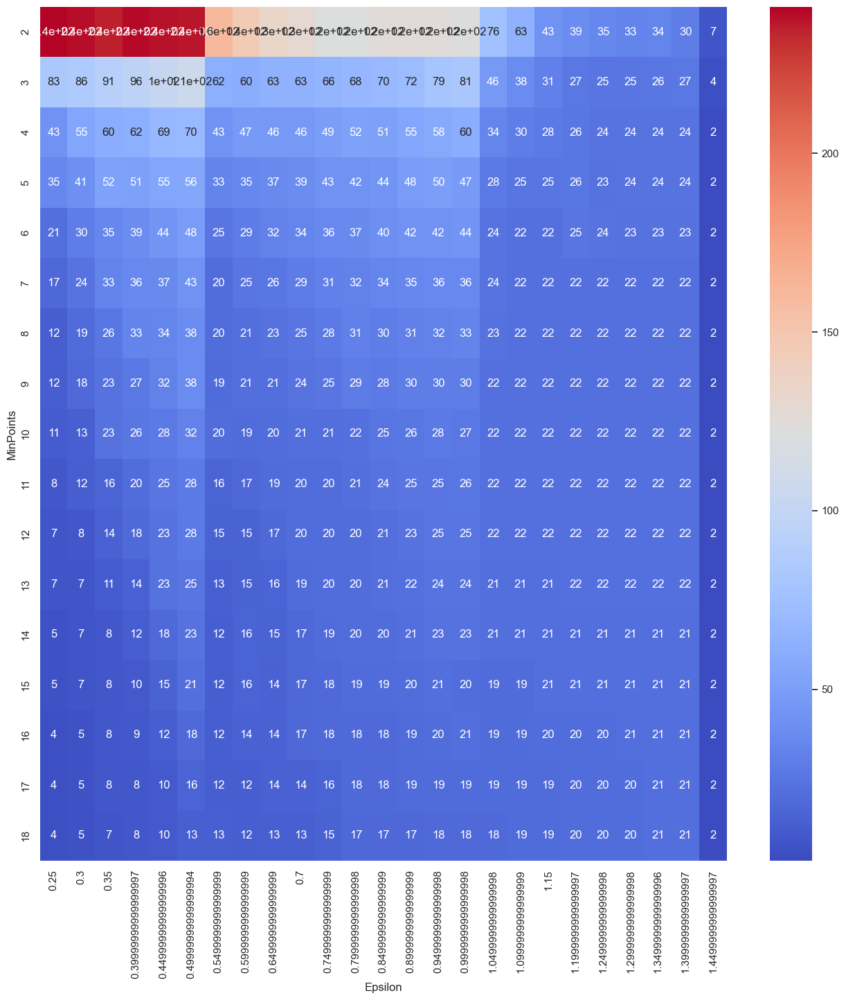

In [67]:
# Pivoteamos el df de los parámetros; los valores serán el coeficiente de silueta; el índice MinPoints y la columna Epsilon
pivotKClusters = pd.pivot_table(dfParamns, values = "KClusters", index = "MinPoints", columns = "Epsilon")

plt.figure(figsize = (16, 16))
sns.heatmap(
    pivotKClusters,
    annot = True,
    cmap = "coolwarm"
)
plt.show()

Vemos que utilizando un épsilon de 1.4 y 14 minpoints obtendríamos un coeficiente de silueta de 0.31 y 21 clusters; vamos a construir el modelo utilizando estos parámetros.

In [68]:
# Creamos el modelo con epsilon 1.4 y 14 minpoints
dbscan = DBSCAN(eps = 1.4, min_samples = 14)
# Entrenamos el modelo y hacemos unas predicciones
predictions = dbscan.fit_predict(dfScaled)
# Creamos una variable en el df para el cluster predicho
df["dbscanNoPCA"] = predictions
silhouette_score(dfScaled, predictions)

0.3050853785370678

Aplicando DBSCAN sin PCA obtuvimos 21 clusters y un coeficiente de silueta de aproximadamente 0.31

## Evaluación de los modelos

Luego de realizar todas las agrupaciones con los distintos modelos obtuvimos el siguiente conjunto de datos.

In [69]:
df.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,Complain,Z_CostContact,Z_Revenue,Response,KMeansPCA,KMeansNoPCA,hcPCA,hcNoPCA,dbscanPCA,dbscanNoPCA
0,5524,1957,Graduation,Single,58138.0,0,0,2012-09-04,58,635,...,0,3,11,1,10,1,3,9,0,0
1,2174,1954,Graduation,Single,46344.0,1,1,2014-03-08,38,11,...,0,3,11,0,10,1,3,9,1,0
2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,426,...,0,3,11,0,3,2,6,8,2,1
3,6182,1984,Graduation,Together,26646.0,1,0,2014-02-10,26,11,...,0,3,11,0,3,2,6,8,2,1
4,5324,1981,PhD,Married,58293.0,1,0,2014-01-19,94,173,...,0,3,11,0,4,3,7,6,3,2


El modelo que nos dio un mayor coeficiente de silueta es el de DBSCAN sin PCA pero este modelo nos arrojaba 21 clusters lo cual son bastantes agrupaciones; siendo así, considero que el mejor modelo es el de K-Means con PCA ya que dio como resultado 12 clusters y un coeficiente de silueta de 0.3 así que realizaremos los análisis con dicho modelo.

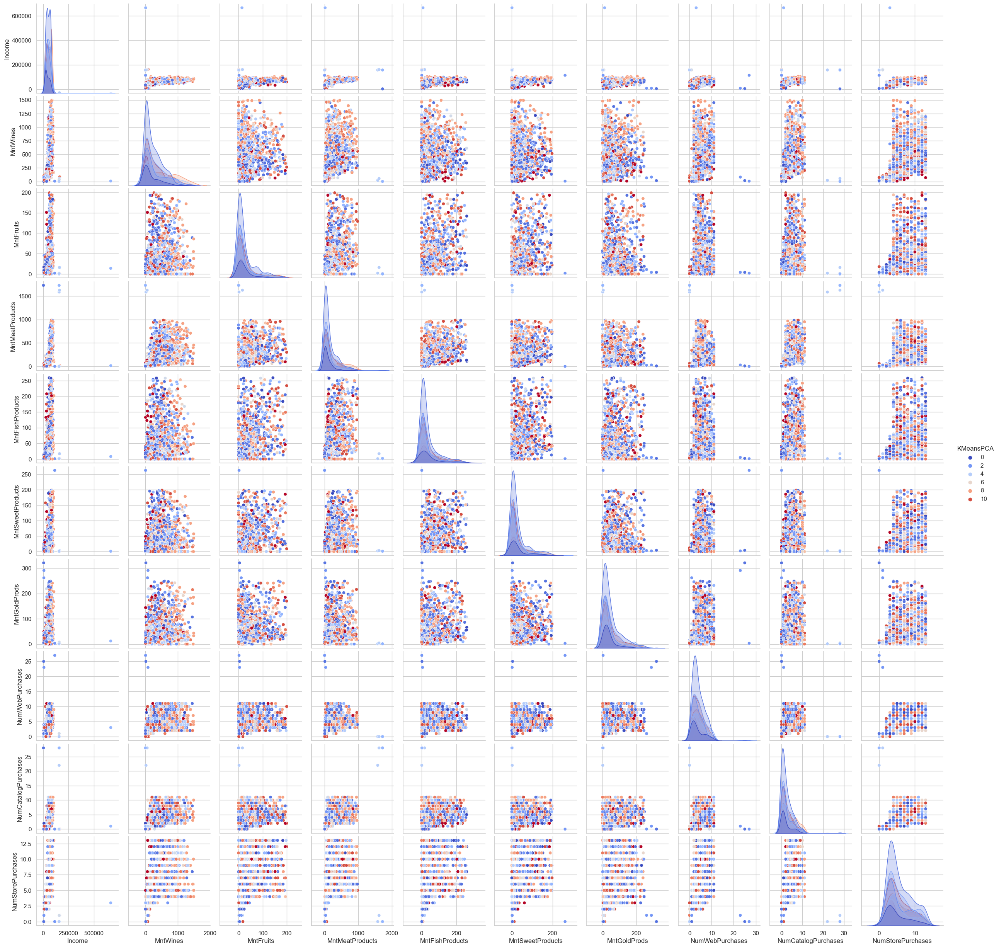

In [70]:
sns.pairplot(
    data = df[numVars + ["KMeansPCA"]],
    hue = "KMeansPCA",
    palette = "coolwarm"
)
plt.show()

### Grupo 0

Vamos a analizar el grupo 0.

In [71]:
df[df["KMeansPCA"] == 0]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,Complain,Z_CostContact,Z_Revenue,Response,KMeansPCA,KMeansNoPCA,hcPCA,hcNoPCA,dbscanPCA,dbscanNoPCA
78,10401,1976,2n Cycle,Together,26326.0,0,0,2013-09-04,12,1,...,1,3,11,0,0,11,1,0,13,16
105,8373,1979,Basic,Together,24594.0,1,0,2013-12-10,94,1,...,0,3,11,0,0,7,1,0,-1,-1
118,5234,1967,2n Cycle,Together,30753.0,1,1,2013-07-11,85,12,...,0,3,11,0,0,11,1,0,13,16
125,1491,1965,2n Cycle,Together,71488.0,0,0,2013-02-18,87,162,...,0,3,11,0,0,11,1,0,13,16
152,7798,1972,2n Cycle,Together,46344.0,0,1,2012-12-14,28,233,...,0,3,11,0,0,11,1,0,13,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2156,8726,1964,2n Cycle,Divorced,41713.0,1,1,2014-04-29,57,77,...,0,3,11,0,0,11,0,2,-1,18
2163,7313,1949,2n Cycle,Widow,74859.0,0,0,2013-06-03,63,570,...,0,3,11,0,0,11,9,10,-1,-1
2208,3850,1963,Basic,Together,14918.0,0,1,2012-12-07,52,3,...,0,3,11,0,0,7,1,0,-1,-1
2210,607,1955,2n Cycle,Divorced,41769.0,0,1,2013-02-13,31,302,...,0,3,11,0,0,11,0,2,-1,18


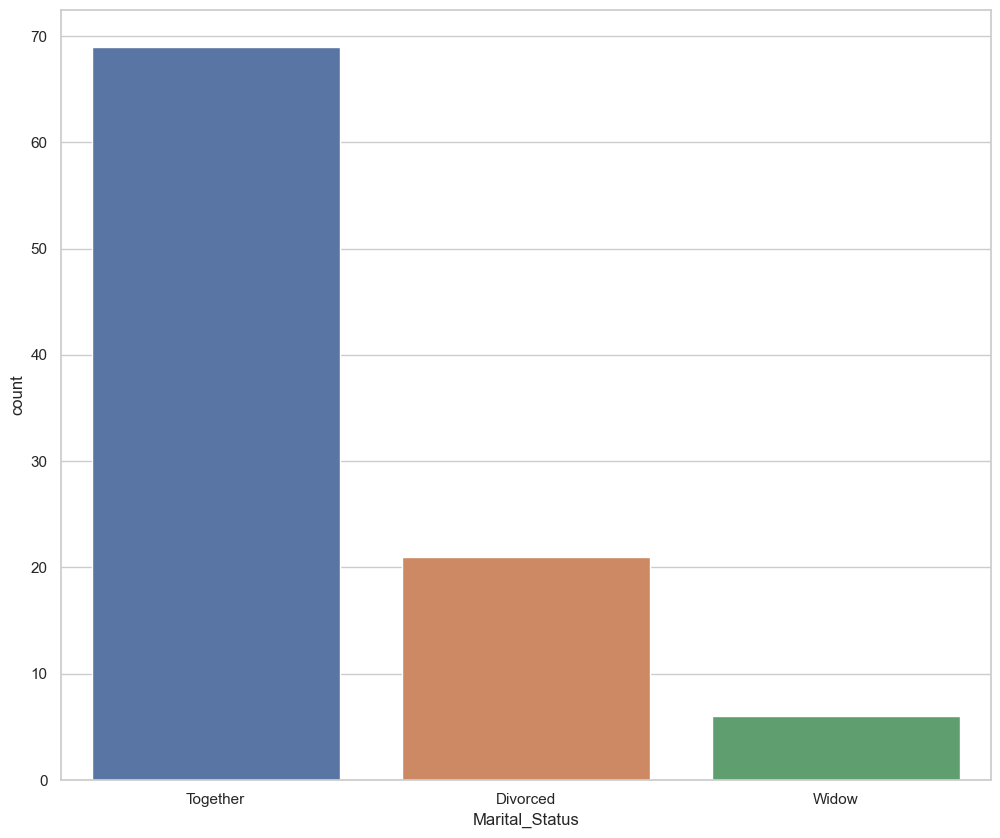

In [72]:
sns.countplot(
    data = df[df["KMeansPCA"] == 0],
    x = "Marital_Status"
)
plt.show()

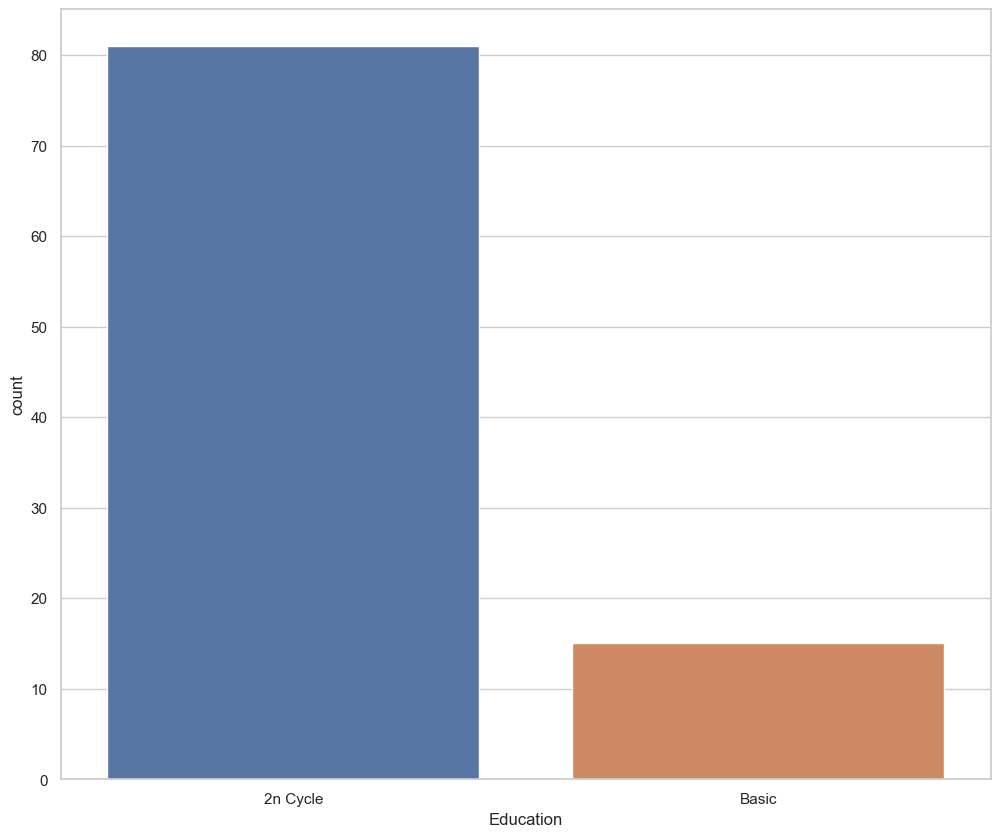

In [73]:
sns.countplot(
    data = df[df["KMeansPCA"] == 0],
    x = "Education"
)
plt.show()

Vemos que este grupo está formado únicamente personas con pareja, divorciados o viudos que tienen una educación básica.

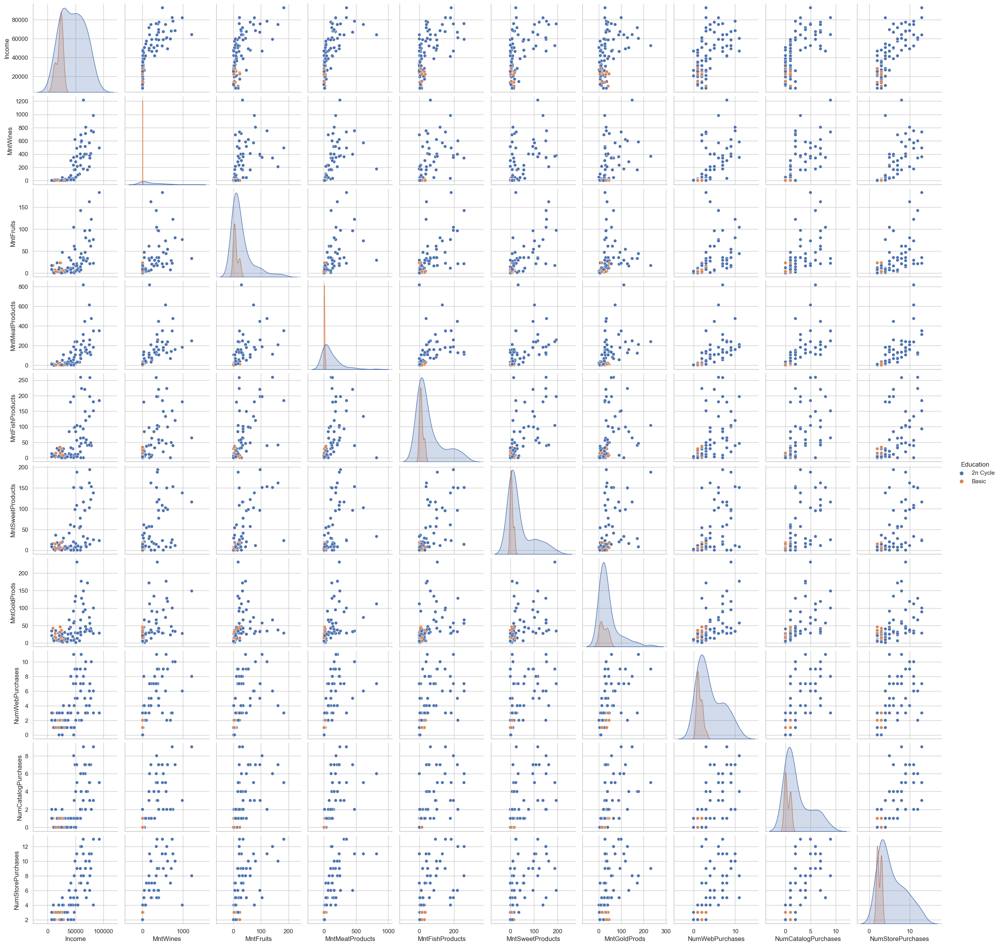

In [74]:
sns.pairplot(
    data = df[df["KMeansPCA"] == 0],
    hue = "Education",
    vars = numVars 
)
plt.show()

No parecen haber muchas diferencias en cuanto a la correlación de las variables.

In [75]:
df["Children"] = df["Kidhome"] + df["Teenhome"]

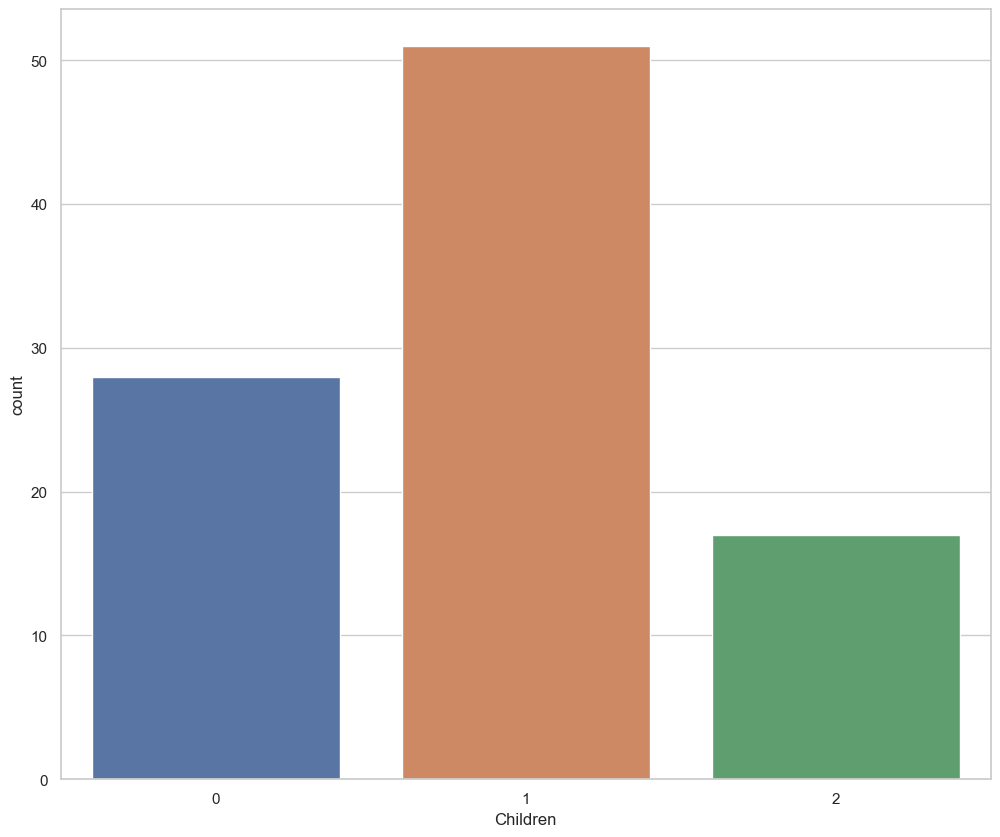

In [76]:
sns.countplot(
    data = df[df["KMeansPCA"] == 0],
    x = "Children"
)
plt.show()

Vemos que la mayoría tiene un solo hijo, seguido de ningún hijo.

In [77]:
# Creamos una lista con las variables numéricas de interés
numVars = ["Income", "MntWines", "MntFruits", "MntMeatProducts", "MntFishProducts", "MntSweetProducts", "MntGoldProds", "NumWebPurchases", "NumCatalogPurchases", "NumStorePurchases", "Kidhome", "Teenhome", "Complain", "NumDealsPurchases"]
# Resumen estadístico de las variables numéricas de interés
df[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000
mean,52232.510850,305.030741,26.324593,166.970163,37.516275,27.047468,43.822333,4.083183,2.668174,5.800181,0.442586,0.505425,0.009494,2.321429
std,25187.455359,337.611255,39.781794,224.344950,54.558673,41.092454,51.623472,2.741930,2.924378,3.253616,0.537052,0.544258,0.096994,1.923511
min,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,35233.500000,23.750000,1.750000,16.000000,3.000000,1.000000,9.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,51381.500000,173.500000,8.000000,68.000000,12.000000,8.000000,24.000000,4.000000,2.000000,5.000000,0.000000,0.000000,0.000000,2.000000
75%,68522.000000,505.500000,33.000000,232.250000,50.000000,33.000000,56.000000,6.000000,4.000000,8.000000,1.000000,1.000000,0.000000,3.000000
max,666666.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,321.000000,27.000000,28.000000,13.000000,2.000000,2.000000,1.000000,15.000000


In [78]:
df0 = df[df["KMeansPCA"] == 0]
df0[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,96.000000,96.000000,96.000000,96.000000,96.000000,96.000000,96.000000,96.000000,96.000000,96.000000,96.000000,96.000000,96.000000,96.000000
mean,41483.697917,184.625000,25.489583,97.114583,49.322917,33.593750,38.250000,3.593750,2.041667,5.145833,0.489583,0.395833,0.020833,2.427083
std,21283.469141,262.086697,36.345128,142.658729,70.213433,49.620365,42.041083,2.904001,2.449132,3.168859,0.502516,0.491596,0.143576,2.333936
min,7500.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000
25%,24810.000000,3.000000,4.000000,9.000000,4.000000,3.750000,10.000000,1.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,37661.500000,23.500000,10.500000,25.000000,13.000000,9.000000,27.500000,3.000000,1.000000,4.000000,0.000000,0.000000,0.000000,2.000000
75%,59085.000000,343.250000,30.000000,134.750000,59.250000,33.750000,42.000000,5.250000,3.000000,7.000000,1.000000,1.000000,0.000000,3.000000
max,92556.000000,1215.000000,183.000000,818.000000,259.000000,194.000000,232.000000,11.000000,9.000000,13.000000,1.000000,1.000000,1.000000,15.000000


En este grupo los ingresos y gastos en todos los productos excepto frutas y dulces están por debajo del promedio del conjunto de datos en general y que todos los que pertenecen son solteros.

### Grupo 1

Vamos a analizar el grupo 1.

In [79]:
df[df["KMeansPCA"] == 1]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,Z_CostContact,Z_Revenue,Response,KMeansPCA,KMeansNoPCA,hcPCA,hcNoPCA,dbscanPCA,dbscanNoPCA,Children
14,2569,1987,Graduation,Married,17323.0,0,0,2012-10-10,38,3,...,3,11,0,1,6,4,3,8,8,0
16,9736,1980,Graduation,Married,41850.0,1,1,2012-12-24,51,53,...,3,11,0,1,6,4,3,8,8,2
20,9360,1982,Graduation,Married,37040.0,0,0,2012-08-08,41,86,...,3,11,0,1,6,4,3,8,8,0
21,5376,1979,Graduation,Married,2447.0,1,0,2013-01-06,42,1,...,3,11,0,1,6,4,6,8,-1,1
26,2404,1976,Graduation,Married,53359.0,1,1,2013-05-27,4,173,...,3,11,0,1,6,4,3,8,8,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2220,6261,1979,Graduation,Married,58025.0,0,1,2013-11-26,81,270,...,3,11,0,1,6,4,3,8,8,1
2226,4478,1979,Graduation,Married,63777.0,1,1,2013-03-24,87,457,...,3,11,0,1,6,4,3,8,8,2
2229,10084,1972,Graduation,Married,24434.0,2,0,2014-05-18,9,3,...,3,11,0,1,6,4,3,8,8,2
2234,8372,1974,Graduation,Married,34421.0,1,0,2013-07-01,81,3,...,3,11,0,1,6,4,3,8,8,1


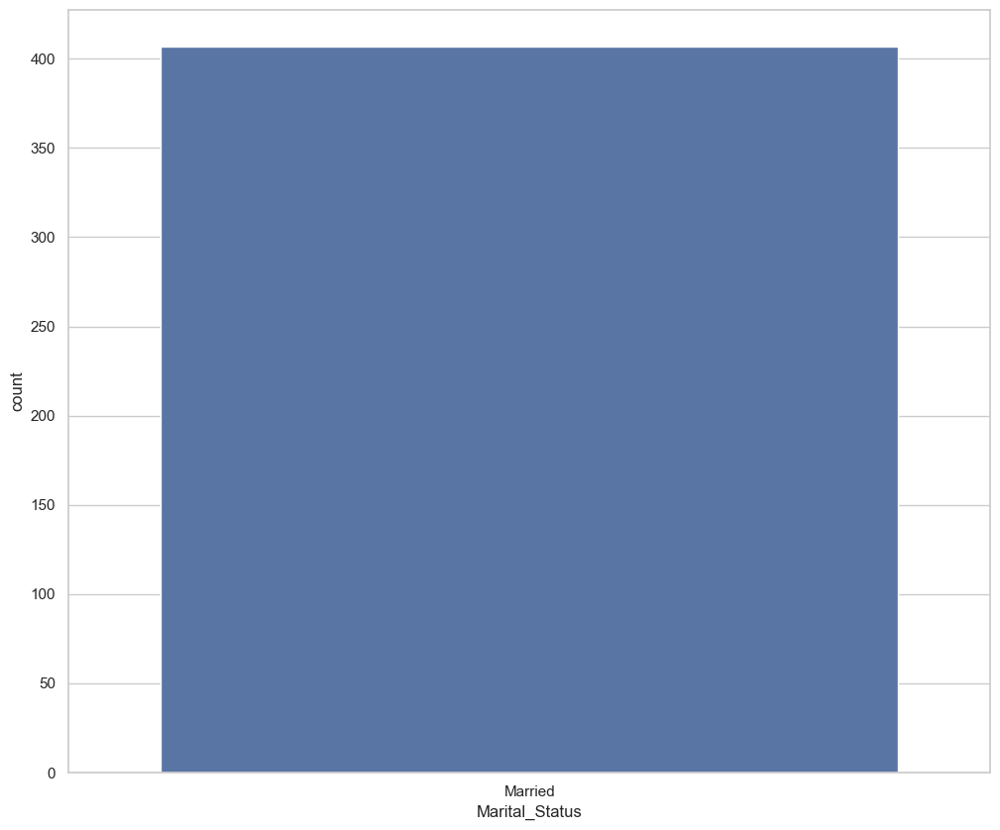

In [80]:
sns.countplot(
    data = df[df["KMeansPCA"] == 1],
    x = "Marital_Status"
)
plt.show()

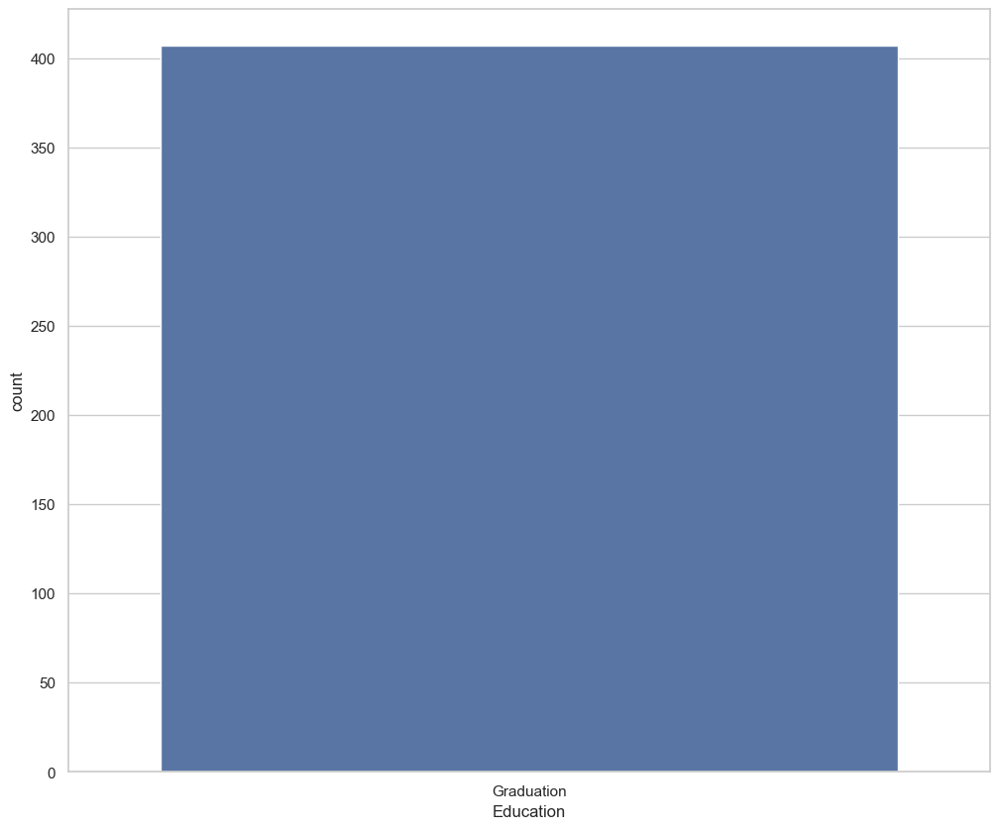

In [81]:
sns.countplot(
    data = df[df["KMeansPCA"] == 1],
    x = "Education"
)
plt.show()

Vemos que este grupo está formado únicamente por casados y graduados.

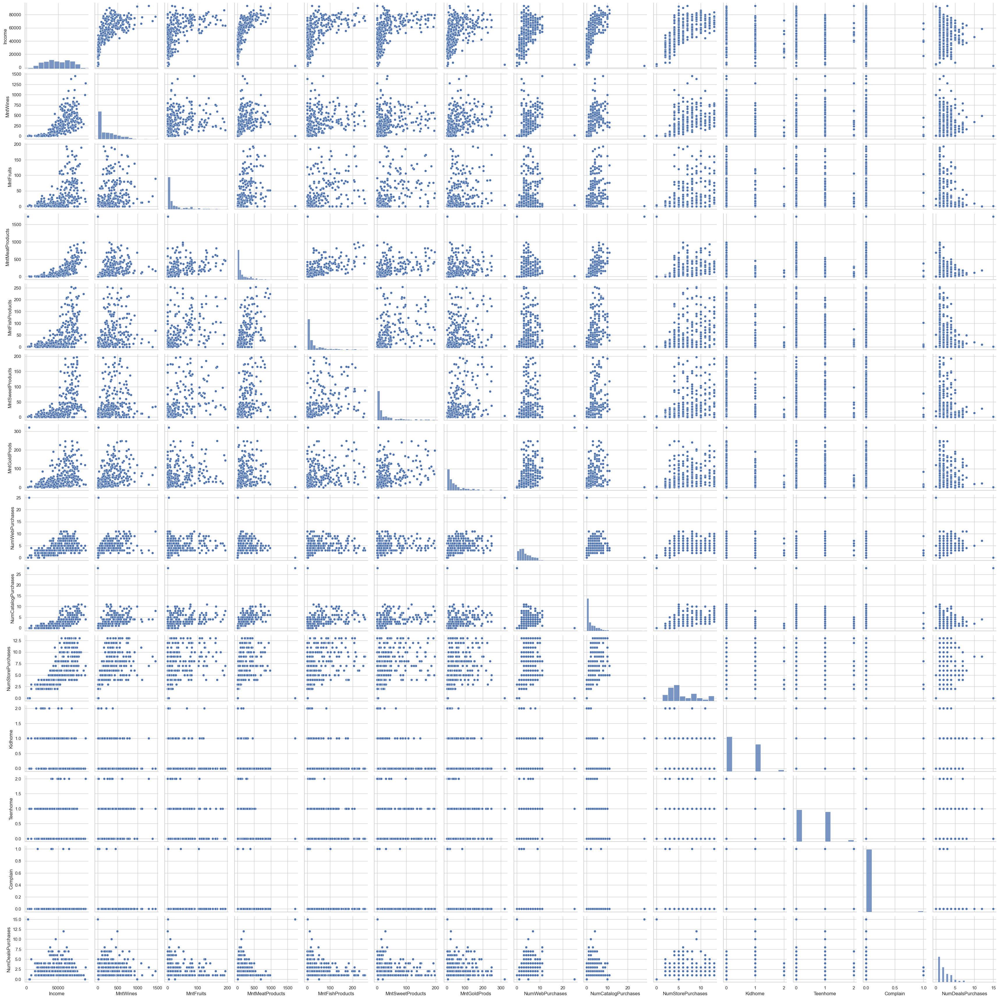

In [82]:
sns.pairplot(
    data = df[df["KMeansPCA"] == 1],
    vars = numVars 
)
plt.show()

No parecen haber muchas diferencias en cuanto a la correlación de las variables.

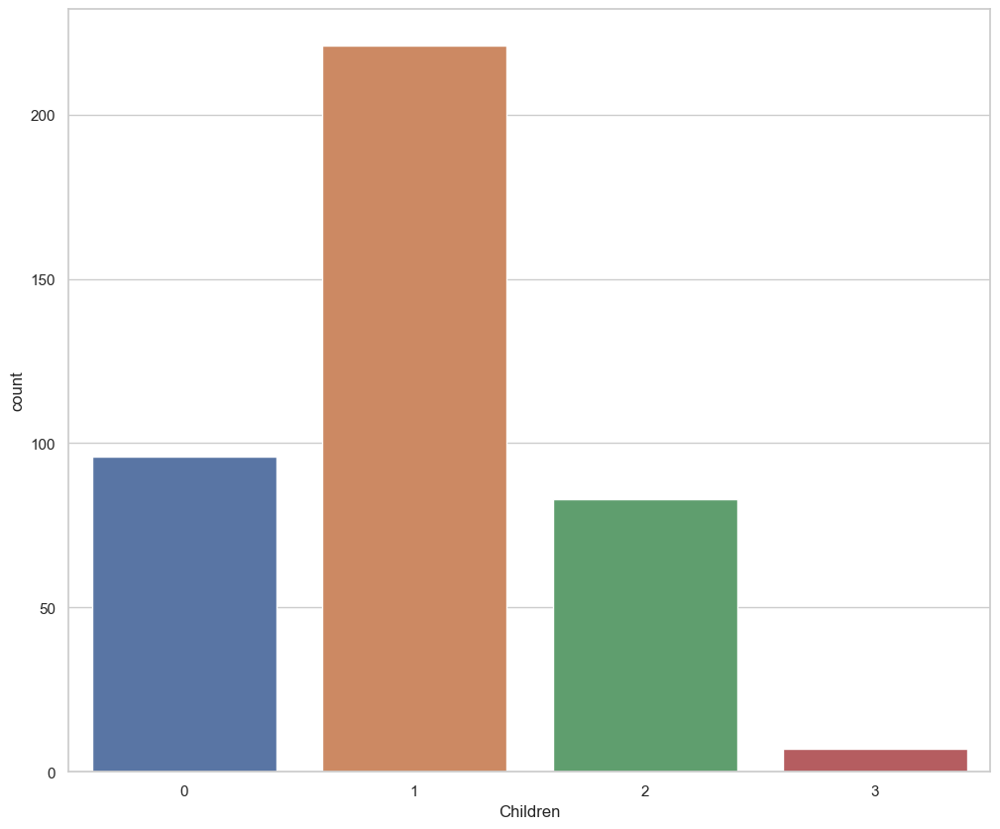

In [83]:
sns.countplot(
    data = df[df["KMeansPCA"] == 1],
    x = "Children"
)
plt.show()

Vemos que la gran mayoría tiene un solo hijo, seguido de ningún hijo.

In [84]:
# Resumen estadístico de las variables numéricas de interés
df[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000
mean,52232.510850,305.030741,26.324593,166.970163,37.516275,27.047468,43.822333,4.083183,2.668174,5.800181,0.442586,0.505425,0.009494,2.321429
std,25187.455359,337.611255,39.781794,224.344950,54.558673,41.092454,51.623472,2.741930,2.924378,3.253616,0.537052,0.544258,0.096994,1.923511
min,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,35233.500000,23.750000,1.750000,16.000000,3.000000,1.000000,9.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,51381.500000,173.500000,8.000000,68.000000,12.000000,8.000000,24.000000,4.000000,2.000000,5.000000,0.000000,0.000000,0.000000,2.000000
75%,68522.000000,505.500000,33.000000,232.250000,50.000000,33.000000,56.000000,6.000000,4.000000,8.000000,1.000000,1.000000,0.000000,3.000000
max,666666.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,321.000000,27.000000,28.000000,13.000000,2.000000,2.000000,1.000000,15.000000


In [85]:
df1 = df[df["KMeansPCA"] == 1]
df1[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000
mean,49284.090909,241.754300,27.130221,154.248157,37.452088,29.663391,47.702703,4.051597,2.388206,5.732187,0.476658,0.525799,0.014742,2.415233
std,20096.864281,267.627965,40.401132,210.656889,54.090073,43.592348,55.118882,2.739025,2.837410,3.239157,0.547111,0.551485,0.120667,1.817285
min,2447.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,33039.000000,22.000000,2.000000,16.000000,3.000000,2.000000,9.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,49096.000000,157.000000,8.000000,64.000000,13.000000,10.000000,27.000000,3.000000,1.000000,5.000000,0.000000,0.000000,0.000000,2.000000
75%,65905.000000,387.500000,33.500000,216.500000,49.000000,35.000000,61.500000,6.000000,4.000000,8.000000,1.000000,1.000000,0.000000,3.000000
max,93404.000000,1449.000000,193.000000,1725.000000,254.000000,197.000000,321.000000,25.000000,28.000000,13.000000,2.000000,2.000000,1.000000,15.000000


Vemos que este grupo tiene un promedio ligeramente mayor en el gasto en frutas, dulces y oro. Parece que lo que caracteriza a este grupo es que son casados y graduados.

### Grupo 2

Vamos a analizar el grupo 2.

In [86]:
df[df["KMeansPCA"] == 2]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,Z_CostContact,Z_Revenue,Response,KMeansPCA,KMeansNoPCA,hcPCA,hcNoPCA,dbscanPCA,dbscanNoPCA,Children
19,2278,1985,2n Cycle,Single,33812.0,1,0,2012-11-03,86,4,...,3,11,0,2,11,2,0,9,10,1
35,10738,1951,Master,Single,49389.0,1,1,2013-08-29,55,40,...,3,11,0,2,10,2,1,11,12,2
67,9369,1979,2n Cycle,Single,88194.0,0,1,2014-03-19,19,688,...,3,11,1,2,11,8,0,-1,-1,1
93,11178,1972,Master,Single,42394.0,1,0,2014-03-23,69,15,...,3,11,0,2,10,2,1,11,12,1
100,1473,1960,2n Cycle,Single,47823.0,0,1,2013-07-23,0,53,...,3,11,0,2,11,2,0,9,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2195,2980,1952,Master,Single,8820.0,1,1,2013-03-22,52,12,...,3,11,0,2,10,2,1,11,12,2
2200,7620,1990,Basic,Single,16185.0,1,0,2013-08-05,71,5,...,3,11,0,2,10,2,0,9,19,1
2213,3661,1995,2n Cycle,Single,80617.0,0,0,2012-10-12,42,594,...,3,11,0,2,11,2,0,9,10,0
2224,4286,1970,PhD,Single,57642.0,0,1,2014-01-09,24,580,...,3,11,0,2,9,2,1,-1,17,1


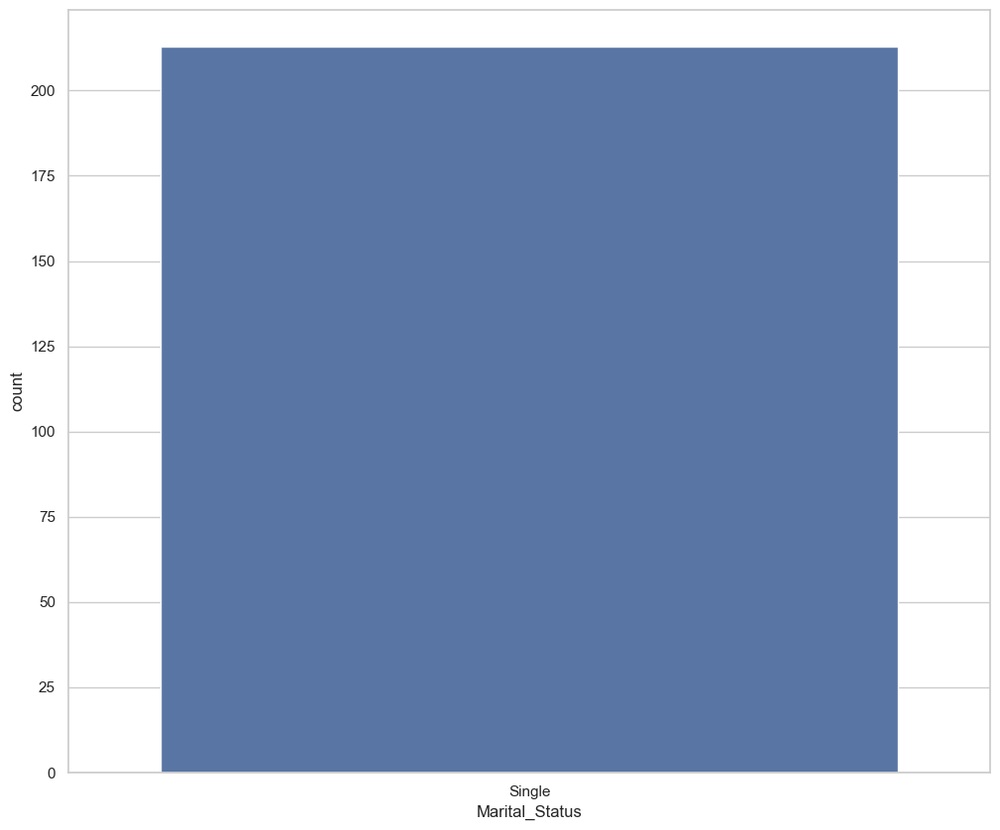

In [87]:
sns.countplot(
    data = df[df["KMeansPCA"] == 2],
    x = "Marital_Status"
)
plt.show()

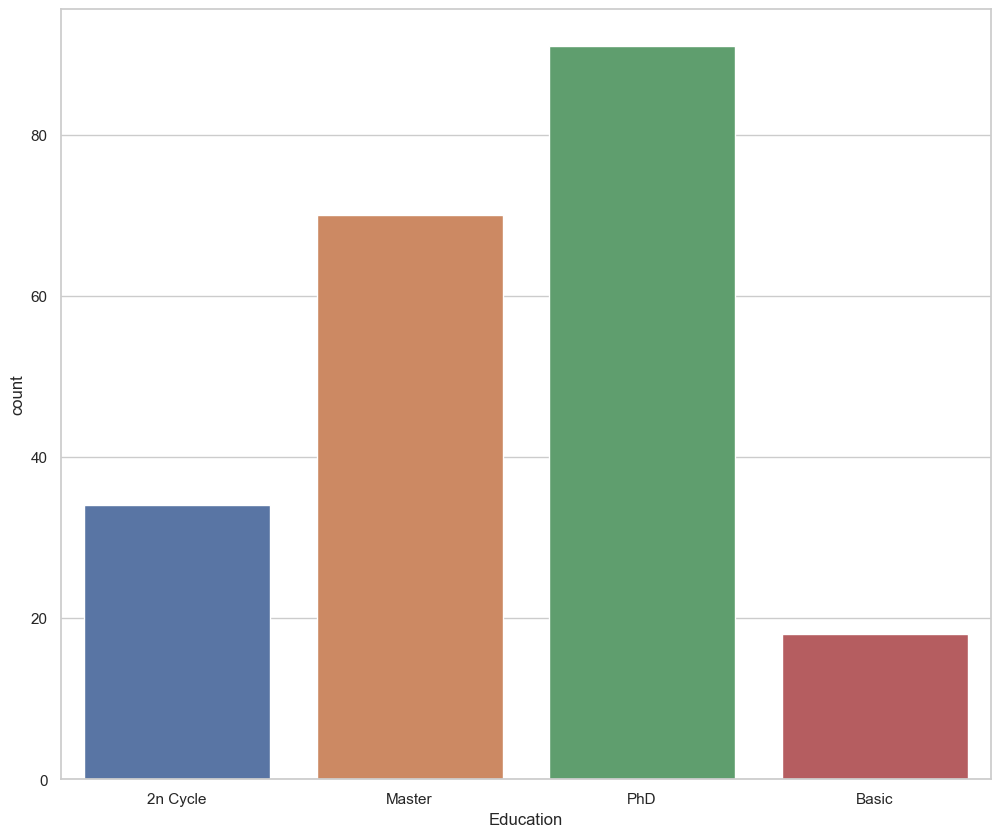

In [88]:
sns.countplot(
    data = df[df["KMeansPCA"] == 2],
    x = "Education"
)
plt.show()

Vemos que este grupo está formado únicamente por solteros pero con distintos niveles educativos.

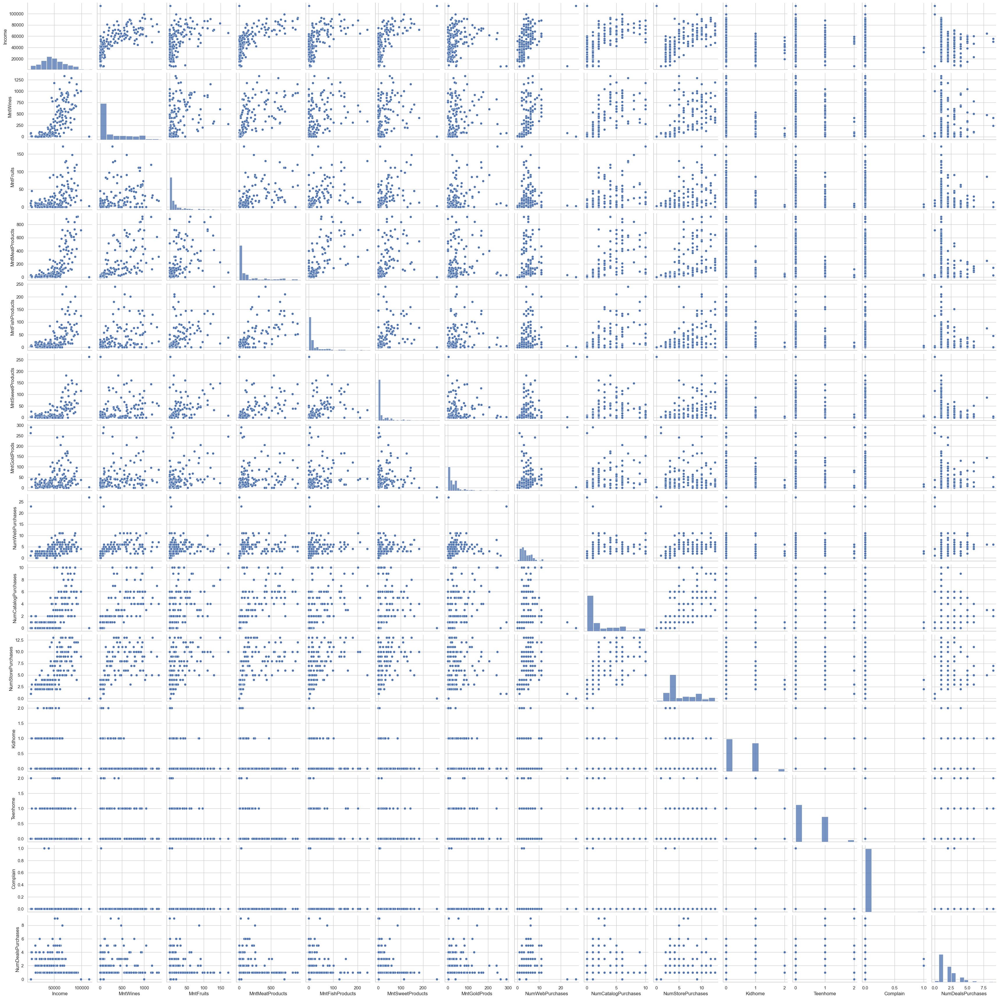

In [89]:
sns.pairplot(
    data = df[df["KMeansPCA"] == 2],
    vars = numVars 
)
plt.show()

No parecen haber muchas diferencias en cuanto a la correlación de las variables.

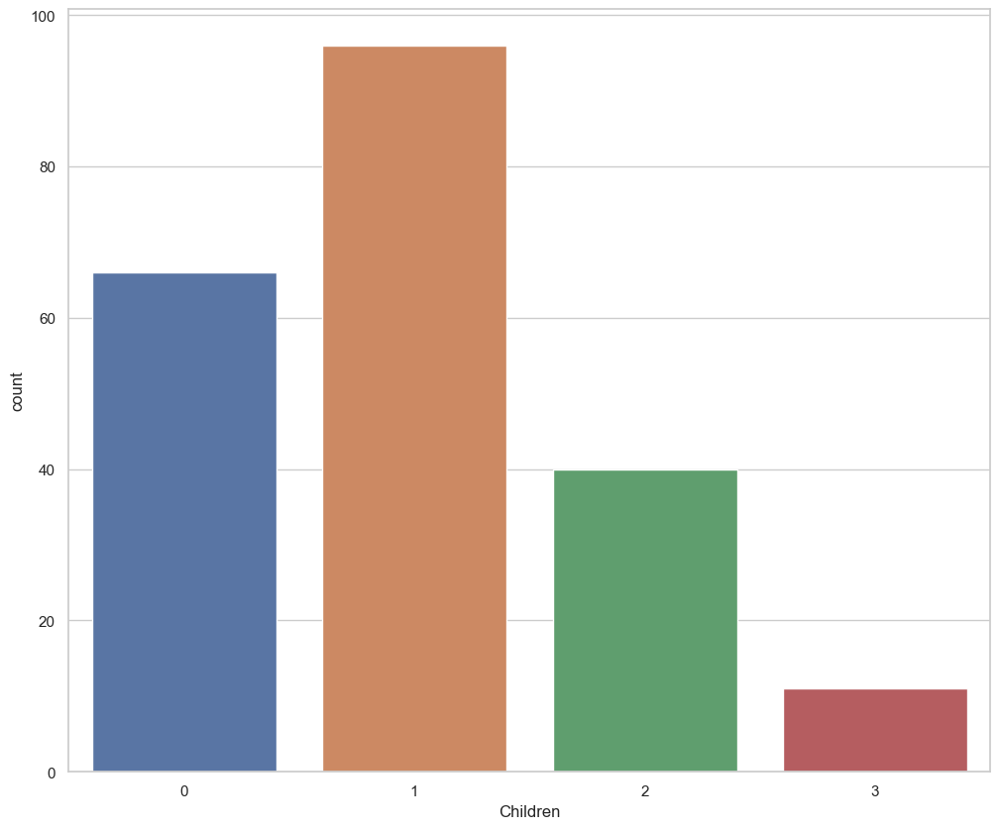

In [90]:
sns.countplot(
    data = df[df["KMeansPCA"] == 2],
    x = "Children"
)
plt.show()

Vemos que la gran mayoría tiene un solo hijo, seguido de ningún hijo.

In [91]:
# Resumen estadístico de las variables numéricas de interés
df[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000
mean,52232.510850,305.030741,26.324593,166.970163,37.516275,27.047468,43.822333,4.083183,2.668174,5.800181,0.442586,0.505425,0.009494,2.321429
std,25187.455359,337.611255,39.781794,224.344950,54.558673,41.092454,51.623472,2.741930,2.924378,3.253616,0.537052,0.544258,0.096994,1.923511
min,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,35233.500000,23.750000,1.750000,16.000000,3.000000,1.000000,9.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,51381.500000,173.500000,8.000000,68.000000,12.000000,8.000000,24.000000,4.000000,2.000000,5.000000,0.000000,0.000000,0.000000,2.000000
75%,68522.000000,505.500000,33.000000,232.250000,50.000000,33.000000,56.000000,6.000000,4.000000,8.000000,1.000000,1.000000,0.000000,3.000000
max,666666.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,321.000000,27.000000,28.000000,13.000000,2.000000,2.000000,1.000000,15.000000


In [92]:
df2 = df[df["KMeansPCA"] == 2]
df2[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,213.000000,213.000000,213.000000,213.000000,213.000000,213.000000,213.000000,213.000000,213.000000,213.000000,213.000000,213.000000,213.000000,213.000000
mean,48387.521127,281.615023,19.441315,150.234742,28.478873,22.169014,34.816901,3.737089,2.267606,5.413146,0.530516,0.450704,0.009390,2.103286
std,21114.072571,346.843995,31.103033,226.856599,45.816037,38.806238,47.870199,3.207654,2.650869,3.320635,0.578921,0.552577,0.096672,1.504283
min,6560.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,33316.000000,19.000000,1.000000,12.000000,2.000000,1.000000,6.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,46098.000000,80.000000,6.000000,35.000000,8.000000,5.000000,18.000000,3.000000,1.000000,4.000000,0.000000,0.000000,0.000000,2.000000
75%,63159.000000,534.000000,22.000000,157.000000,33.000000,28.000000,40.000000,5.000000,4.000000,8.000000,1.000000,1.000000,0.000000,3.000000
max,113734.000000,1332.000000,172.000000,921.000000,240.000000,262.000000,291.000000,27.000000,10.000000,13.000000,2.000000,2.000000,1.000000,9.000000


Este grupo tiene un promedio de ingresos ligeramente inferior al igual que el gasto en todos los productos.

### Grupo 3

Vamos a analizar el grupo 3.

In [93]:
df[df["KMeansPCA"] == 3]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,Z_CostContact,Z_Revenue,Response,KMeansPCA,KMeansNoPCA,hcPCA,hcNoPCA,dbscanPCA,dbscanNoPCA,Children
2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,426,...,3,11,0,3,2,6,8,2,1,0
3,6182,1984,Graduation,Together,26646.0,1,0,2014-02-10,26,11,...,3,11,0,3,2,6,8,2,1,1
17,4939,1946,Graduation,Together,37760.0,0,0,2012-08-31,20,84,...,3,11,0,3,2,6,8,2,1,0
24,1409,1951,Graduation,Together,40689.0,0,1,2013-03-18,69,270,...,3,11,0,3,2,6,8,2,1,1
32,5710,1970,Graduation,Together,40548.0,0,1,2012-10-10,31,110,...,3,11,0,3,2,6,8,-1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2215,692,1954,Graduation,Together,36807.0,1,1,2012-12-20,88,4,...,3,11,0,3,2,6,8,2,1,2
2216,736,1983,Graduation,Together,28427.0,1,0,2013-03-21,67,18,...,3,11,0,3,2,6,8,2,1,1
2218,4838,1978,Graduation,Together,22775.0,1,0,2013-06-19,40,5,...,3,11,0,3,2,6,8,2,1,1
2225,4749,1968,Graduation,Together,58554.0,1,1,2012-09-26,55,368,...,3,11,0,3,2,6,8,2,1,2


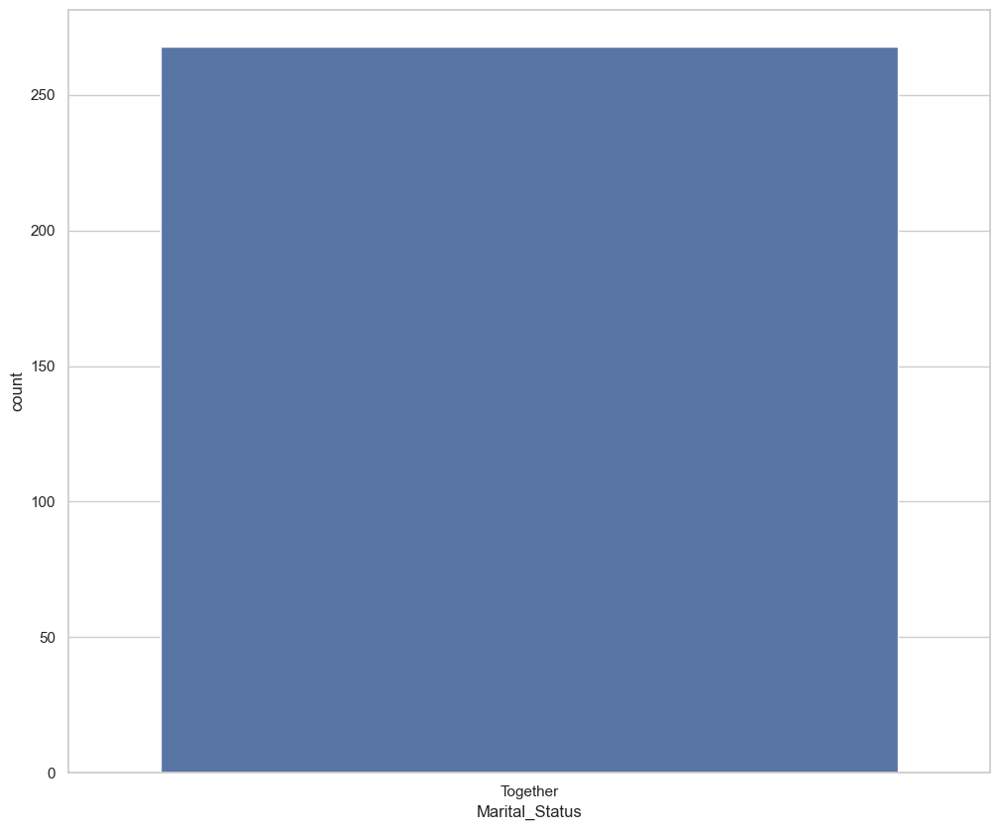

In [94]:
sns.countplot(
    data = df[df["KMeansPCA"] == 3],
    x = "Marital_Status"
)
plt.show()

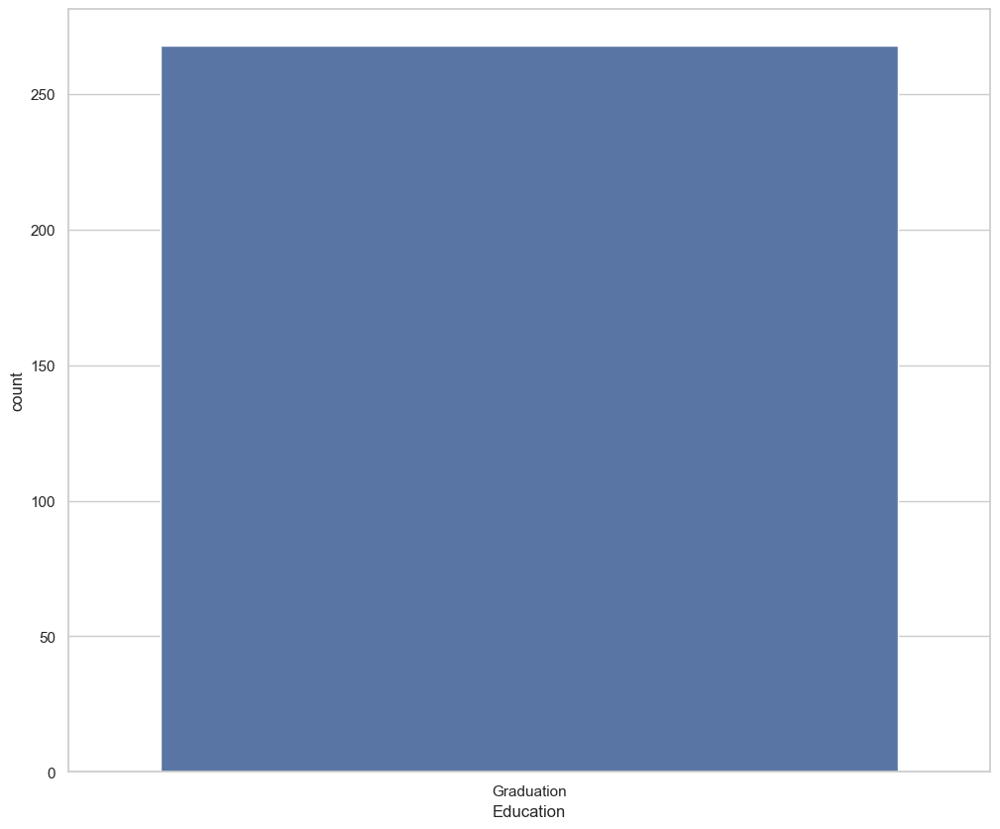

In [95]:
sns.countplot(
    data = df[df["KMeansPCA"] == 3],
    x = "Education"
)
plt.show()

Vemos que este grupo está formado únicamente por personas pareja y graduados.

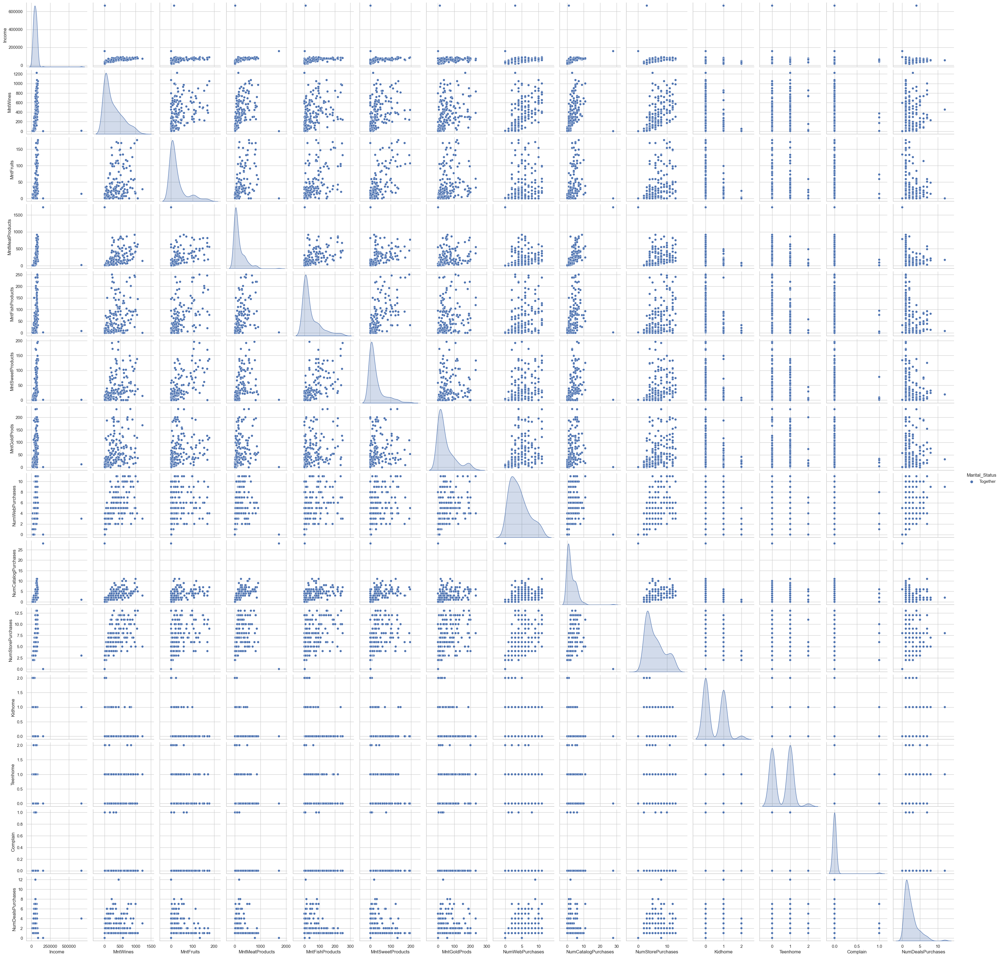

In [96]:
sns.pairplot(
    data = df[df["KMeansPCA"] == 3],
    hue = "Marital_Status",
    vars = numVars 
)
plt.show()

No parecen haber muchas diferencias en cuanto a la correlación de las variables.

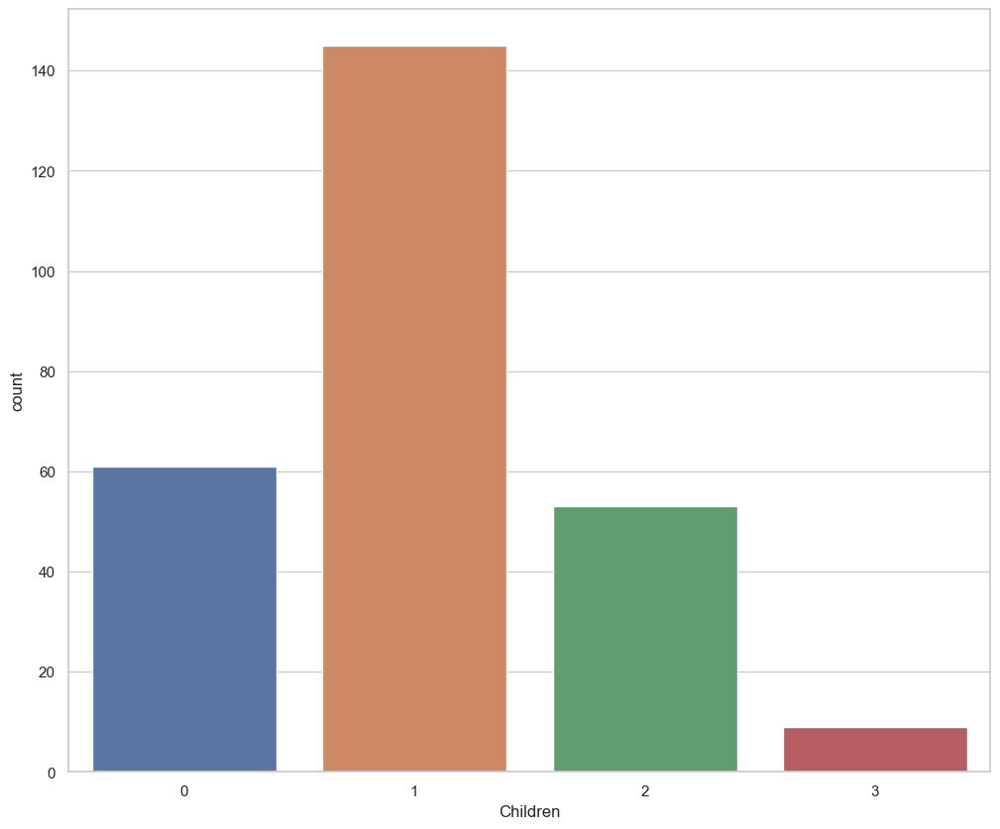

In [97]:
sns.countplot(
    data = df[df["KMeansPCA"] == 3],
    x = "Children"
)
plt.show()

Vemos que la gran mayoría tiene un solo hijo.

In [98]:
# Resumen estadístico de las variables numéricas de interés
df[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000
mean,52232.510850,305.030741,26.324593,166.970163,37.516275,27.047468,43.822333,4.083183,2.668174,5.800181,0.442586,0.505425,0.009494,2.321429
std,25187.455359,337.611255,39.781794,224.344950,54.558673,41.092454,51.623472,2.741930,2.924378,3.253616,0.537052,0.544258,0.096994,1.923511
min,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,35233.500000,23.750000,1.750000,16.000000,3.000000,1.000000,9.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,51381.500000,173.500000,8.000000,68.000000,12.000000,8.000000,24.000000,4.000000,2.000000,5.000000,0.000000,0.000000,0.000000,2.000000
75%,68522.000000,505.500000,33.000000,232.250000,50.000000,33.000000,56.000000,6.000000,4.000000,8.000000,1.000000,1.000000,0.000000,3.000000
max,666666.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,321.000000,27.000000,28.000000,13.000000,2.000000,2.000000,1.000000,15.000000


In [99]:
df3 = df[df["KMeansPCA"] == 3]
df3[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,268.000000,268.000000,268.000000,268.000000,268.000000,268.000000,268.000000,268.000000,268.000000,268.000000,268.000000,268.000000,268.000000,268.000000
mean,53924.305970,271.104478,27.791045,165.264925,41.160448,27.167910,48.481343,4.167910,2.522388,5.794776,0.492537,0.544776,0.014925,2.410448
std,42644.092676,288.684288,40.590875,223.374178,57.183393,39.132419,54.704549,2.853111,2.935554,3.188059,0.557499,0.542096,0.121481,1.840911
min,13672.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,35290.500000,19.000000,2.000000,17.000000,3.000000,2.000000,9.750000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,51342.000000,179.500000,9.500000,68.500000,12.000000,8.000000,28.000000,4.000000,1.000000,5.000000,0.000000,1.000000,0.000000,2.000000
75%,68280.250000,452.250000,33.000000,235.250000,63.000000,32.000000,74.250000,6.000000,4.000000,8.000000,1.000000,1.000000,0.000000,3.000000
max,666666.000000,1224.000000,178.000000,1725.000000,250.000000,196.000000,233.000000,11.000000,28.000000,13.000000,2.000000,2.000000,1.000000,12.000000


Este grupo tiene unos promedios de consumo para frutas, el pescado y el oro ligeramente superiores al promedio general; en el resto de bariables están ligeramente por debajo.

### Grupo 4

Vamos a analizar el grupo 4.

In [100]:
df[df["KMeansPCA"] == 4]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,Z_CostContact,Z_Revenue,Response,KMeansPCA,KMeansNoPCA,hcPCA,hcNoPCA,dbscanPCA,dbscanNoPCA,Children
4,5324,1981,PhD,Married,58293.0,1,0,2014-01-19,94,173,...,3,11,0,4,3,7,6,3,2,1
7,6177,1985,PhD,Married,33454.0,1,0,2013-05-08,32,76,...,3,11,0,4,3,7,6,3,2,1
22,1993,1949,PhD,Married,58607.0,0,1,2012-12-23,63,867,...,3,11,0,4,3,7,6,-1,2,1
23,4047,1954,PhD,Married,65324.0,0,1,2014-01-11,0,384,...,3,11,0,4,3,7,6,3,2,1
29,1966,1965,PhD,Married,84618.0,0,0,2013-11-22,96,684,...,3,11,0,4,3,7,6,-1,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2158,5186,1955,PhD,Married,58482.0,0,1,2014-03-12,59,576,...,3,11,0,4,3,7,6,-1,2,1
2160,5667,1964,PhD,Married,60896.0,0,1,2012-10-11,90,1013,...,3,11,1,4,3,7,6,-1,2,1
2181,8858,1972,PhD,Married,44325.0,0,1,2013-03-07,69,516,...,3,11,0,4,3,7,6,-1,2,1
2187,5721,1956,PhD,Married,84117.0,0,0,2014-05-11,60,611,...,3,11,0,4,3,7,6,-1,2,0


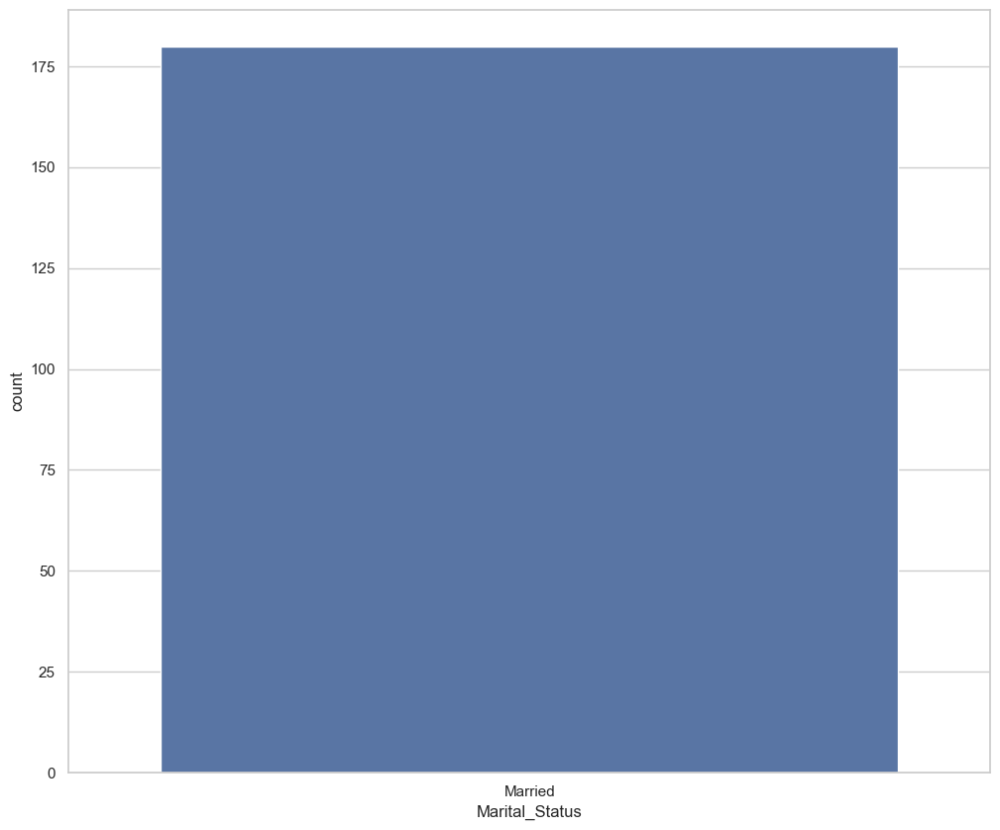

In [101]:
sns.countplot(
    data = df[df["KMeansPCA"] == 4],
    x = "Marital_Status"
)
plt.show()

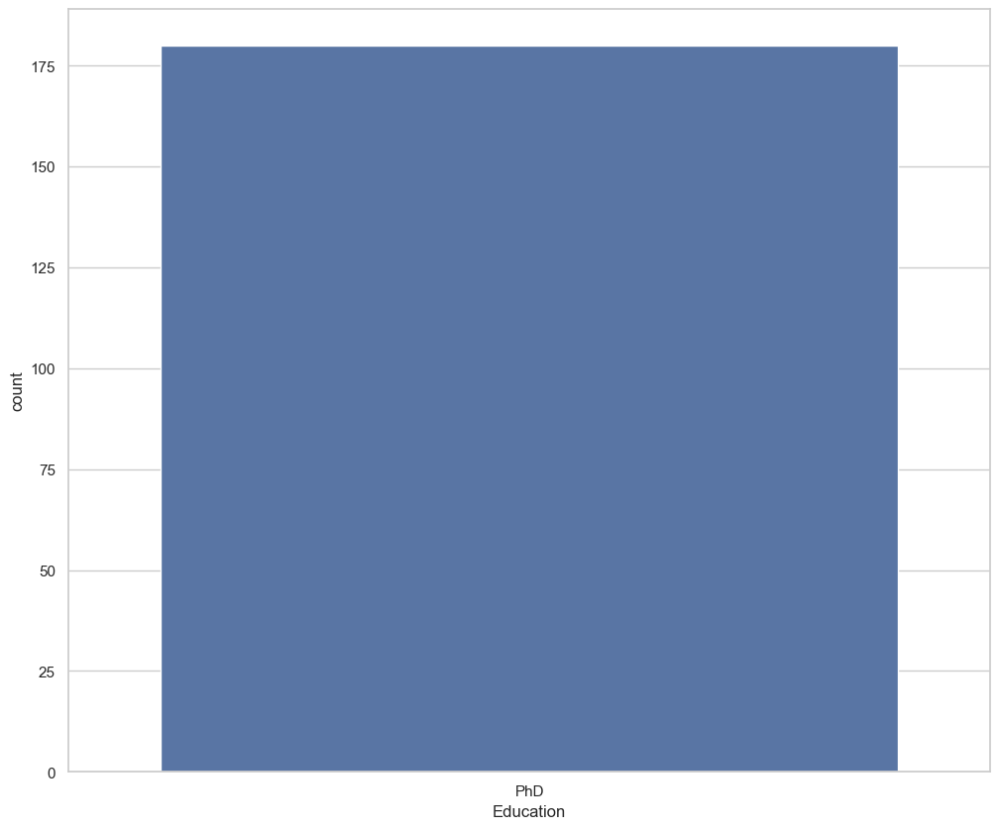

In [102]:
sns.countplot(
    data = df[df["KMeansPCA"] == 4],
    x = "Education"
)
plt.show()

Vemos que este grupo está formado únicamente por personas con PhD y casados.

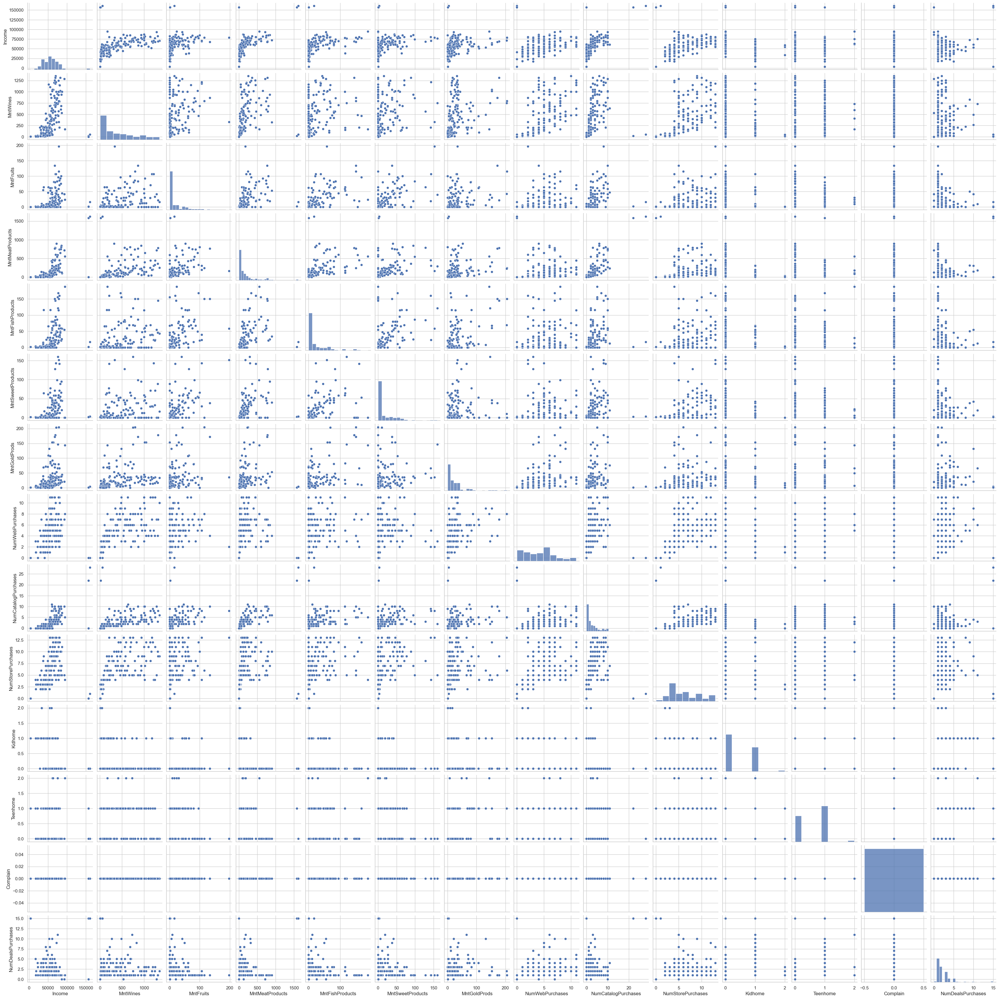

In [103]:
sns.pairplot(
    data = df[df["KMeansPCA"] == 4],
    vars = numVars 
)
plt.show()

No parecen haber muchas diferencias en cuanto a la correlación de las variables.

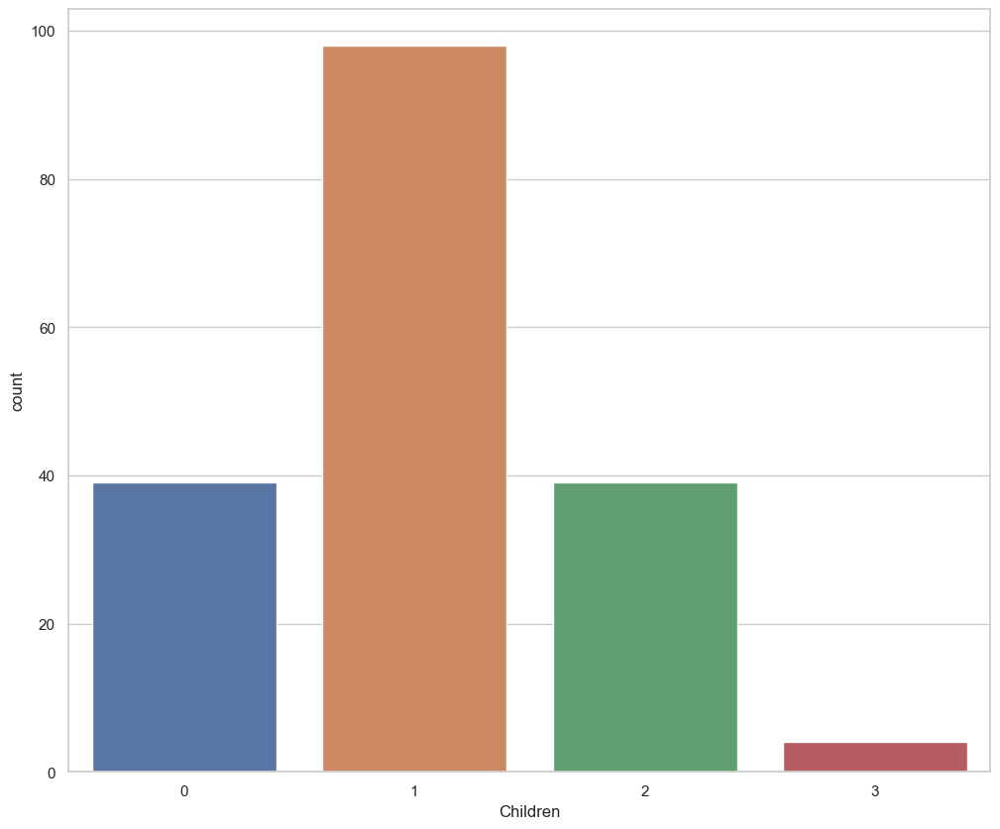

In [104]:
sns.countplot(
    data = df[df["KMeansPCA"] == 4],
    x = "Children"
)
plt.show()

Vemos que la gran mayoría tiene un solo hijo.

In [105]:
# Resumen estadístico de las variables numéricas de interés
df[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000
mean,52232.510850,305.030741,26.324593,166.970163,37.516275,27.047468,43.822333,4.083183,2.668174,5.800181,0.442586,0.505425,0.009494,2.321429
std,25187.455359,337.611255,39.781794,224.344950,54.558673,41.092454,51.623472,2.741930,2.924378,3.253616,0.537052,0.544258,0.096994,1.923511
min,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,35233.500000,23.750000,1.750000,16.000000,3.000000,1.000000,9.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,51381.500000,173.500000,8.000000,68.000000,12.000000,8.000000,24.000000,4.000000,2.000000,5.000000,0.000000,0.000000,0.000000,2.000000
75%,68522.000000,505.500000,33.000000,232.250000,50.000000,33.000000,56.000000,6.000000,4.000000,8.000000,1.000000,1.000000,0.000000,3.000000
max,666666.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,321.000000,27.000000,28.000000,13.000000,2.000000,2.000000,1.000000,15.000000


In [106]:
df4 = df[df["KMeansPCA"] == 4]
df4[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,180.000000,180.000000,180.000000,180.000000,180.000000,180.000000,180.000000,180.000000,180.000000,180.000000,180.000000,180.000000,180.0,180.000000
mean,56832.488889,402.427778,21.077778,172.855556,25.777778,18.988889,29.061111,4.394444,3.050000,6.172222,0.433333,0.611111,0.0,2.594444
std,21681.600319,391.820134,33.178282,259.637438,40.564254,31.146794,40.476514,2.797639,3.672752,3.352362,0.540019,0.532611,0.0,2.460179
min,4023.000000,2.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
25%,41112.250000,54.500000,0.000000,18.750000,0.000000,0.000000,4.000000,2.000000,1.000000,4.000000,0.000000,0.000000,0.0,1.000000
50%,55830.500000,240.000000,4.000000,69.000000,4.000000,3.000000,15.000000,4.000000,2.000000,5.000000,0.000000,1.000000,0.0,2.000000
75%,68612.250000,684.000000,30.000000,200.250000,35.000000,29.250000,35.000000,6.000000,4.000000,9.000000,1.000000,1.000000,0.0,3.000000
max,160803.000000,1349.000000,197.000000,1622.000000,188.000000,160.000000,205.000000,11.000000,28.000000,13.000000,2.000000,2.000000,0.0,15.000000


Este grupo tiene un promedio de gasto en vinos muy por encima del conjunto de datos general; también tiene en promedio mayor gasto en carnes e ingresos, tiene un promedio mucho menor de gasto en dulces y ninguno ha tenido quejas.

### Grupo 5

Vamos a analizar el grupo 5.

In [107]:
df[df["KMeansPCA"] == 5]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,Z_CostContact,Z_Revenue,Response,KMeansPCA,KMeansNoPCA,hcPCA,hcNoPCA,dbscanPCA,dbscanNoPCA,Children
5,7446,1967,Master,Together,62513.0,0,1,2013-09-09,16,520,...,3,11,0,5,8,1,11,4,3,1
13,8180,1952,Master,Divorced,59354.0,1,1,2013-11-15,53,233,...,3,11,0,5,8,0,2,7,7,2
30,6864,1989,Master,Divorced,10979.0,0,0,2014-05-22,34,8,...,3,11,0,5,8,0,2,7,7,0
31,3033,1963,Master,Together,38620.0,0,0,2013-05-11,56,112,...,3,11,0,5,8,1,11,4,3,0
83,4119,1963,Master,Together,38620.0,0,0,2013-05-11,56,112,...,3,11,0,5,8,1,11,4,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2176,1544,1967,Master,Divorced,81380.0,0,0,2012-12-22,51,741,...,3,11,0,5,8,0,2,7,7,0
2188,10652,1957,Master,Together,65487.0,0,0,2014-01-10,48,240,...,3,11,0,5,8,1,11,4,3,0
2212,6983,1950,Master,Divorced,38054.0,1,1,2014-05-01,24,23,...,3,11,0,5,8,0,2,7,7,2
2219,9246,1985,Master,Together,40101.0,1,0,2012-10-14,73,171,...,3,11,0,5,8,1,11,4,3,1


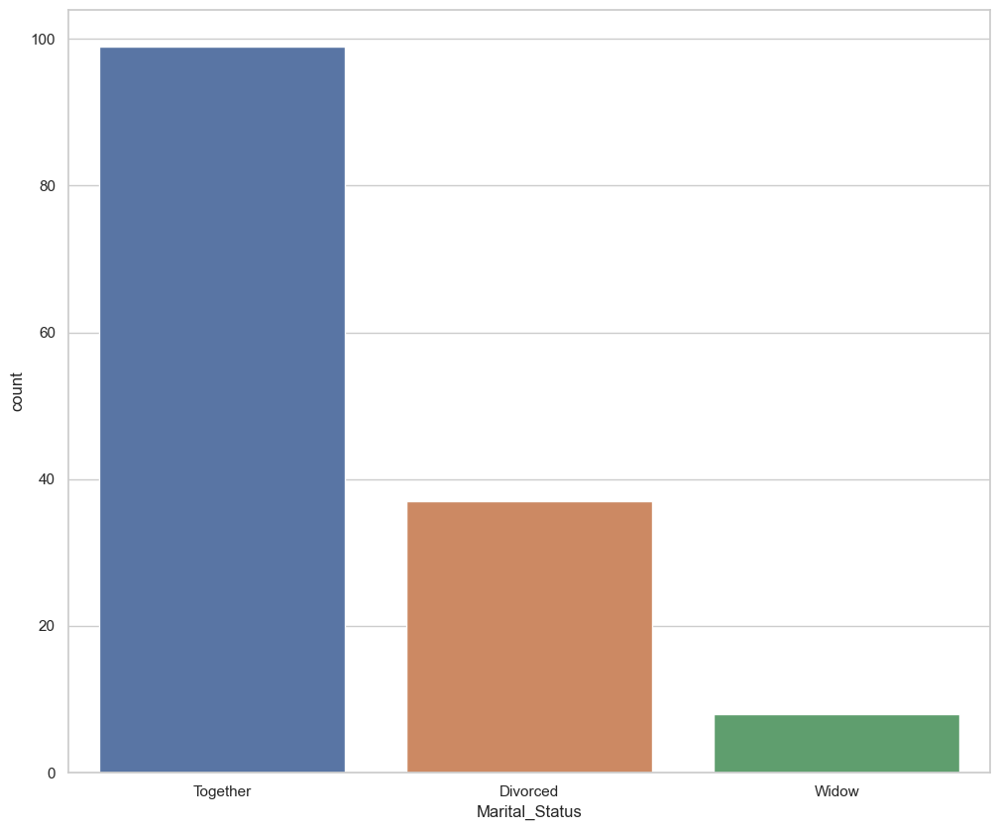

In [108]:
sns.countplot(
    data = df[df["KMeansPCA"] == 5],
    x = "Marital_Status"
)
plt.show()

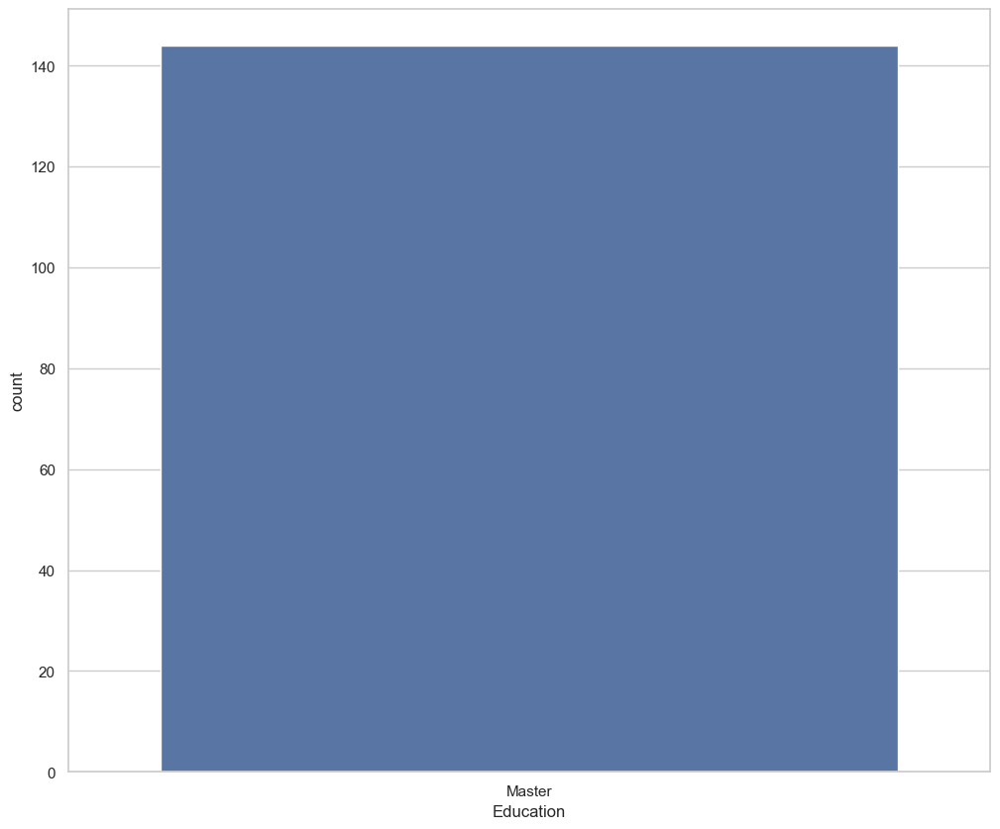

In [109]:
sns.countplot(
    data = df[df["KMeansPCA"] == 5],
    x = "Education"
)
plt.show()

Vemos que este grupo está formado únicamente por personas con maestría en su mayoría con pareja pero hay algunos viudos.

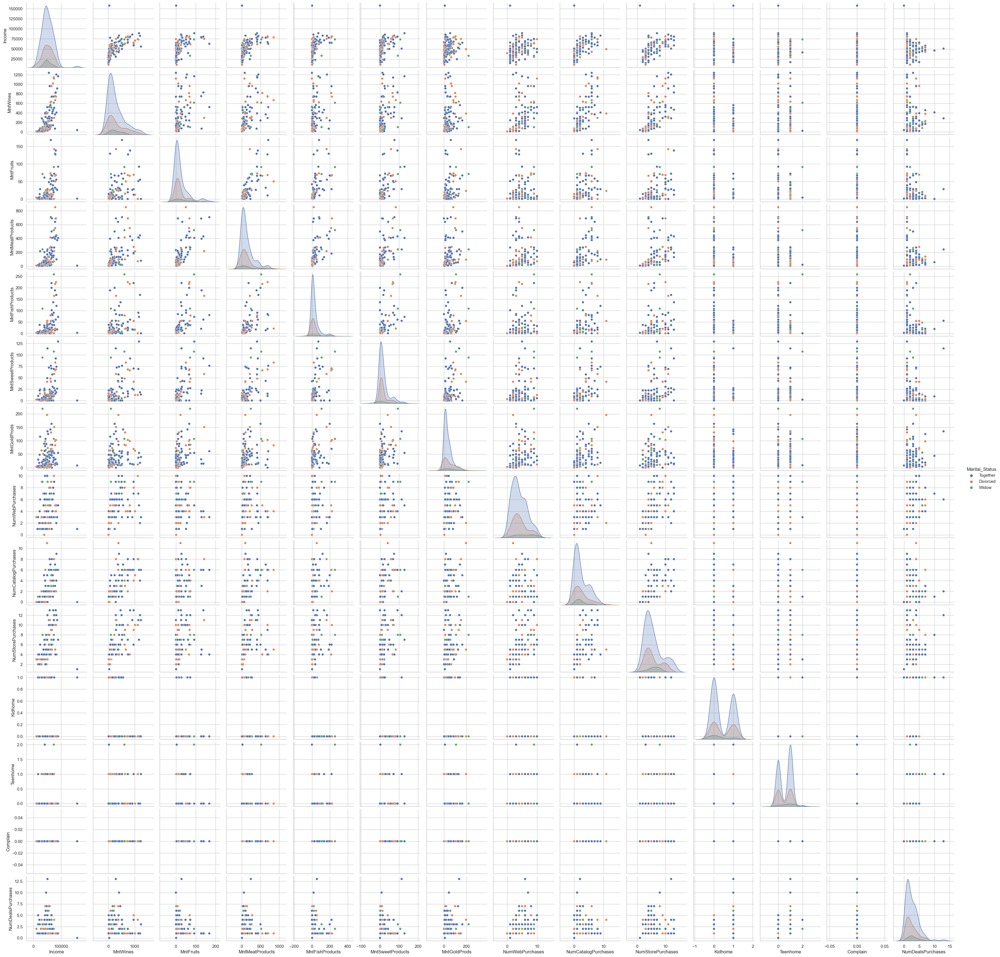

In [110]:
sns.pairplot(
    data = df[df["KMeansPCA"] == 5],
    hue = "Marital_Status",
    vars = numVars 
)
plt.show()

No parecen haber muchas diferencias en cuanto a la correlación de las variables.

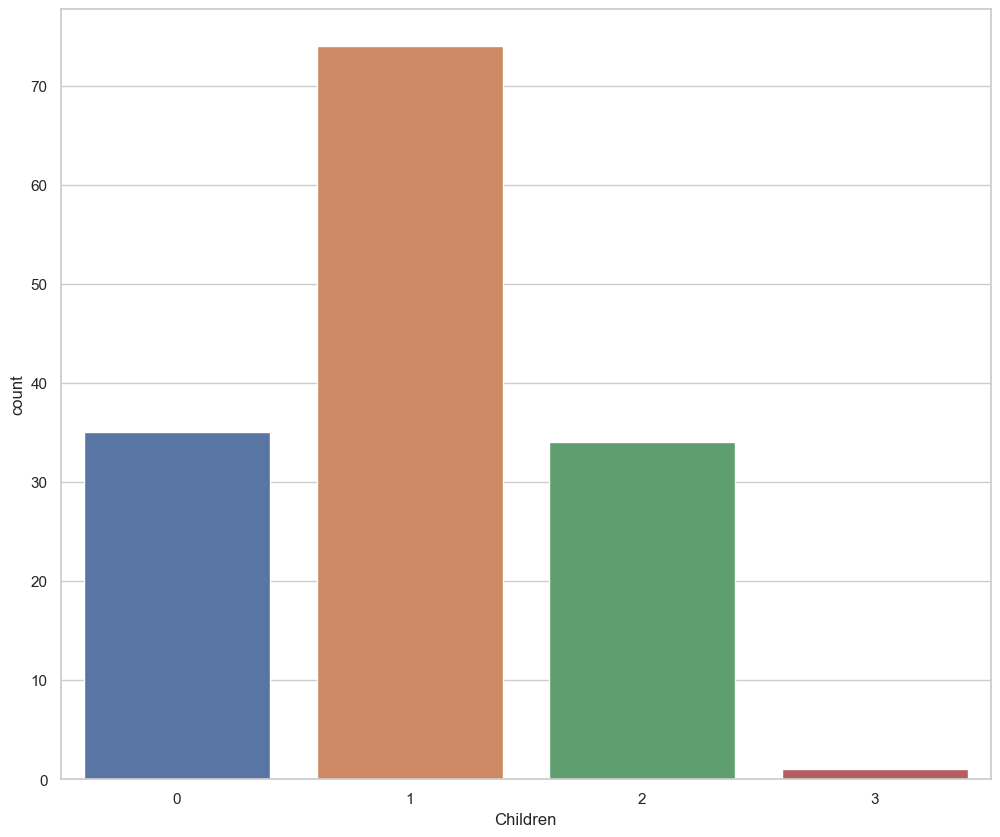

In [111]:
sns.countplot(
    data = df[df["KMeansPCA"] == 5],
    x = "Children"
)
plt.show()

Vemos que la gran mayoría tiene un solo hijo.

In [112]:
# Resumen estadístico de las variables numéricas de interés
df[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000
mean,52232.510850,305.030741,26.324593,166.970163,37.516275,27.047468,43.822333,4.083183,2.668174,5.800181,0.442586,0.505425,0.009494,2.321429
std,25187.455359,337.611255,39.781794,224.344950,54.558673,41.092454,51.623472,2.741930,2.924378,3.253616,0.537052,0.544258,0.096994,1.923511
min,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,35233.500000,23.750000,1.750000,16.000000,3.000000,1.000000,9.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,51381.500000,173.500000,8.000000,68.000000,12.000000,8.000000,24.000000,4.000000,2.000000,5.000000,0.000000,0.000000,0.000000,2.000000
75%,68522.000000,505.500000,33.000000,232.250000,50.000000,33.000000,56.000000,6.000000,4.000000,8.000000,1.000000,1.000000,0.000000,3.000000
max,666666.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,321.000000,27.000000,28.000000,13.000000,2.000000,2.000000,1.000000,15.000000


In [153]:
df5 = df[df["KMeansPCA"] == 5]
df5[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,144.000000,144.000000,144.000000,144.000000,144.000000,144.000000,144.000000,144.000000,144.000000,144.000000,144.000000,144.000000,144.0,144.000000
mean,50976.618056,286.090278,21.173611,133.833333,29.701389,18.104167,38.305556,4.229167,2.347222,5.562500,0.423611,0.583333,0.0,2.625000
std,19670.160525,310.669791,33.019242,173.712044,50.300507,26.688233,42.713434,2.513512,2.410117,2.944044,0.495855,0.522233,0.0,1.985525
min,10979.000000,2.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.0,0.000000
25%,39076.000000,43.500000,2.000000,19.000000,2.000000,2.000000,8.750000,2.000000,1.000000,3.000000,0.000000,0.000000,0.0,1.000000
50%,49098.500000,167.000000,6.500000,62.000000,10.000000,7.000000,19.000000,4.000000,1.000000,5.000000,0.000000,1.000000,0.0,2.000000
75%,63841.000000,435.000000,25.000000,174.000000,34.000000,22.000000,55.250000,6.000000,4.000000,7.000000,1.000000,1.000000,0.0,4.000000
max,157733.000000,1241.000000,168.000000,850.000000,258.000000,129.000000,219.000000,10.000000,11.000000,13.000000,1.000000,2.000000,0.0,13.000000


Este grupo tiene un promedio de gasto menor en todos los productos y ninguno ha tenido quejas.

### Grupo 6

Vamos a analizar el grupo 6.

In [114]:
df[df["KMeansPCA"] == 6]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,Z_CostContact,Z_Revenue,Response,KMeansPCA,KMeansNoPCA,hcPCA,hcNoPCA,dbscanPCA,dbscanNoPCA,Children
6,965,1971,Graduation,Divorced,55635.0,0,1,2012-11-13,34,235,...,3,11,0,6,4,0,2,5,4,1
12,2125,1959,Graduation,Divorced,63033.0,0,0,2013-11-15,82,194,...,3,11,0,6,4,0,2,5,4,0
38,8595,1973,Graduation,Widow,42429.0,0,1,2014-02-11,99,55,...,3,11,0,6,4,9,10,12,14,1
50,8614,1957,Graduation,Widow,65486.0,0,1,2014-05-12,29,245,...,3,11,0,6,4,9,10,12,14,1
56,10383,1966,Graduation,Divorced,70287.0,0,0,2013-04-02,30,295,...,3,11,1,6,4,0,2,-1,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2153,7699,1969,Graduation,Widow,40590.0,1,1,2013-10-02,30,154,...,3,11,0,6,4,9,10,-1,14,2
2166,2429,1954,Graduation,Divorced,72071.0,0,1,2013-02-14,4,531,...,3,11,0,6,4,0,2,5,4,1
2191,2656,1971,Graduation,Divorced,40851.0,1,1,2013-02-21,63,23,...,3,11,0,6,4,0,2,5,4,2
2209,6168,1963,Graduation,Divorced,45146.0,1,1,2013-07-15,28,33,...,3,11,0,6,4,0,2,5,4,2


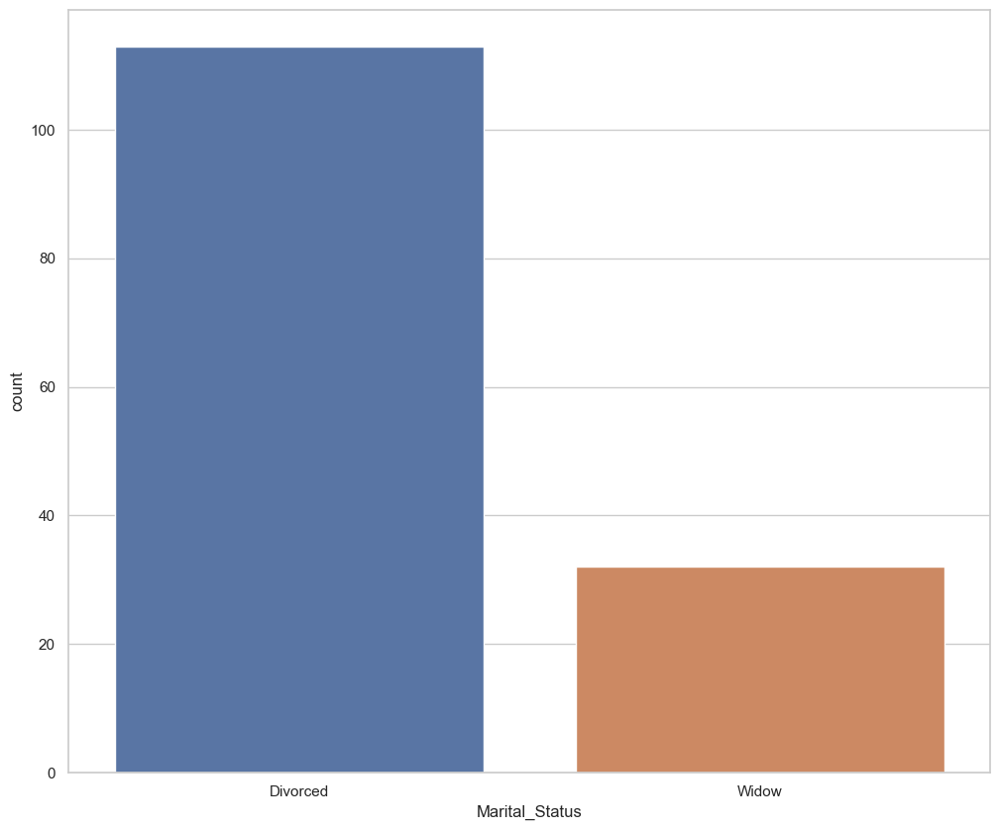

In [115]:
sns.countplot(
    data = df[df["KMeansPCA"] == 6],
    x = "Marital_Status"
)
plt.show()

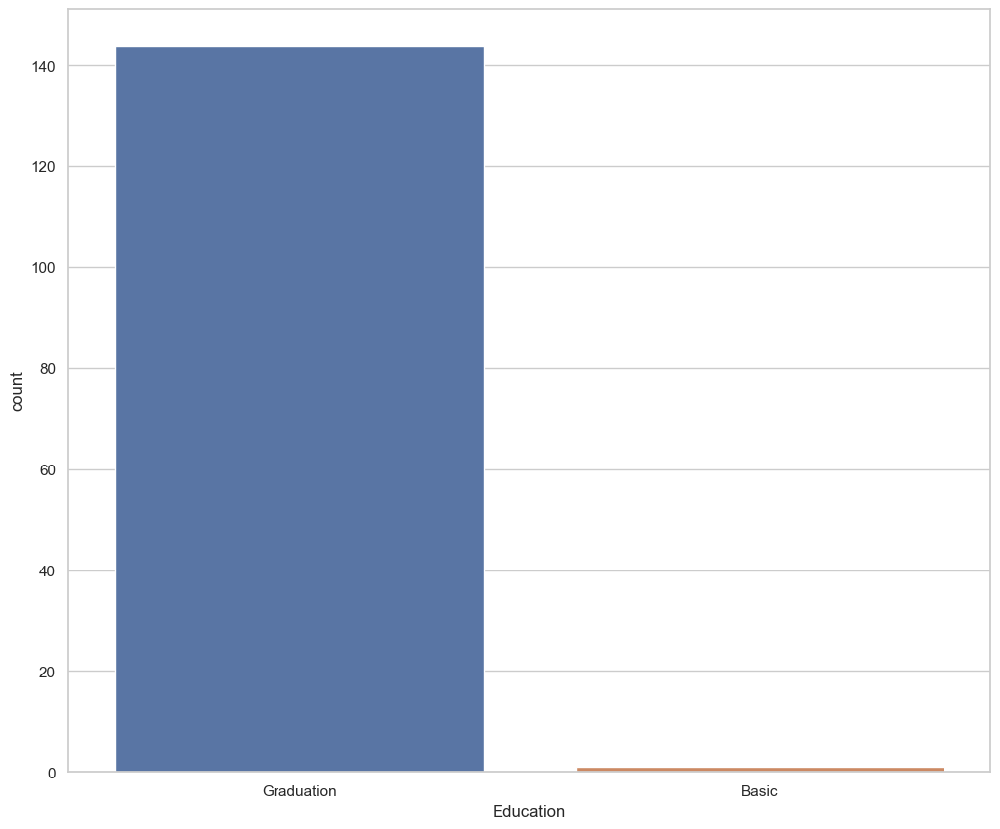

In [116]:
sns.countplot(
    data = df[df["KMeansPCA"] == 6],
    x = "Education"
)
plt.show()

Vemos que este grupo está formado mayoritariamente por personas graduadas; en cuanto al estado civil la mayoría son divorciados pero también hay viudos.

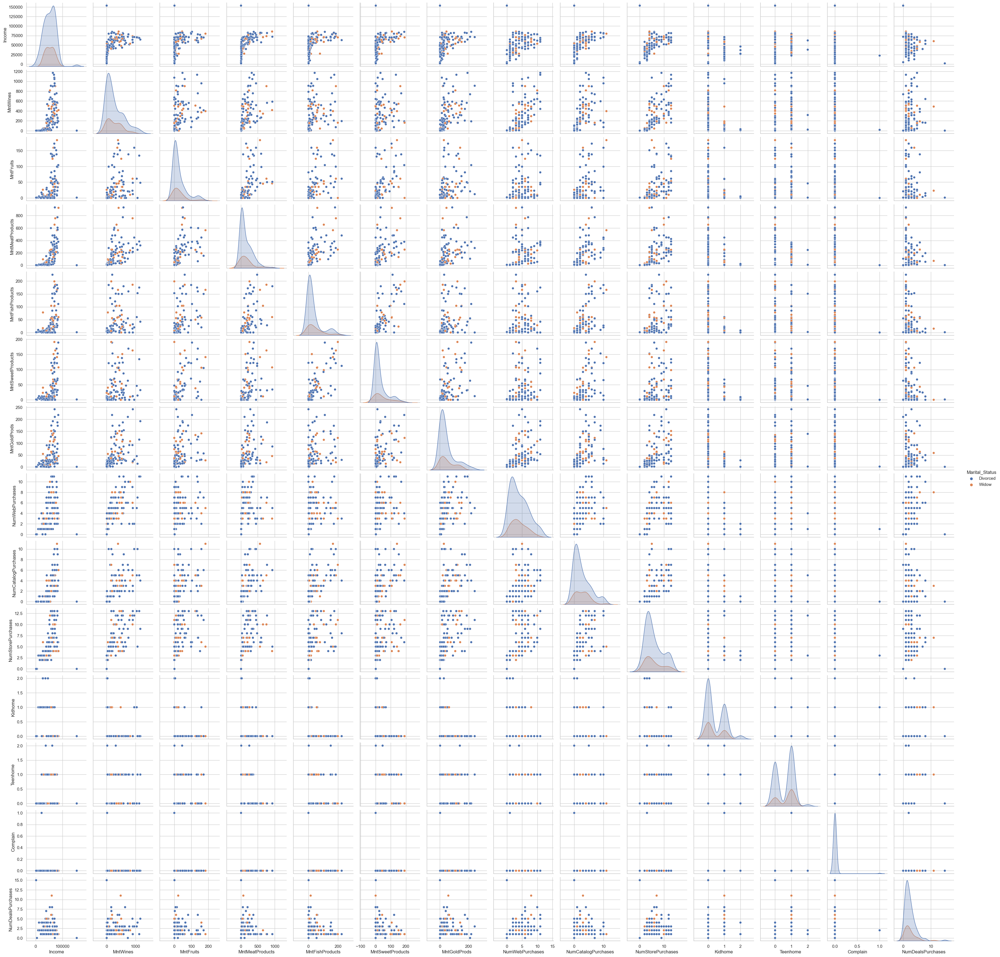

In [117]:
sns.pairplot(
    data = df[df["KMeansPCA"] == 6],
    hue = "Marital_Status",
    vars = numVars 
)
plt.show()

No parecen haber muchas diferencias en cuanto a la correlación de las variables.

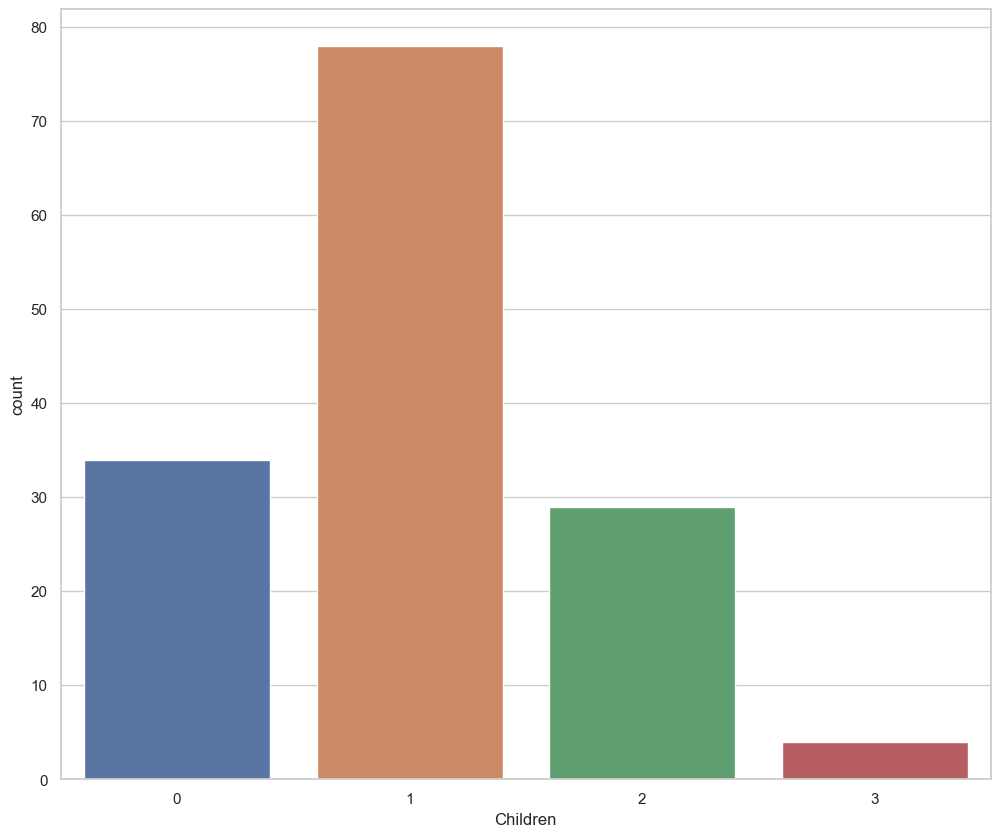

In [118]:
sns.countplot(
    data = df[df["KMeansPCA"] == 6],
    x = "Children"
)
plt.show()

Vemos que la gran mayoría tiene un solo hijo.

In [ ]:
# Resumen estadístico de las variables numéricas de interés
df[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000
mean,52232.510850,305.030741,26.324593,166.970163,37.516275,27.047468,43.822333,4.083183,2.668174,5.800181,0.442586,0.505425,0.009494,2.321429
std,25187.455359,337.611255,39.781794,224.344950,54.558673,41.092454,51.623472,2.741930,2.924378,3.253616,0.537052,0.544258,0.096994,1.923511
min,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,35233.500000,23.750000,1.750000,16.000000,3.000000,1.000000,9.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,51381.500000,173.500000,8.000000,68.000000,12.000000,8.000000,24.000000,4.000000,2.000000,5.000000,0.000000,0.000000,0.000000,2.000000
75%,68522.000000,505.500000,33.000000,232.250000,50.000000,33.000000,56.000000,6.000000,4.000000,8.000000,1.000000,1.000000,0.000000,3.000000
max,666666.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,321.000000,27.000000,28.000000,13.000000,2.000000,2.000000,1.000000,15.000000


In [119]:
df6 = df[df["KMeansPCA"] == 6]
df6[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,145.000000,145.000000,145.000000,145.000000,145.000000,145.000000,145.000000,145.000000,145.000000,145.000000,145.000000,145.000000,145.000000,145.000000
mean,52369.565517,264.275862,28.275862,154.462069,36.075862,32.310345,47.986207,4.062069,2.600000,5.765517,0.406897,0.613793,0.006897,2.393103
std,21154.600916,289.283297,41.857477,194.557333,52.969735,46.741089,54.583141,2.870397,2.759831,3.559053,0.546409,0.516212,0.083045,2.014863
min,1730.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,37244.000000,19.000000,1.000000,12.000000,2.000000,1.000000,9.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,53034.000000,163.000000,8.000000,65.000000,10.000000,10.000000,27.000000,3.000000,2.000000,4.000000,0.000000,1.000000,0.000000,2.000000
75%,68274.000000,445.000000,35.000000,239.000000,46.000000,46.000000,64.000000,6.000000,4.000000,8.000000,1.000000,1.000000,0.000000,3.000000
max,153924.000000,1170.000000,183.000000,932.000000,225.000000,191.000000,242.000000,11.000000,11.000000,13.000000,2.000000,2.000000,1.000000,15.000000


Este grupo tiene unos gastos muy cercanos al promedio y no destaca mucho.

### Grupo 7

Vamos a analizar el grupo 7.

In [120]:
df[df["KMeansPCA"] == 7]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,Z_CostContact,Z_Revenue,Response,KMeansPCA,KMeansNoPCA,hcPCA,hcNoPCA,dbscanPCA,dbscanNoPCA,Children
18,6565,1949,Master,Married,76995.0,0,1,2013-03-28,91,1012,...,3,11,0,7,8,11,7,-1,9,1
34,8755,1946,Master,Married,68657.0,0,0,2013-02-20,4,482,...,3,11,0,7,8,11,7,10,9,0
41,503,1985,Master,Married,20559.0,1,0,2013-03-12,88,13,...,3,11,0,7,8,11,7,10,9,1
44,2139,1975,Master,Married,7500.0,1,0,2013-10-02,19,3,...,3,11,0,7,8,11,7,10,9,1
51,4114,1964,Master,Married,79143.0,0,0,2012-08-11,2,650,...,3,11,0,7,8,11,7,10,9,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2108,5991,1949,Master,Married,48150.0,0,1,2013-06-08,24,173,...,3,11,0,7,8,11,7,10,9,1
2114,1916,1954,Master,Married,45736.0,0,1,2013-07-24,92,188,...,3,11,0,7,8,11,7,10,9,1
2150,6950,1958,Master,Married,49572.0,1,1,2013-12-15,25,35,...,3,11,0,7,8,11,7,10,9,2
2186,2666,1972,Master,Married,76234.0,0,1,2014-02-06,21,519,...,3,11,0,7,8,11,7,-1,9,1


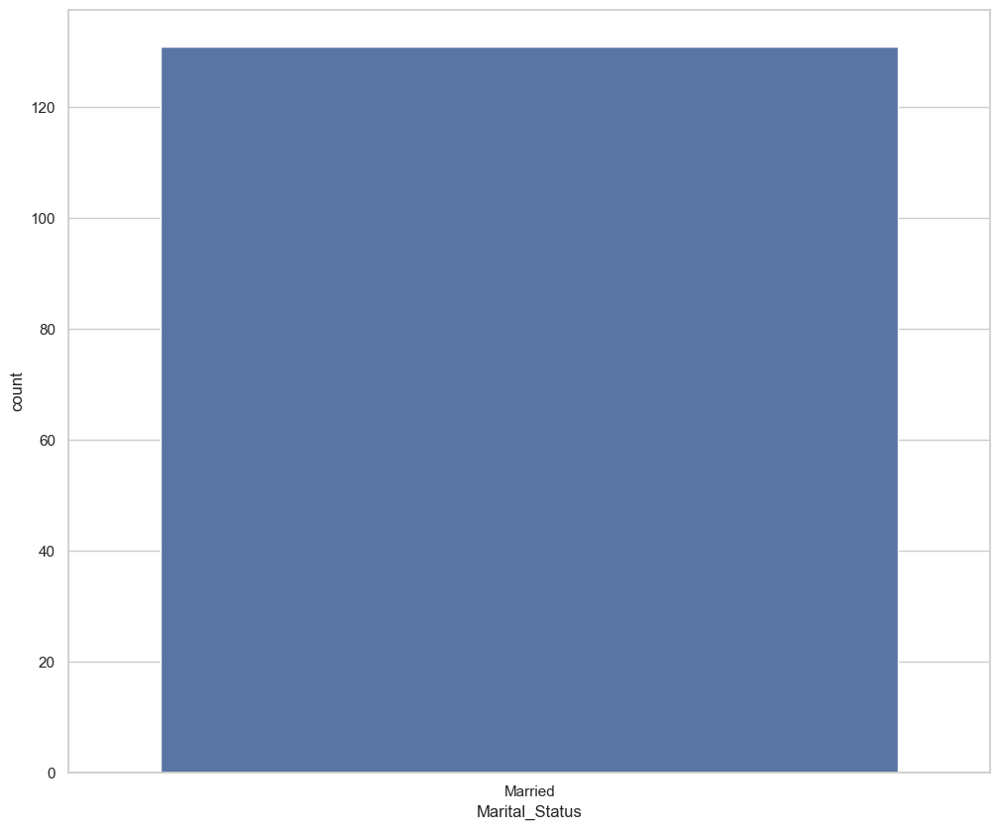

In [121]:
sns.countplot(
    data = df[df["KMeansPCA"] == 7],
    x = "Marital_Status"
)
plt.show()

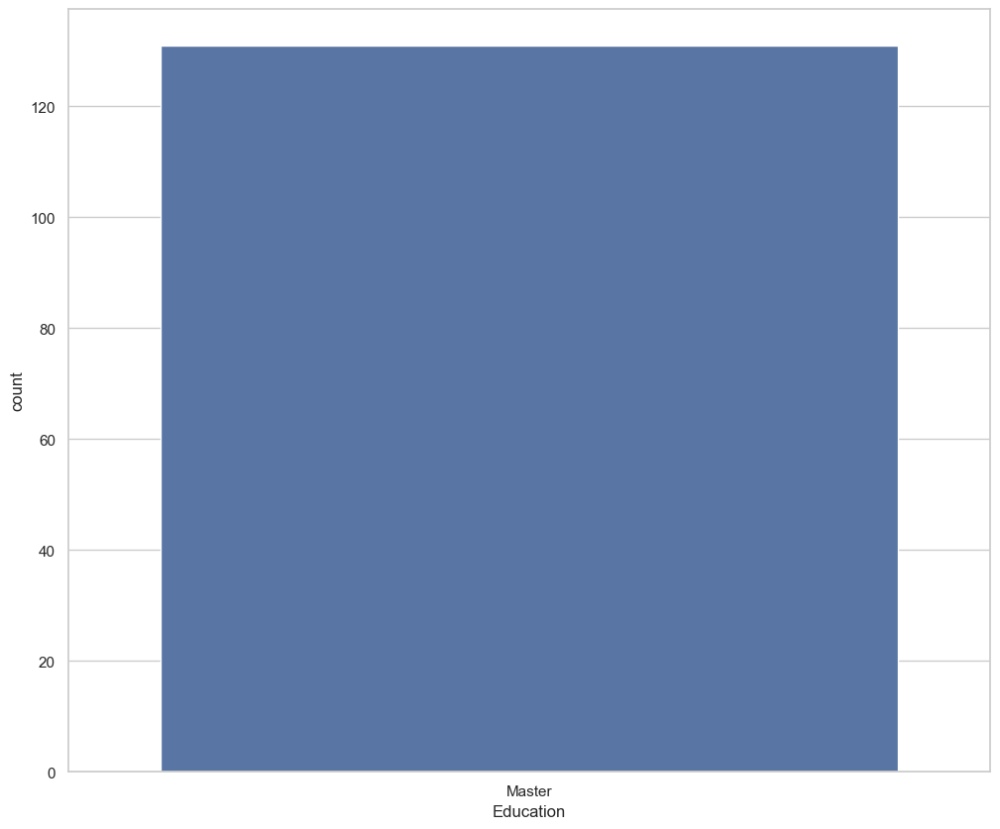

In [122]:
sns.countplot(
    data = df[df["KMeansPCA"] == 7],
    x = "Education"
)
plt.show()

Vemos que este grupo está formado únicamente por personas con maestría y casados.

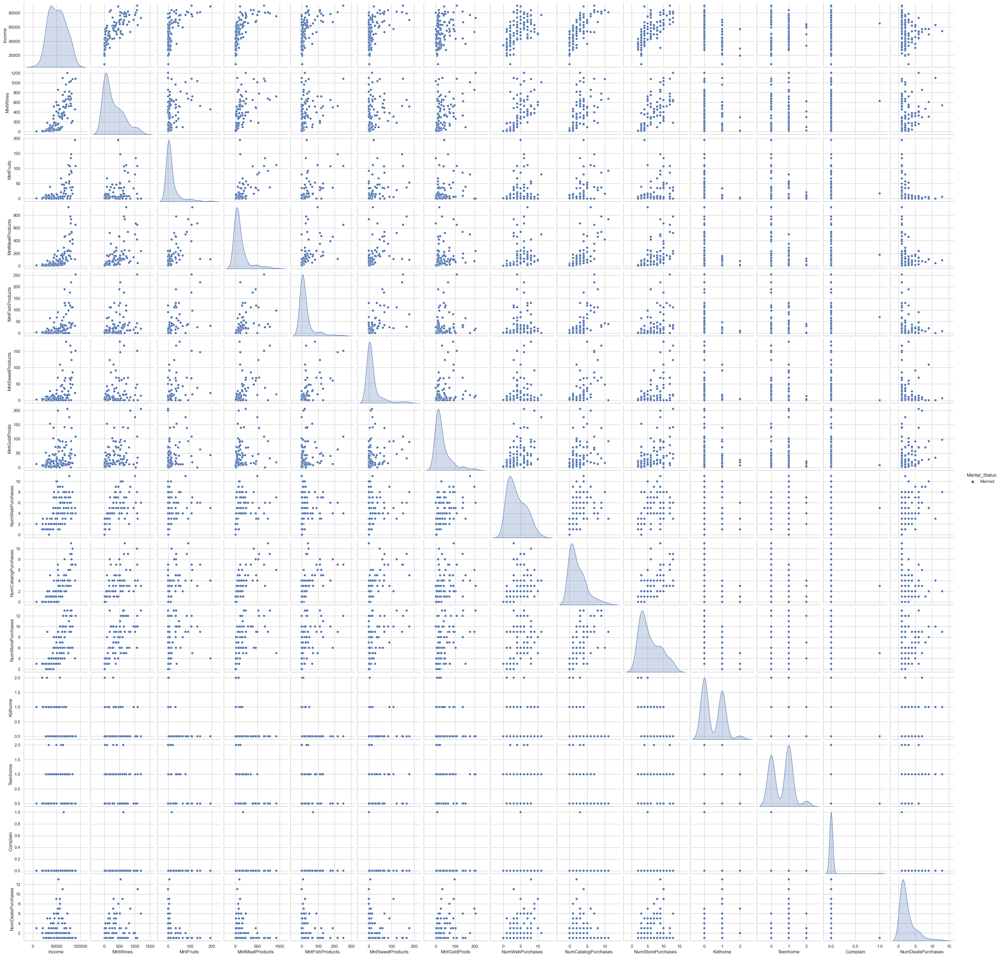

In [127]:
sns.pairplot(
    data = df[df["KMeansPCA"] == 7],
    hue = "Marital_Status",
    vars = numVars 
)
plt.show()

No parecen haber muchas diferencias en cuanto a la correlación de las variables.

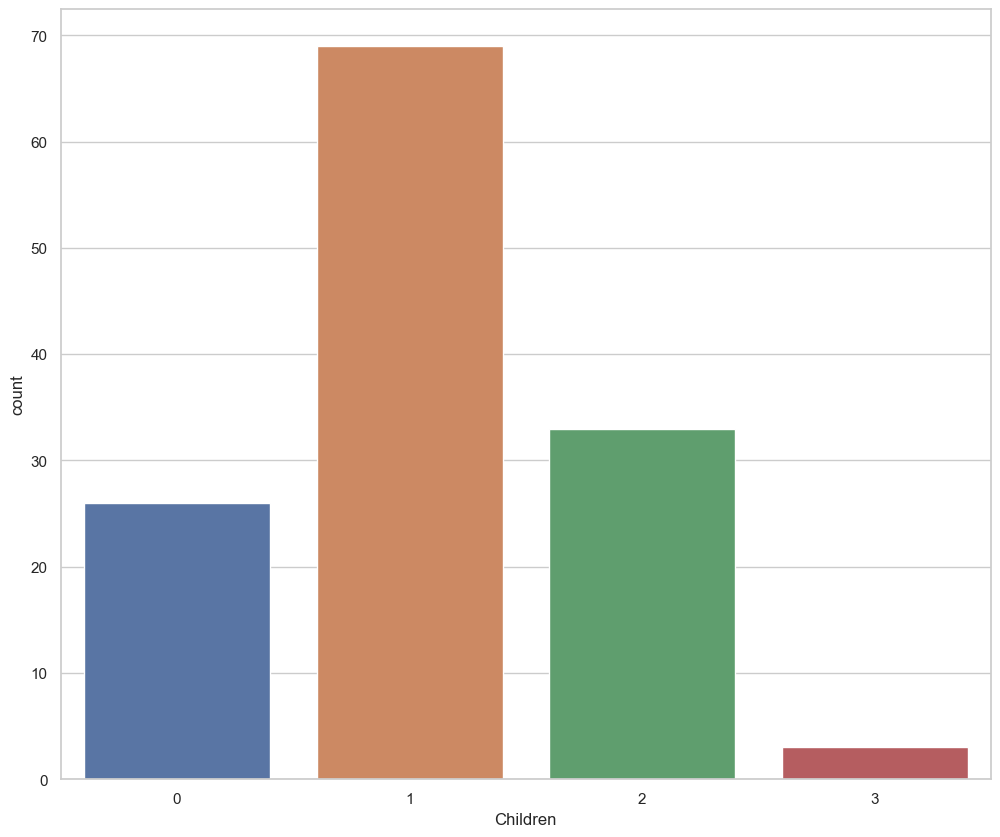

In [126]:
sns.countplot(
    data = df[df["KMeansPCA"] == 7],
    x = "Children"
)
plt.show()

Vemos que la gran mayoría tiene un solo hijo, seguido de dos.

In [124]:
# Resumen estadístico de las variables numéricas de interés
df[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000
mean,52232.510850,305.030741,26.324593,166.970163,37.516275,27.047468,43.822333,4.083183,2.668174,5.800181,0.442586,0.505425,0.009494,2.321429
std,25187.455359,337.611255,39.781794,224.344950,54.558673,41.092454,51.623472,2.741930,2.924378,3.253616,0.537052,0.544258,0.096994,1.923511
min,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,35233.500000,23.750000,1.750000,16.000000,3.000000,1.000000,9.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,51381.500000,173.500000,8.000000,68.000000,12.000000,8.000000,24.000000,4.000000,2.000000,5.000000,0.000000,0.000000,0.000000,2.000000
75%,68522.000000,505.500000,33.000000,232.250000,50.000000,33.000000,56.000000,6.000000,4.000000,8.000000,1.000000,1.000000,0.000000,3.000000
max,666666.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,321.000000,27.000000,28.000000,13.000000,2.000000,2.000000,1.000000,15.000000


In [128]:
df7 = df[df["KMeansPCA"] == 7]
df7[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,131.000000,131.000000,131.000000,131.000000,131.000000,131.000000,131.000000,131.000000,131.000000,131.000000,131.000000,131.000000,131.000000,131.000000
mean,51663.259542,294.587786,16.511450,115.488550,24.137405,17.641221,34.068702,3.916031,2.305344,5.778626,0.488550,0.610687,0.007634,2.618321
std,17727.327644,312.581383,31.997203,172.422887,44.362105,34.355846,41.724037,2.569161,2.404781,3.218433,0.559758,0.576095,0.087370,2.338501
min,7500.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,1.000000
25%,37006.500000,30.000000,1.000000,16.000000,1.000000,0.000000,8.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,50965.000000,173.000000,4.000000,44.000000,6.000000,4.000000,18.000000,3.000000,1.000000,5.000000,0.000000,1.000000,0.000000,2.000000
75%,64586.500000,510.500000,14.000000,129.000000,25.000000,15.000000,43.000000,6.000000,4.000000,8.000000,1.000000,1.000000,0.000000,3.000000
max,90226.000000,1205.000000,194.000000,925.000000,253.000000,179.000000,205.000000,11.000000,11.000000,13.000000,2.000000,2.000000,1.000000,13.000000


Este grupo destaca porque tiene un promedio de consumo en todas las variables menor al promedio general.

### Grupo 8

Vamos a analizar el grupo 8.

In [129]:
df[df["KMeansPCA"] == 8]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,Z_CostContact,Z_Revenue,Response,KMeansPCA,KMeansNoPCA,hcPCA,hcNoPCA,dbscanPCA,dbscanNoPCA,Children
15,2114,1946,PhD,Single,82800.0,0,0,2012-11-24,23,1006,...,3,11,1,8,5,5,4,-1,17,0
53,2225,1977,Graduation,Divorced,82582.0,0,0,2014-06-07,54,510,...,3,11,1,8,5,5,4,-1,-1,0
55,6260,1955,Master,Together,82384.0,0,0,2012-11-19,55,984,...,3,11,1,8,5,1,4,-1,3,0
60,6853,1982,Master,Single,75777.0,0,0,2013-07-04,12,712,...,3,11,1,8,10,5,1,-1,-1,0
113,999,1991,Graduation,Single,86037.0,0,0,2013-01-02,95,490,...,3,11,1,8,5,3,9,-1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2167,3520,1990,Master,Single,91172.0,0,0,2013-03-27,94,162,...,3,11,1,8,5,5,4,-1,-1,0
2168,10394,1984,Graduation,Married,90000.0,0,0,2013-12-23,91,675,...,3,11,0,8,5,5,3,-1,8,0
2171,3968,1970,2n Cycle,Divorced,65706.0,0,0,2013-06-28,77,918,...,3,11,1,8,5,0,4,-1,-1,0
2175,1772,1975,PhD,Married,79174.0,0,0,2013-01-11,2,1074,...,3,11,1,8,5,7,6,-1,2,0


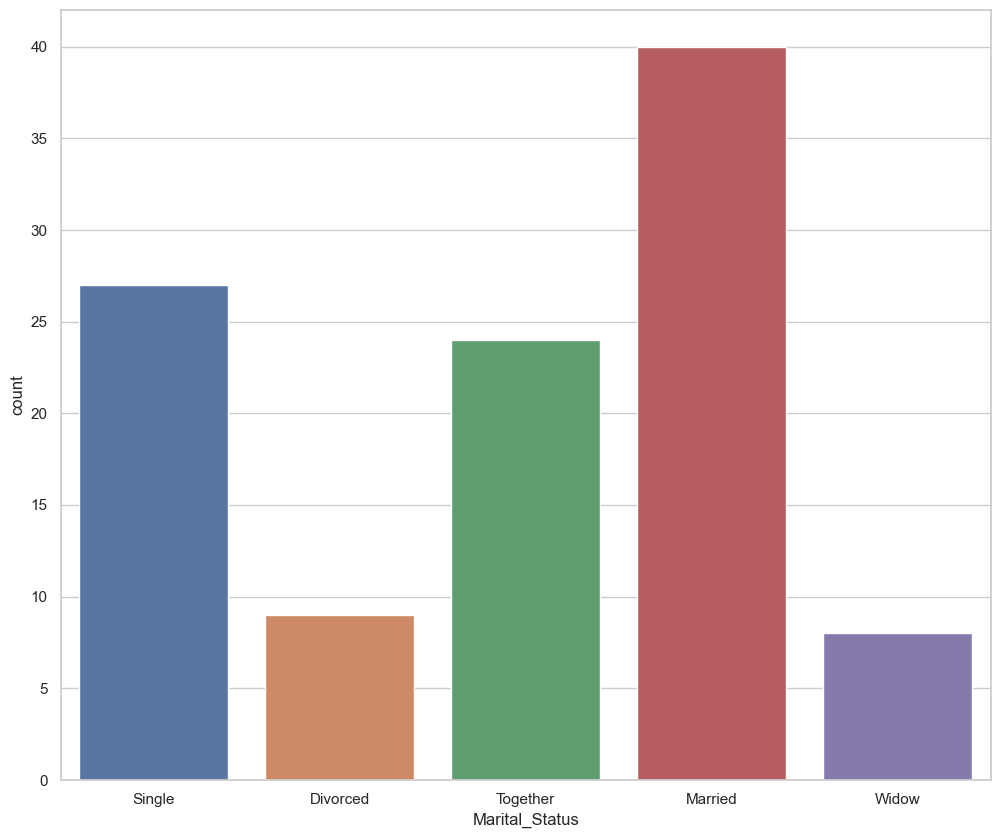

In [130]:
sns.countplot(
    data = df[df["KMeansPCA"] == 8],
    x = "Marital_Status"
)
plt.show()

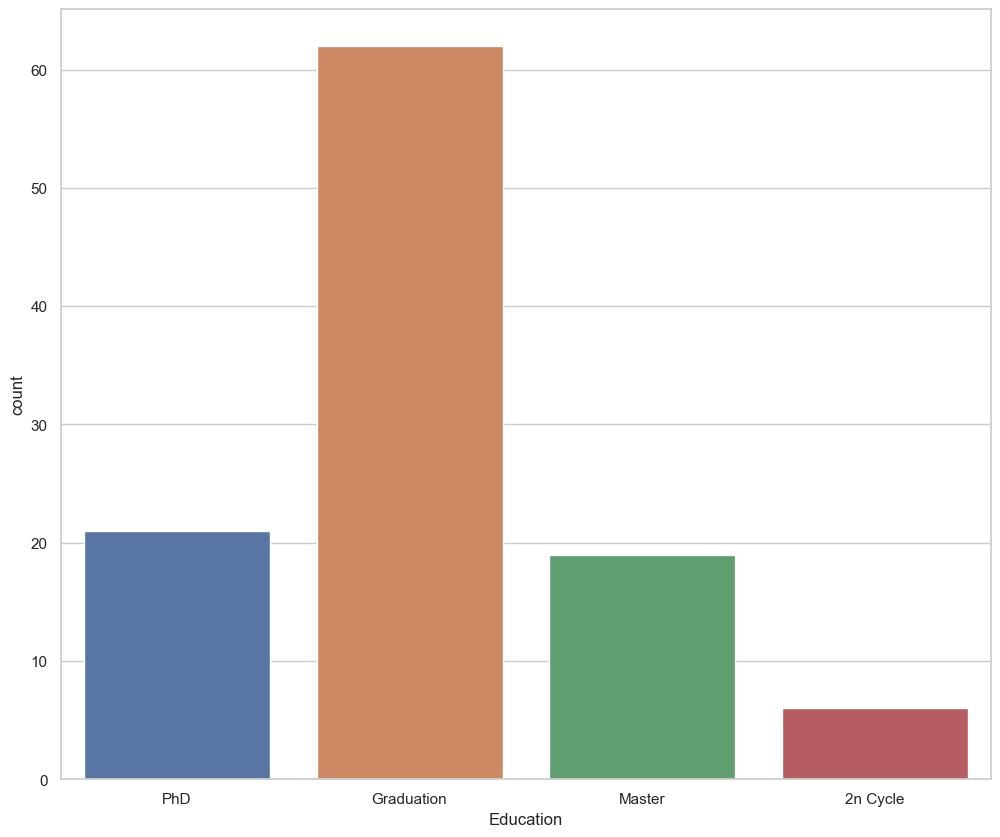

In [131]:
sns.countplot(
    data = df[df["KMeansPCA"] == 8],
    x = "Education"
)
plt.show()

Vemos que este grupo está formado por una gran variedad de personas que tienen un PhD, o una maestría, o están graduados o tienen un título profesional pero la mayoría son graduados; en cuanto al estado civil ocurre lo mismo y es que encontramos todos los niveles de la categoría, pero la mayoría son casados o solteros.

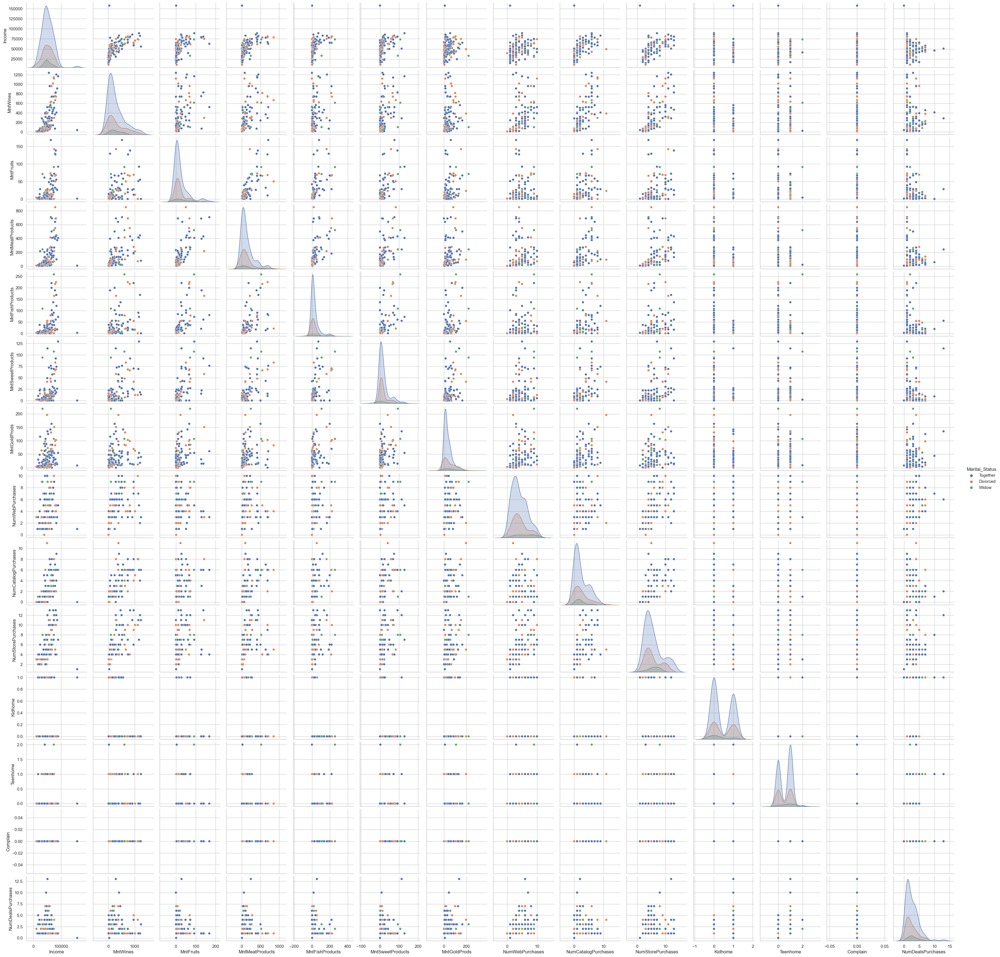

In [ ]:
sns.pairplot(
    data = df[df["KMeansPCA"] == 8],
    hue = "Marital_Status",
    vars = numVars 
)
plt.show()

No parecen haber muchas diferencias en cuanto a la correlación de las variables.

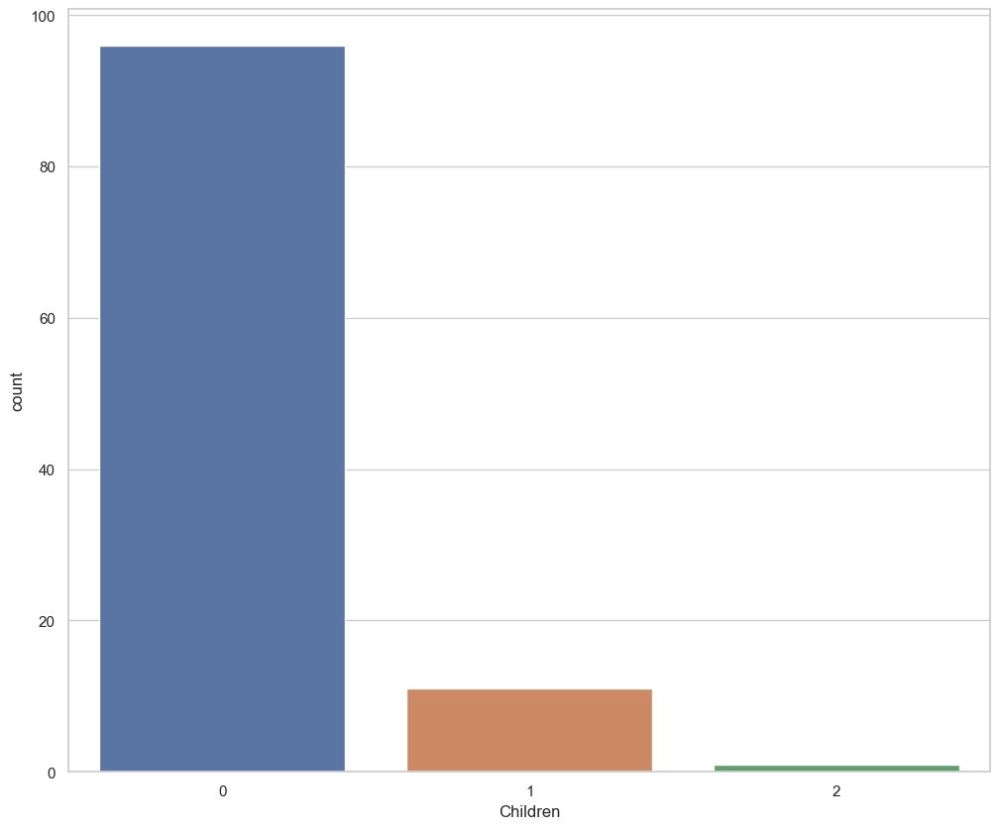

In [132]:
sns.countplot(
    data = df[df["KMeansPCA"] == 8],
    x = "Children"
)
plt.show()

Vemos que la gran mayoría no tiene ningún hijo.

In [ ]:
# Resumen estadístico de las variables numéricas de interés
df[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000
mean,52232.510850,305.030741,26.324593,166.970163,37.516275,27.047468,43.822333,4.083183,2.668174,5.800181,0.442586,0.505425,0.009494,2.321429
std,25187.455359,337.611255,39.781794,224.344950,54.558673,41.092454,51.623472,2.741930,2.924378,3.253616,0.537052,0.544258,0.096994,1.923511
min,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,35233.500000,23.750000,1.750000,16.000000,3.000000,1.000000,9.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,51381.500000,173.500000,8.000000,68.000000,12.000000,8.000000,24.000000,4.000000,2.000000,5.000000,0.000000,0.000000,0.000000,2.000000
75%,68522.000000,505.500000,33.000000,232.250000,50.000000,33.000000,56.000000,6.000000,4.000000,8.000000,1.000000,1.000000,0.000000,3.000000
max,666666.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,321.000000,27.000000,28.000000,13.000000,2.000000,2.000000,1.000000,15.000000


In [133]:
df8 = df[df["KMeansPCA"] == 8]
df8[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,108.000000,108.000000,108.000000,108.000000,108.000000,108.000000,108.000000,108.000000,108.000000,108.000000,108.000000,108.000000,108.000000,108.000000
mean,82849.805556,876.962963,60.972222,489.796296,87.777778,68.259259,82.518519,5.518519,6.481481,8.046296,0.046296,0.074074,0.009259,0.990741
std,9223.791817,339.805385,52.536673,266.578380,65.834305,55.482821,63.154237,2.039248,2.470315,2.739071,0.211106,0.263112,0.096225,0.648440
min,48192.000000,152.000000,0.000000,69.000000,0.000000,0.000000,0.000000,2.000000,2.000000,4.000000,0.000000,0.000000,0.000000,0.000000
25%,77556.000000,693.000000,22.000000,272.750000,38.000000,23.750000,33.000000,4.000000,4.000000,6.000000,0.000000,0.000000,0.000000,1.000000
50%,82692.000000,897.000000,37.500000,500.000000,70.000000,50.500000,60.000000,5.000000,6.000000,8.000000,0.000000,0.000000,0.000000,1.000000
75%,89770.500000,1084.750000,94.250000,731.500000,126.500000,101.500000,126.750000,7.000000,8.000000,10.000000,0.000000,0.000000,0.000000,1.000000
max,105471.000000,1493.000000,185.000000,974.000000,250.000000,194.000000,241.000000,11.000000,11.000000,13.000000,1.000000,1.000000,1.000000,4.000000


Este grupo tiene un promedio de ingresos y de gasto en todos los productos mucho mayor al promedio general.

### Grupo 9

Vamos a analizar el grupo 9.

In [134]:
df[df["KMeansPCA"] == 9]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,Z_CostContact,Z_Revenue,Response,KMeansPCA,KMeansNoPCA,hcPCA,hcNoPCA,dbscanPCA,dbscanNoPCA,Children
8,4855,1974,PhD,Together,30351.0,1,0,2013-06-06,19,14,...,3,11,1,9,7,6,5,-1,5,1
9,5899,1950,PhD,Together,5648.0,1,1,2014-03-13,68,28,...,3,11,0,9,7,10,5,-1,5,2
33,7373,1952,PhD,Divorced,46610.0,0,2,2012-10-29,8,96,...,3,11,1,9,9,0,2,-1,11,2
39,2968,1943,PhD,Divorced,48948.0,0,0,2013-02-01,53,437,...,3,11,1,9,9,0,2,-1,11,0
63,6518,1951,PhD,Widow,67680.0,0,1,2013-06-11,8,546,...,3,11,0,9,9,9,10,20,15,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2128,1631,1965,PhD,Together,65220.0,0,0,2012-09-03,3,890,...,3,11,1,9,7,10,5,-1,5,0
2146,1818,1971,PhD,Together,29732.0,1,0,2014-03-25,23,25,...,3,11,0,9,7,10,5,15,5,1
2148,7873,1973,PhD,Together,63516.0,1,1,2013-07-06,30,141,...,3,11,0,9,7,10,5,15,5,2
2217,9589,1948,PhD,Widow,82032.0,0,0,2014-04-05,54,332,...,3,11,0,9,9,9,10,-1,15,0


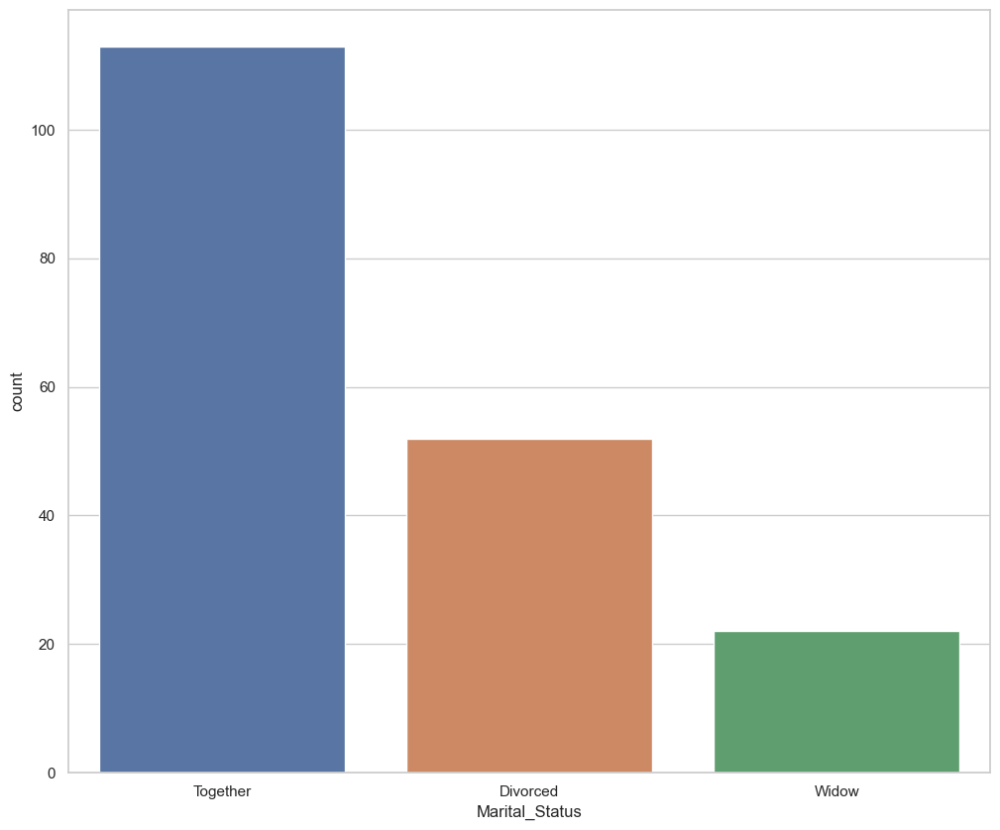

In [135]:
sns.countplot(
    data = df[df["KMeansPCA"] == 9],
    x = "Marital_Status"
)
plt.show()

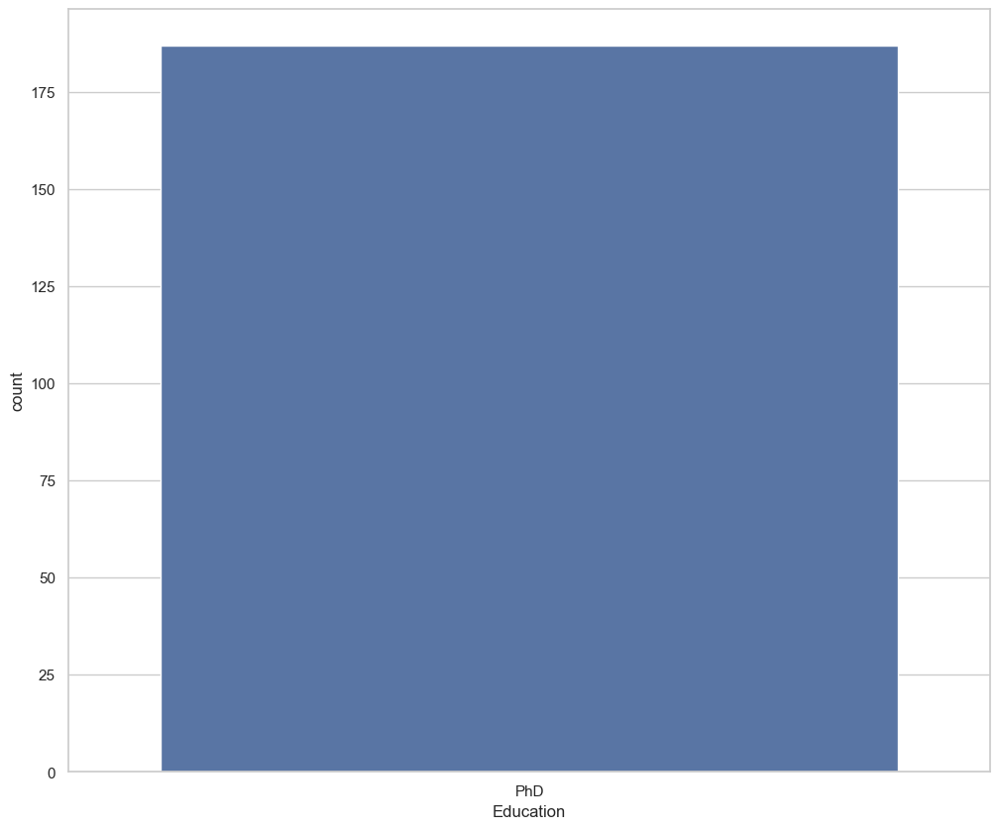

In [136]:
sns.countplot(
    data = df[df["KMeansPCA"] == 9],
    x = "Education"
)
plt.show()

Vemos que este grupo está formado únicamente por personas con PhD en su mayoría con pareja pero hay también divorciados y viudos.

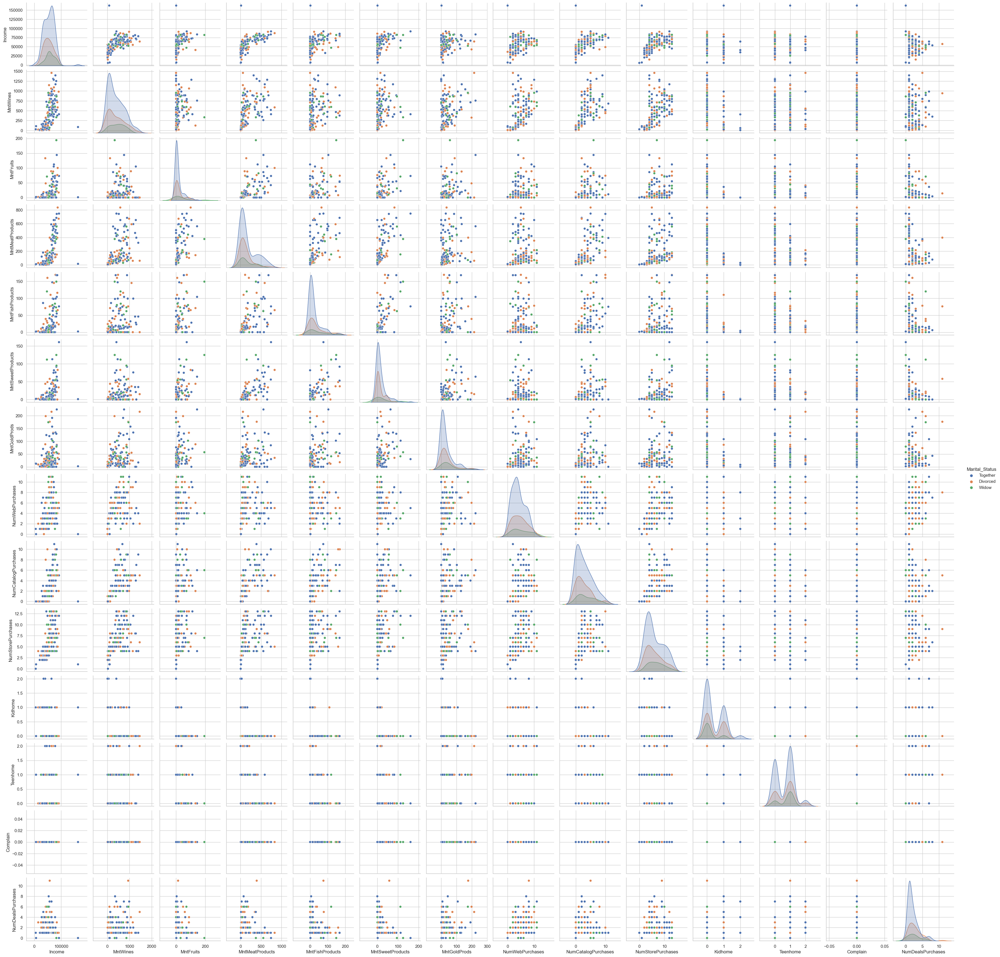

In [145]:
sns.pairplot(
    data = df[df["KMeansPCA"] == 9],
    hue = "Marital_Status",
    vars = numVars 
)
plt.show()

No parecen haber muchas diferencias en cuanto a la correlación de las variables.

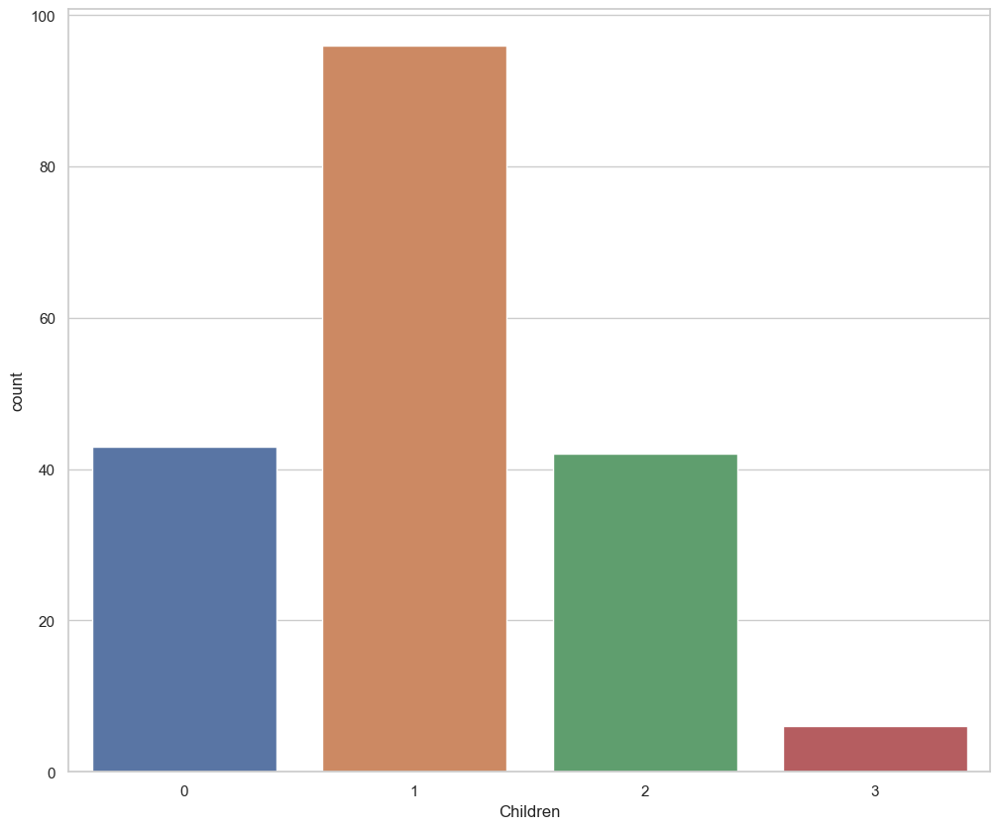

In [137]:
sns.countplot(
    data = df[df["KMeansPCA"] == 9],
    x = "Children"
)
plt.show()

Vemos que la gran mayoría tiene un solo hijo.

In [138]:
# Resumen estadístico de las variables numéricas de interés
df[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000
mean,52232.510850,305.030741,26.324593,166.970163,37.516275,27.047468,43.822333,4.083183,2.668174,5.800181,0.442586,0.505425,0.009494,2.321429
std,25187.455359,337.611255,39.781794,224.344950,54.558673,41.092454,51.623472,2.741930,2.924378,3.253616,0.537052,0.544258,0.096994,1.923511
min,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,35233.500000,23.750000,1.750000,16.000000,3.000000,1.000000,9.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,51381.500000,173.500000,8.000000,68.000000,12.000000,8.000000,24.000000,4.000000,2.000000,5.000000,0.000000,0.000000,0.000000,2.000000
75%,68522.000000,505.500000,33.000000,232.250000,50.000000,33.000000,56.000000,6.000000,4.000000,8.000000,1.000000,1.000000,0.000000,3.000000
max,666666.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,321.000000,27.000000,28.000000,13.000000,2.000000,2.000000,1.000000,15.000000


In [139]:
df9 = df[df["KMeansPCA"] == 9]
df9[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,187.000000,187.000000,187.000000,187.000000,187.000000,187.000000,187.000000,187.000000,187.000000,187.000000,187.000000,187.000000,187.0,187.000000
mean,55065.048128,395.695187,19.561497,158.978610,27.508021,16.802139,34.983957,4.363636,2.887701,6.074866,0.385027,0.673797,0.0,2.315508
std,19595.921986,360.924721,34.243125,195.636292,41.787014,27.754461,45.901423,2.719180,2.750016,3.367262,0.530156,0.573152,0.0,1.766451
min,5648.000000,4.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
25%,39550.000000,52.000000,0.000000,16.500000,0.000000,0.000000,6.000000,2.000000,1.000000,3.000000,0.000000,0.000000,0.0,1.000000
50%,55012.000000,345.000000,4.000000,69.000000,10.000000,3.000000,15.000000,4.000000,2.000000,5.000000,0.000000,1.000000,0.0,2.000000
75%,68014.000000,632.000000,19.000000,211.000000,34.500000,20.500000,44.000000,6.000000,5.000000,8.500000,1.000000,1.000000,0.0,3.000000
max,162397.000000,1459.000000,194.000000,835.000000,169.000000,161.000000,224.000000,11.000000,11.000000,13.000000,2.000000,2.000000,0.0,11.000000


Este grupo tiene un promedio de gasto en vinos muy por encima del conjunto de datos general pero tiene un promedio menor de gasto en el resto de productos y ninguno ha tenido quejas.

### Grupo 10

Vamos a analizar el grupo 10.

In [140]:
df[df["KMeansPCA"] == 10]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,Z_CostContact,Z_Revenue,Response,KMeansPCA,KMeansNoPCA,hcPCA,hcNoPCA,dbscanPCA,dbscanNoPCA,Children
0,5524,1957,Graduation,Single,58138.0,0,0,2012-09-04,58,635,...,3,11,1,10,1,3,9,0,0,0
1,2174,1954,Graduation,Single,46344.0,1,1,2014-03-08,38,11,...,3,11,0,10,1,3,9,1,0,2
25,7892,1969,Graduation,Single,18589.0,0,0,2013-01-02,89,6,...,3,11,0,10,1,3,9,1,0,0
45,1371,1976,Graduation,Single,79941.0,0,0,2014-06-28,72,123,...,3,11,0,10,1,3,9,1,0,0
52,1331,1977,Graduation,Single,35790.0,1,0,2013-01-02,54,12,...,3,11,0,10,1,3,9,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2201,10968,1969,Graduation,Single,57731.0,0,1,2012-11-23,0,266,...,3,11,0,10,1,3,9,1,0,1
2205,5959,1968,Graduation,Single,35893.0,1,1,2012-10-15,80,158,...,3,11,0,10,1,3,9,1,0,2
2227,4201,1962,Graduation,Single,57967.0,0,1,2013-03-03,39,229,...,3,11,0,10,1,3,9,1,0,1
2230,7004,1984,Graduation,Single,11012.0,1,0,2013-03-16,82,24,...,3,11,0,10,1,3,9,-1,0,1


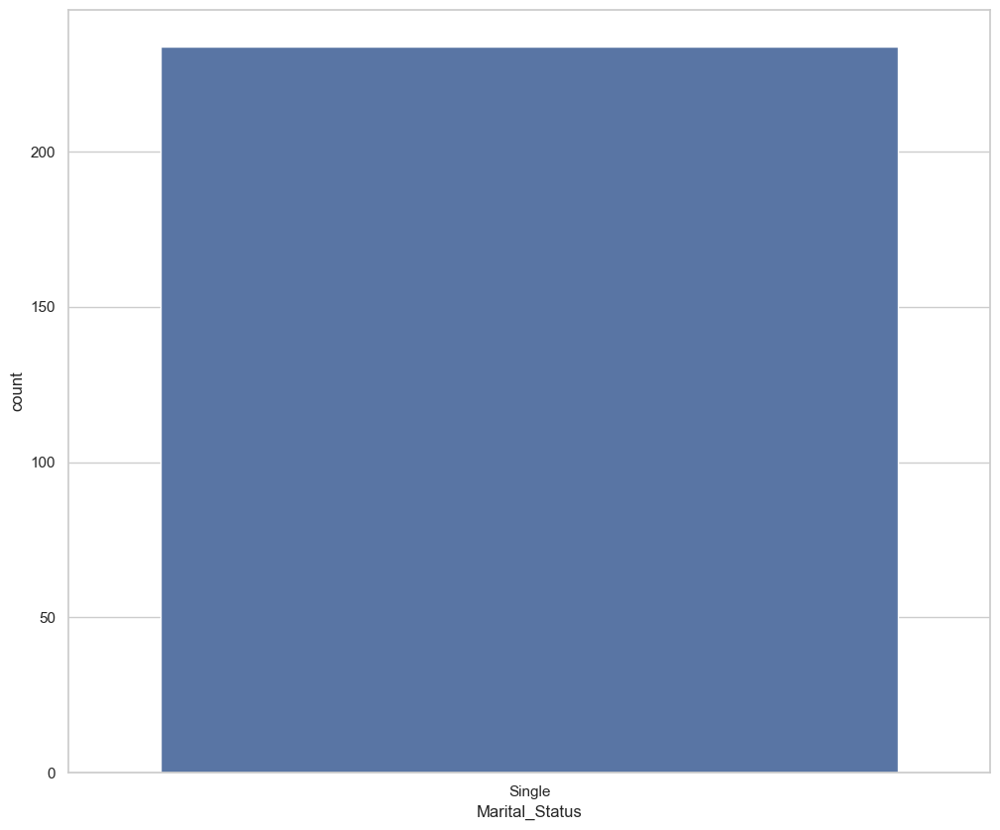

In [141]:
sns.countplot(
    data = df[df["KMeansPCA"] == 10],
    x = "Marital_Status"
)
plt.show()

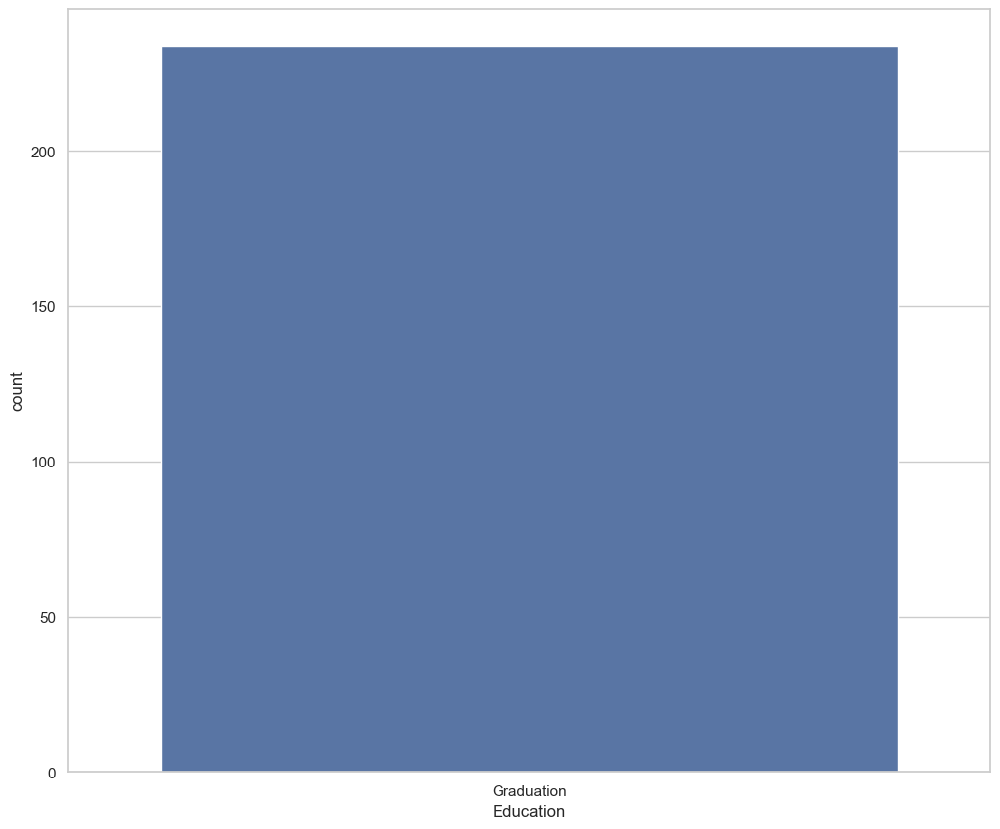

In [142]:
sns.countplot(
    data = df[df["KMeansPCA"] == 10],
    x = "Education"
)
plt.show()

Vemos que este grupo está formado únicamente por personas graduadas y solteras.

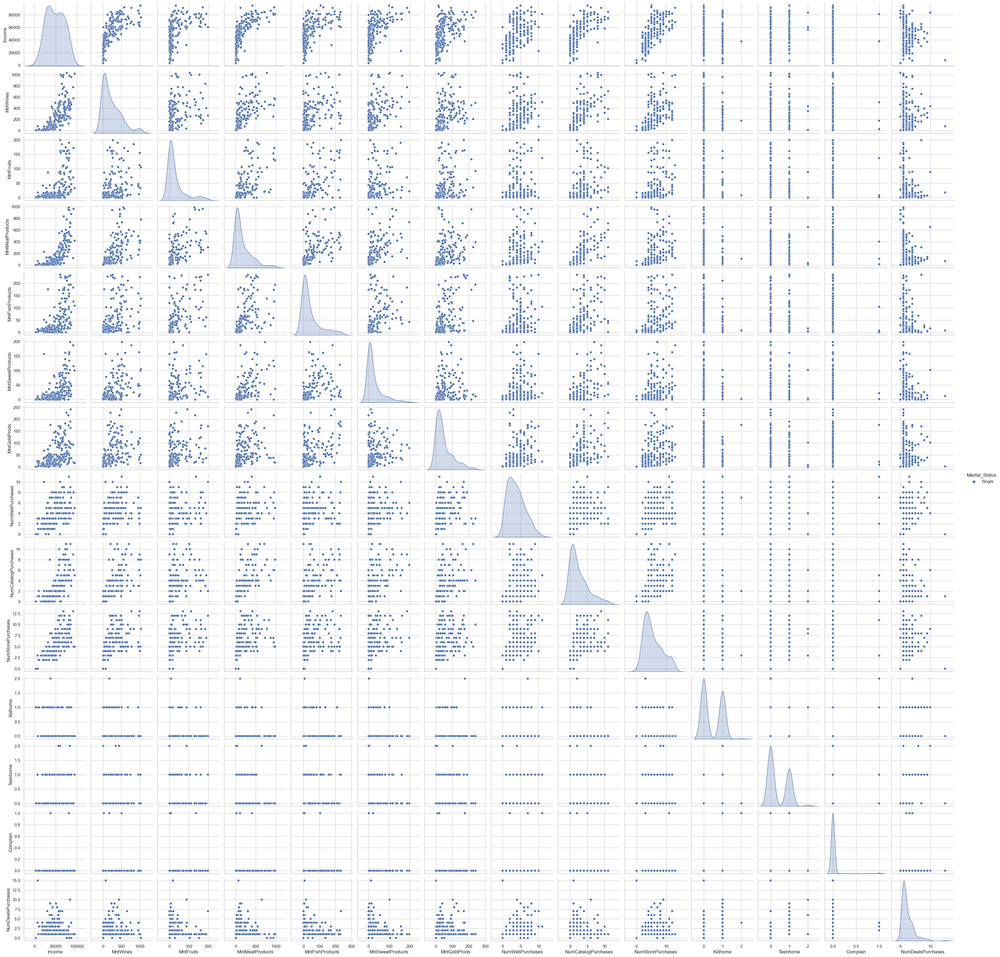

In [146]:
sns.pairplot(
    data = df[df["KMeansPCA"] == 10],
    hue = "Marital_Status",
    vars = numVars 
)
plt.show()

No parecen haber muchas diferencias en cuanto a la correlación de las variables.

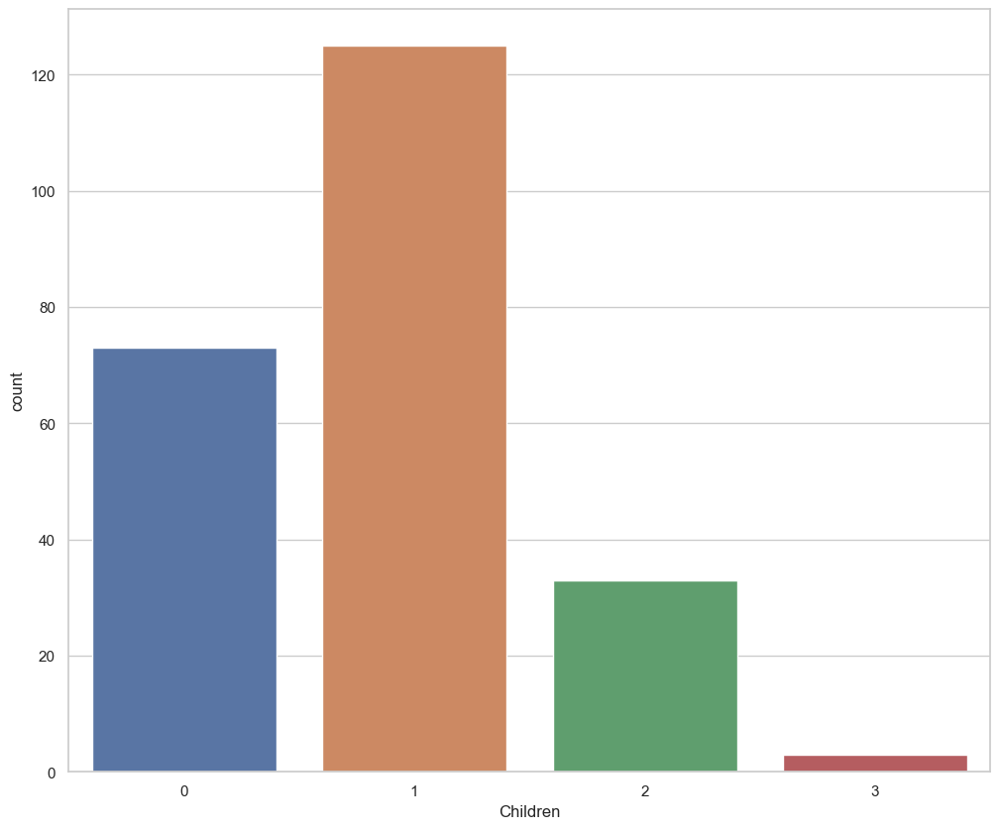

In [143]:
sns.countplot(
    data = df[df["KMeansPCA"] == 10],
    x = "Children"
)
plt.show()

Vemos que la gran mayoría tiene un solo hijo.

In [ ]:
# Resumen estadístico de las variables numéricas de interés
df[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000
mean,52232.510850,305.030741,26.324593,166.970163,37.516275,27.047468,43.822333,4.083183,2.668174,5.800181,0.442586,0.505425,0.009494,2.321429
std,25187.455359,337.611255,39.781794,224.344950,54.558673,41.092454,51.623472,2.741930,2.924378,3.253616,0.537052,0.544258,0.096994,1.923511
min,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,35233.500000,23.750000,1.750000,16.000000,3.000000,1.000000,9.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,51381.500000,173.500000,8.000000,68.000000,12.000000,8.000000,24.000000,4.000000,2.000000,5.000000,0.000000,0.000000,0.000000,2.000000
75%,68522.000000,505.500000,33.000000,232.250000,50.000000,33.000000,56.000000,6.000000,4.000000,8.000000,1.000000,1.000000,0.000000,3.000000
max,666666.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,321.000000,27.000000,28.000000,13.000000,2.000000,2.000000,1.000000,15.000000


In [144]:
df10 = df[df["KMeansPCA"] == 10]
df10[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,234.000000,234.000000,234.000000,234.000000,234.000000,234.000000,234.000000,234.000000,234.000000,234.000000,234.000000,234.000000,234.000000,234.000000
mean,49245.081197,232.264957,31.166667,172.217949,43.235043,26.876068,49.145299,3.786325,2.547009,5.525641,0.448718,0.405983,0.012821,2.329060
std,20874.018800,253.416192,46.548904,216.602560,59.956568,38.627605,51.487615,2.357816,2.697943,3.049200,0.506967,0.517636,0.112741,2.003926
min,3502.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,31988.500000,18.250000,4.000000,21.000000,4.000000,2.000000,11.000000,2.000000,1.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,48242.000000,158.000000,9.000000,82.000000,15.000000,12.000000,31.500000,3.000000,2.000000,5.000000,0.000000,0.000000,0.000000,2.000000
75%,66549.500000,379.500000,40.000000,262.250000,59.500000,35.750000,73.500000,5.000000,4.000000,8.000000,1.000000,1.000000,0.000000,3.000000
max,94472.000000,1032.000000,199.000000,984.000000,234.000000,198.000000,241.000000,11.000000,11.000000,13.000000,2.000000,2.000000,1.000000,15.000000


Este grupo tiene un promedio de ingresos menor al general, gasta en promedio menos en vino pero tiene un mayor promedio de gasto en frutas, carnes, pescados y oro.

### Grupo 11

Vamos a analizar el grupo 11.

In [147]:
df[df["KMeansPCA"] == 11]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,Z_CostContact,Z_Revenue,Response,KMeansPCA,KMeansNoPCA,hcPCA,hcNoPCA,dbscanPCA,dbscanNoPCA,Children
11,387,1976,Basic,Married,7500.0,0,0,2012-11-13,59,6,...,3,11,0,11,0,11,0,6,6,0
37,10755,1976,2n Cycle,Married,23718.0,1,0,2013-09-02,76,6,...,3,11,0,11,0,8,0,6,13,1
46,9909,1996,2n Cycle,Married,7500.0,0,0,2012-11-09,24,3,...,3,11,1,11,0,8,0,-1,13,0
82,5346,1973,2n Cycle,Married,23559.0,1,0,2013-07-03,87,25,...,3,11,0,11,0,8,0,6,13,1
98,4646,1951,2n Cycle,Married,78497.0,0,0,2013-12-01,44,207,...,3,11,0,11,0,8,0,-1,13,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2133,642,1980,Basic,Married,16005.0,1,0,2012-08-14,69,1,...,3,11,0,11,0,11,0,6,6,1
2155,8933,1983,2n Cycle,Married,32146.0,1,0,2014-05-12,16,26,...,3,11,0,11,0,8,0,6,13,1
2184,8207,1957,2n Cycle,Married,53233.0,0,1,2014-03-18,18,28,...,3,11,0,11,0,8,0,6,13,1
2189,1646,1972,Basic,Married,25224.0,1,0,2014-03-16,36,4,...,3,11,0,11,0,11,0,6,6,1


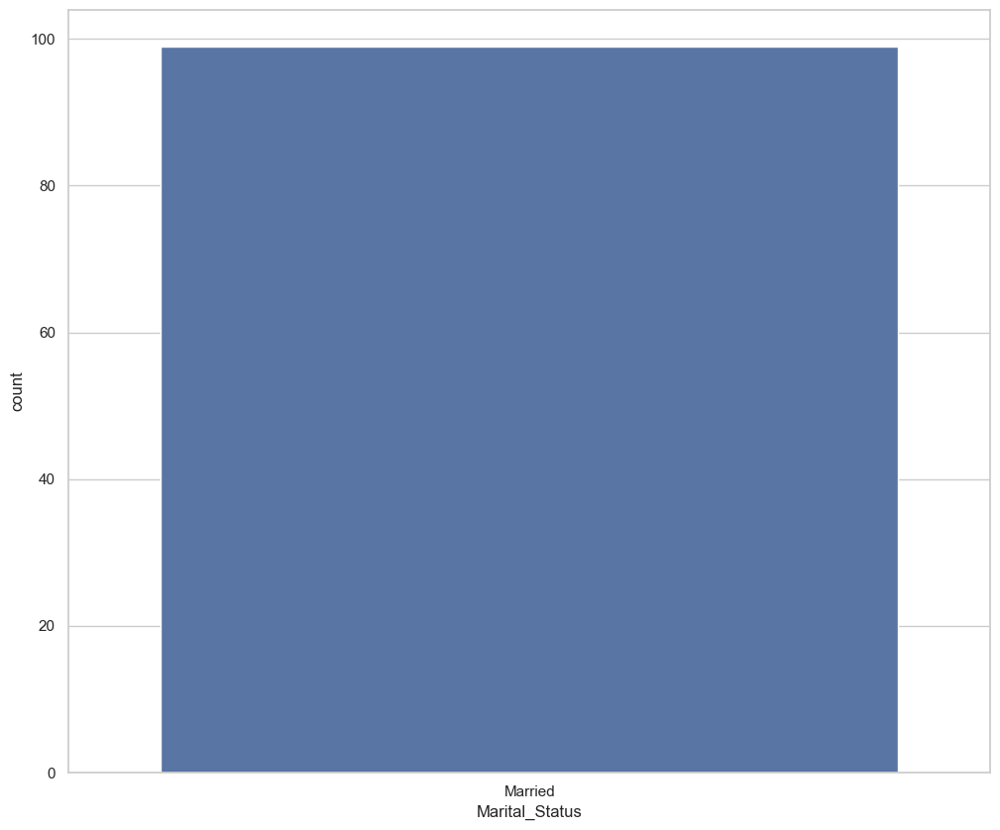

In [148]:
sns.countplot(
    data = df[df["KMeansPCA"] == 11],
    x = "Marital_Status"
)
plt.show()

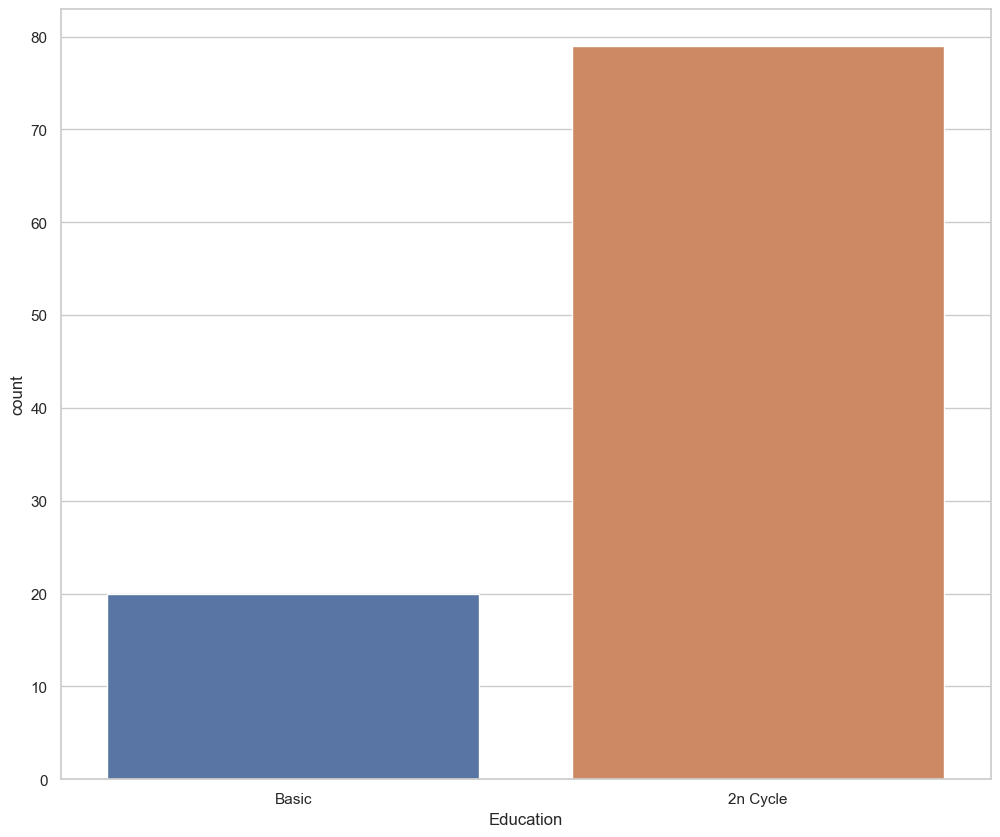

In [149]:
sns.countplot(
    data = df[df["KMeansPCA"] == 11],
    x = "Education"
)
plt.show()

Vemos que este grupo está formado únicamente por personas con educación básica.

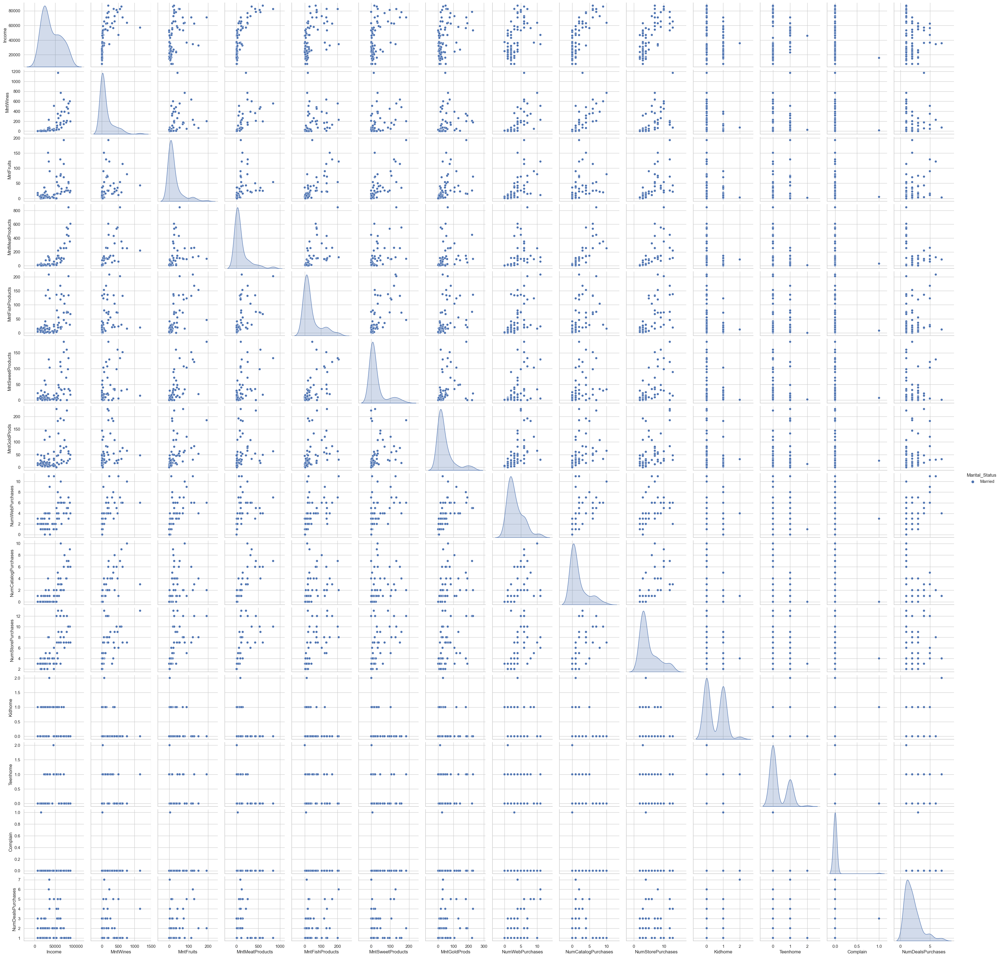

In [152]:
sns.pairplot(
    data = df[df["KMeansPCA"] == 11],
    hue = "Marital_Status",
    vars = numVars 
)
plt.show()

No parecen haber muchas diferencias en cuanto a la correlación de las variables.

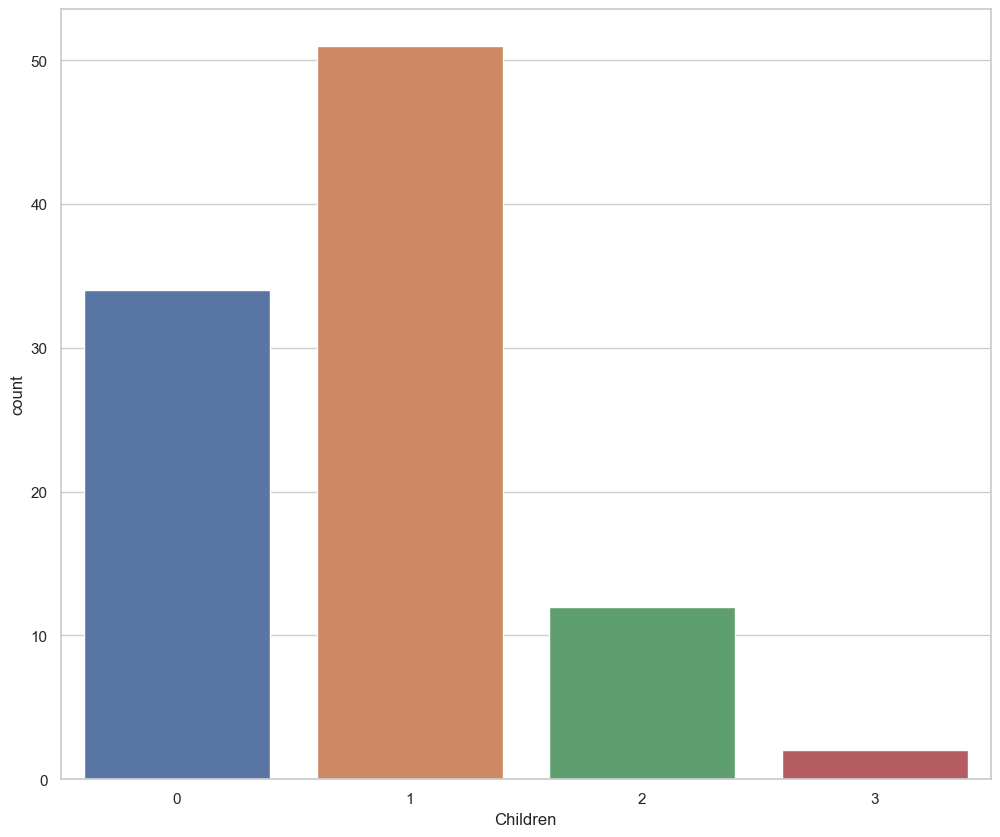

In [150]:
sns.countplot(
    data = df[df["KMeansPCA"] == 11],
    x = "Children"
)
plt.show()

Vemos que la gran mayoría tiene un solo hijo o ninguno.

In [ ]:
# Resumen estadístico de las variables numéricas de interés
df[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000
mean,52232.510850,305.030741,26.324593,166.970163,37.516275,27.047468,43.822333,4.083183,2.668174,5.800181,0.442586,0.505425,0.009494,2.321429
std,25187.455359,337.611255,39.781794,224.344950,54.558673,41.092454,51.623472,2.741930,2.924378,3.253616,0.537052,0.544258,0.096994,1.923511
min,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,35233.500000,23.750000,1.750000,16.000000,3.000000,1.000000,9.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,51381.500000,173.500000,8.000000,68.000000,12.000000,8.000000,24.000000,4.000000,2.000000,5.000000,0.000000,0.000000,0.000000,2.000000
75%,68522.000000,505.500000,33.000000,232.250000,50.000000,33.000000,56.000000,6.000000,4.000000,8.000000,1.000000,1.000000,0.000000,3.000000
max,666666.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,321.000000,27.000000,28.000000,13.000000,2.000000,2.000000,1.000000,15.000000


In [151]:
df11 = df[df["KMeansPCA"] == 11]
df11[numVars].describe()

,Income,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,Kidhome,Teenhome,Complain,NumDealsPurchases
count,99.000000,99.000000,99.000000,99.000000,99.000000,99.000000,99.000000,99.000000,99.000000,99.000000,99.000000,99.000000,99.000000,99.000000
mean,40795.464646,124.929293,25.353535,102.090909,38.989899,27.313131,43.606061,3.282828,1.747475,4.989899,0.494949,0.323232,0.010101,2.070707
std,22219.051884,209.322486,36.777687,172.822493,52.840827,43.117932,54.069271,2.390630,2.463378,3.015250,0.541610,0.491318,0.100504,1.357162
min,7500.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,1.000000
25%,23246.500000,5.000000,4.000000,9.000000,6.000000,4.000000,11.000000,2.000000,0.000000,3.000000,0.000000,0.000000,0.000000,1.000000
50%,35523.000000,16.000000,11.000000,19.000000,15.000000,8.000000,18.000000,2.000000,1.000000,3.000000,0.000000,0.000000,0.000000,2.000000
75%,58498.500000,169.500000,26.000000,107.500000,43.500000,27.500000,53.500000,4.000000,2.000000,7.000000,1.000000,1.000000,0.000000,3.000000
max,87000.000000,1171.000000,193.000000,845.000000,208.000000,185.000000,229.000000,11.000000,10.000000,13.000000,2.000000,2.000000,1.000000,7.000000


Este grupo un promedio de ingresos mucho menor al general al igual que el promedio de sus gastos en vinos y carnes; en el resto de productos tienen un promedio de gasto cercano al general.

## Conclusiones

Obtuvimos 12 grupos de clientes agrupados por distintas características; con esta información se podrán crear políticas, campañas y productos focalizadas en cada segmento de clientes: por ejemplo los clientes que pertenecen a los grupos 8 y 9 tienen un mayor gasto en vinos por lo que sería más fácil que adquirieran estos productos.